<a href="https://colab.research.google.com/github/LucasHyun/GYAN.AI/blob/main/gnn_explainer_implementation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install torch torch-geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 4.9 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manyl

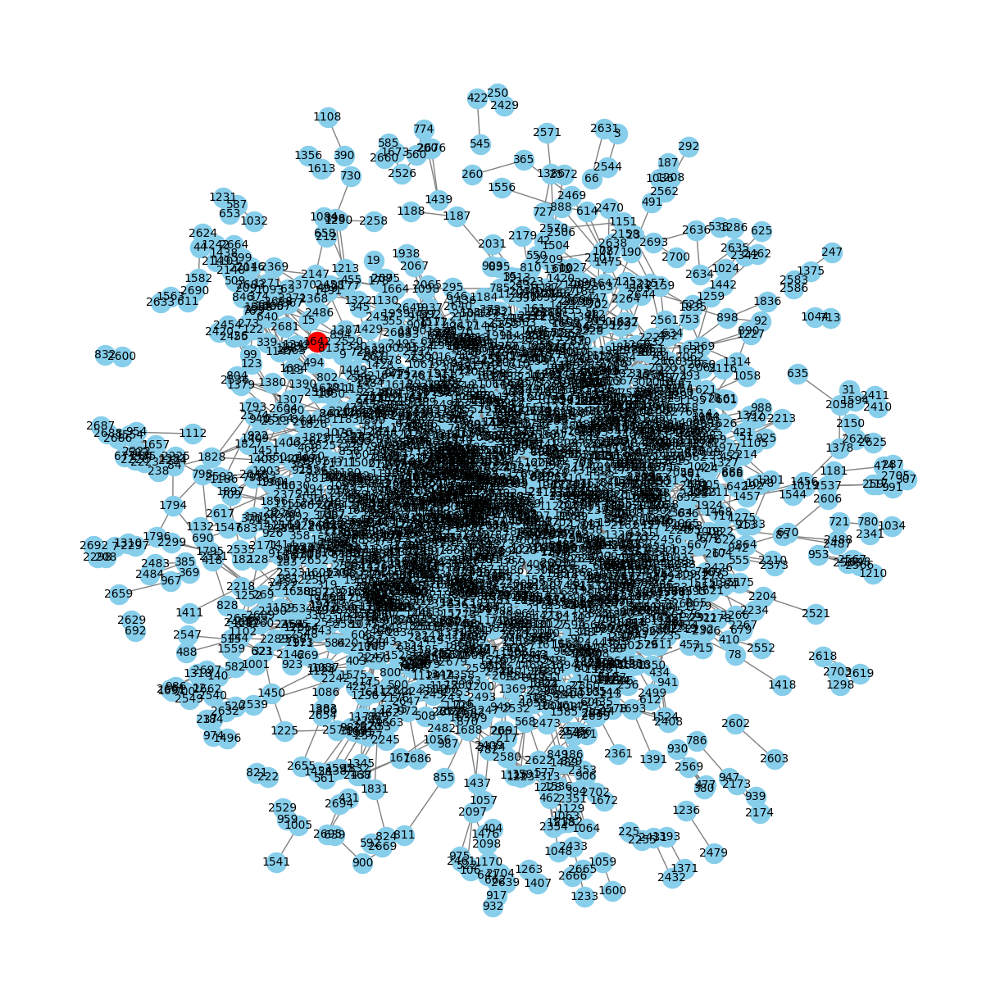

In [14]:
import torch
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.datasets import Planetoid
import networkx as nx
import matplotlib.pyplot as plt

# GCN 모델 정의
class GCN(torch.nn.Module):
    def __init__(self, num_features, num_classes):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(num_features, 16)
        self.conv2 = GCNConv(16, num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = F.relu(self.conv1(x, edge_index))
        x = F.dropout(x, training=self.training)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)

class GNNExplainer(torch.nn.Module):
    def __init__(self, model, epochs=100, lr=0.01):
        super(GNNExplainer, self).__init__()
        self.model = model
        self.epochs = epochs
        self.lr = lr

    def explain_node(self, node_idx, data):
        self.model.eval()
        device = data.x.device
        node_feat_mask = torch.nn.Parameter(torch.ones(data.x.size(1), device=device))
        edge_mask = torch.nn.Parameter(torch.ones(data.edge_index.size(1), device=device))

        optimizer = torch.optim.Adam([node_feat_mask, edge_mask], lr=self.lr)

        for epoch in range(self.epochs):
            optimizer.zero_grad()
            h = data.x * node_feat_mask.sigmoid()
            out = self.model(data)
            loss = -out[node_idx, data.y[node_idx]]
            loss.backward()
            optimizer.step()

        node_feat_mask = node_feat_mask.sigmoid().detach()
        edge_mask = edge_mask.sigmoid().detach()
        return node_feat_mask, edge_mask

    def visualize_subgraph(self, node_idx, data, edge_mask, threshold=0.1):
        import networkx as nx
        import matplotlib.pyplot as plt
        import numpy as np

        edge_index = data.edge_index.cpu().numpy()
        edge_mask = edge_mask.cpu().numpy()

        G = nx.Graph()
        for i, (u, v) in enumerate(edge_index.T):
            if edge_mask[i] > threshold:  # Threshold for visualization
                G.add_edge(u, v, weight=edge_mask[i])

        pos = nx.spring_layout(G, k=0.05, iterations=50)  # Increase k to increase the distance between nodes

        plt.figure(figsize=(12, 12))
        nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=300, edge_color='gray', font_size=10)
        nx.draw_networkx_nodes(G, pos, nodelist=[node_idx], node_color='red', node_size=300)
        plt.show()

# 데이터셋 로드 (Cora 사용)
dataset = Planetoid(root='/tmp/Cora', name='Cora')
data = dataset[0]

# 모델 및 데이터 GPU 설정
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = GCN(dataset.num_node_features, dataset.num_classes).to(device)
data = data.to(device)

# 모델 학습
optimizer = torch.optim.Adam(model.parameters(), lr=0.01, weight_decay=5e-4)

model.train()
for epoch in range(200):
    optimizer.zero_grad()
    out = model(data)
    loss = F.nll_loss(out[data.train_mask], data.y[data.train_mask])
    loss.backward()
    optimizer.step()

# GNN Explainer 사용
explainer = GNNExplainer(model)
node_idx = 1642  # 설명하고자 하는 노드 인덱스
node_feat_mask, edge_mask = explainer.explain_node(node_idx, data)
explainer.visualize_subgraph(node_idx, data, edge_mask, threshold=0.7)

In [34]:
import torch
import torch.nn.functional as F

from torch_geometric.datasets import Planetoid
from torch_geometric.explain import Explainer, GNNExplainer
from torch_geometric.nn import GCNConv

# 데이터셋 로드
dataset = 'Cora'
dataset = Planetoid(root='/content/data/Planetoid', name=dataset)
data = dataset[0]

class GCN(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = GCNConv(dataset.num_features, 16)
        self.conv2 = GCNConv(16, dataset.num_classes)

    def forward(self, x, edge_index):
        x = F.relu(self.conv1(x, edge_index))
        x = F.dropout(x, training=self.training)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)

# 모델, 데이터, 옵티마이저 설정
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = GCN().to(device)
data = data.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01, weight_decay=5e-4)

# 모델 학습
for epoch in range(1, 201):
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = F.nll_loss(out[data.train_mask], data.y[data.train_mask])
    loss.backward()
    optimizer.step()

# Explainer 설정 및 설명 생성
explainer = Explainer(
    model=model,
    algorithm=GNNExplainer(epochs=200),
    explanation_type='model',
    node_mask_type='attributes',
    edge_mask_type='object',
    model_config=dict(
        mode='multiclass_classification',
        task_level='node',
        return_type='log_probs',
    ),
)
node_index = 10
explanation = explainer(data.x, data.edge_index, index=node_index)
print(f'Generated explanations in {explanation.available_explanations}')

# 시각화 및 결과 저장
path_feature_importance = 'feature_importance.png'
explanation.visualize_feature_importance(path_feature_importance, top_k=10)
print(f"Feature importance plot has been saved to '{path_feature_importance}'")

path_subgraph = 'subgraph.pdf'
explanation.visualize_graph(path_subgraph)
print(f"Subgraph visualization plot has been saved to '{path_subgraph}'")

Generated explanations in ['node_mask', 'edge_mask']
Feature importance plot has been saved to 'feature_importance.png'
Subgraph visualization plot has been saved to 'subgraph.pdf'


In [28]:
import torch
import torch.nn.functional as F
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split
from tqdm import tqdm

import torch_geometric.transforms as T
from torch_geometric.datasets import ExplainerDataset
from torch_geometric.datasets.graph_generator import BAGraph
from torch_geometric.explain import Explainer, GNNExplainer
from torch_geometric.nn import GCN
from torch_geometric.utils import k_hop_subgraph

dataset = ExplainerDataset(
    graph_generator=BAGraph(num_nodes=300, num_edges=5),
    motif_generator='house',
    num_motifs=80,
    transform=T.Constant(),
)
data = dataset[0]

idx = torch.arange(data.num_nodes)
train_idx, test_idx = train_test_split(idx, train_size=0.8, stratify=data.y)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
data = data.to(device)
model = GCN(data.num_node_features, hidden_channels=20, num_layers=3,
            out_channels=dataset.num_classes).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001, weight_decay=0.005)


def train():
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = F.cross_entropy(out[train_idx], data.y[train_idx])
    torch.nn.utils.clip_grad_norm_(model.parameters(), 2.0)
    loss.backward()
    optimizer.step()
    return float(loss)


@torch.no_grad()
def test():
    model.eval()
    pred = model(data.x, data.edge_index).argmax(dim=-1)

    train_correct = int((pred[train_idx] == data.y[train_idx]).sum())
    train_acc = train_correct / train_idx.size(0)

    test_correct = int((pred[test_idx] == data.y[test_idx]).sum())
    test_acc = test_correct / test_idx.size(0)

    return train_acc, test_acc


pbar = tqdm(range(1, 2001))
for epoch in pbar:
    loss = train()
    if epoch == 1 or epoch % 200 == 0:
        train_acc, test_acc = test()
        pbar.set_description(f'Loss: {loss:.4f}, Train: {train_acc:.4f}, '
                             f'Test: {test_acc:.4f}')
pbar.close()
model.eval()

for explanation_type in ['phenomenon', 'model']:
    explainer = Explainer(
        model=model,
        algorithm=GNNExplainer(epochs=300),
        explanation_type=explanation_type,
        node_mask_type='attributes',
        edge_mask_type='object',
        model_config=dict(
            mode='multiclass_classification',
            task_level='node',
            return_type='raw',
        ),
    )

    # Explanation ROC AUC over all test nodes:
    targets, preds = [], []
    node_indices = range(400, data.num_nodes, 5)
    for node_index in tqdm(node_indices, leave=False, desc='Train Explainer'):
        target = data.y if explanation_type == 'phenomenon' else None
        explanation = explainer(data.x, data.edge_index, index=node_index,
                                target=target)

        _, _, _, hard_edge_mask = k_hop_subgraph(node_index, num_hops=3,
                                                 edge_index=data.edge_index)

        targets.append(data.edge_mask[hard_edge_mask].cpu())
        preds.append(explanation.edge_mask[hard_edge_mask].cpu())

    auc = roc_auc_score(torch.cat(targets), torch.cat(preds))
    print(f'Mean ROC AUC (explanation type {explanation_type:10}): {auc:.4f}')

Loss: 0.8758, Train: 0.8446, Test: 0.8214: 100%|██████████| 2000/2000 [00:10<00:00, 185.73it/s]


Mean ROC AUC (explanation type phenomenon): 0.9886


Mean ROC AUC (explanation type model     ): 0.9847


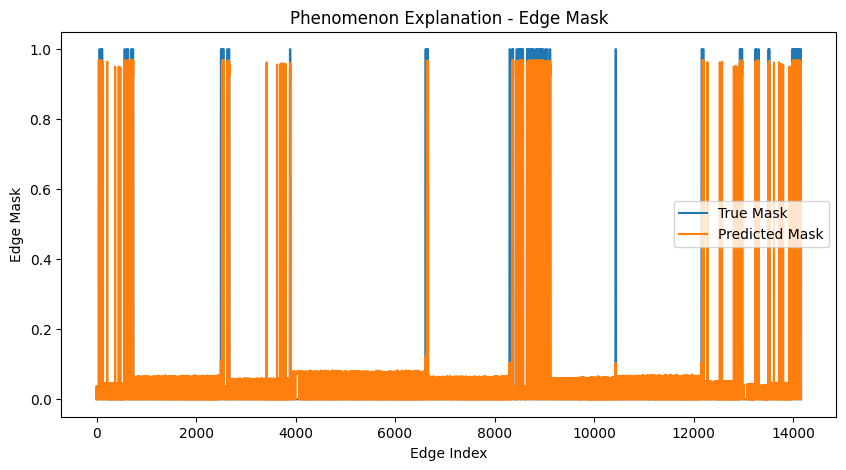

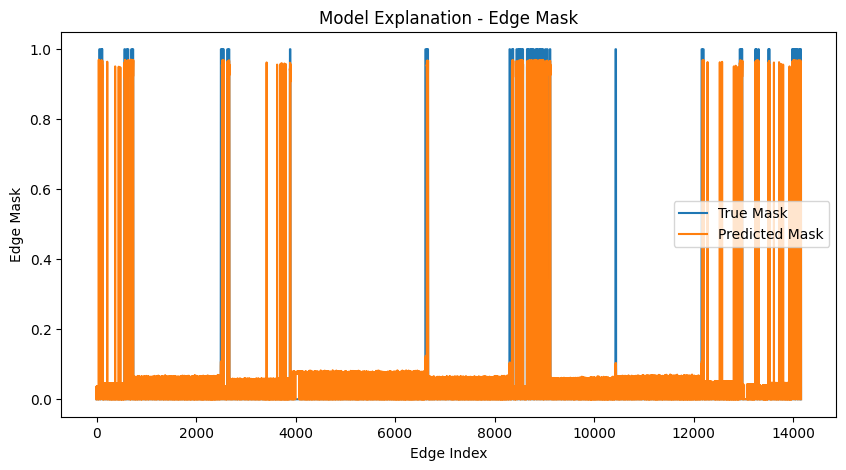

In [35]:
import matplotlib.pyplot as plt

# Phenomenon Explanation Visualization
plt.figure(figsize=(10, 5))
plt.plot(torch.cat(targets).numpy(), label='True Mask')
plt.plot(torch.cat(preds).numpy(), label='Predicted Mask')
plt.xlabel('Edge Index')
plt.ylabel('Edge Mask')
plt.title('Phenomenon Explanation - Edge Mask')
plt.legend()
plt.show()

# Model Explanation Visualization
plt.figure(figsize=(10, 5))
plt.plot(torch.cat(targets).numpy(), label='True Mask')
plt.plot(torch.cat(preds).numpy(), label='Predicted Mask')
plt.xlabel('Edge Index')
plt.ylabel('Edge Mask')
plt.title('Model Explanation - Edge Mask')
plt.legend()
plt.show()


Train Explainer:   0%|          | 0/60 [00:00<?, ?it/s]

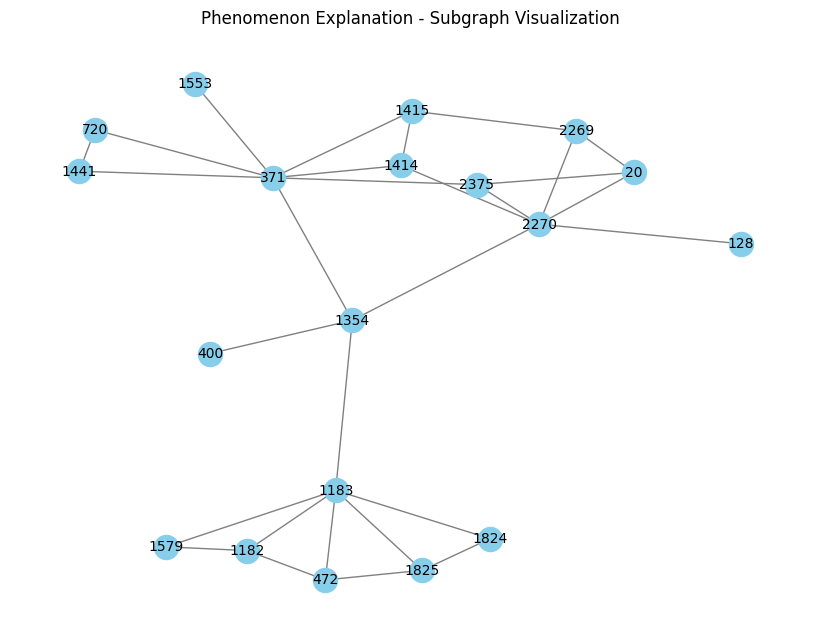

Train Explainer:   2%|▏         | 1/60 [00:03<03:02,  3.10s/it]

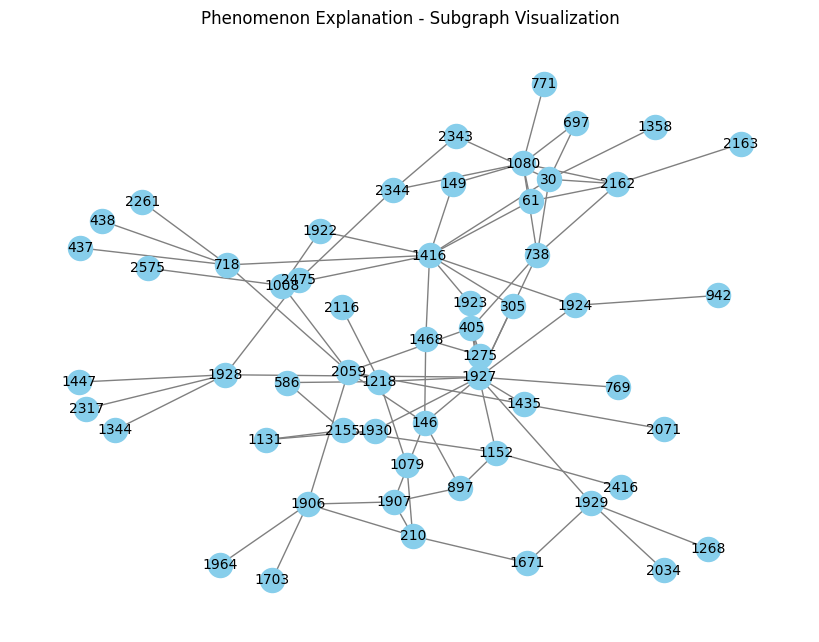

Train Explainer:   3%|▎         | 2/60 [00:04<02:14,  2.33s/it]

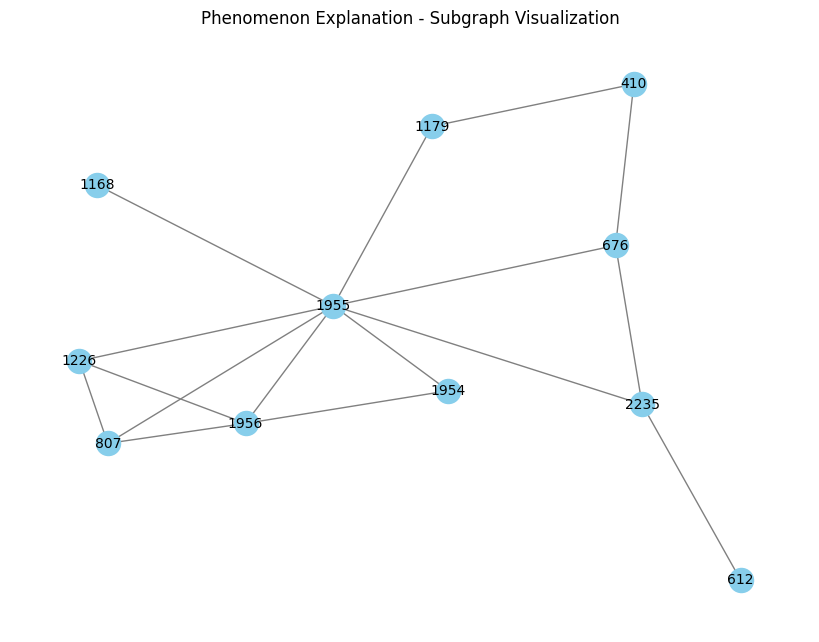

Train Explainer:   5%|▌         | 3/60 [00:06<01:59,  2.10s/it]

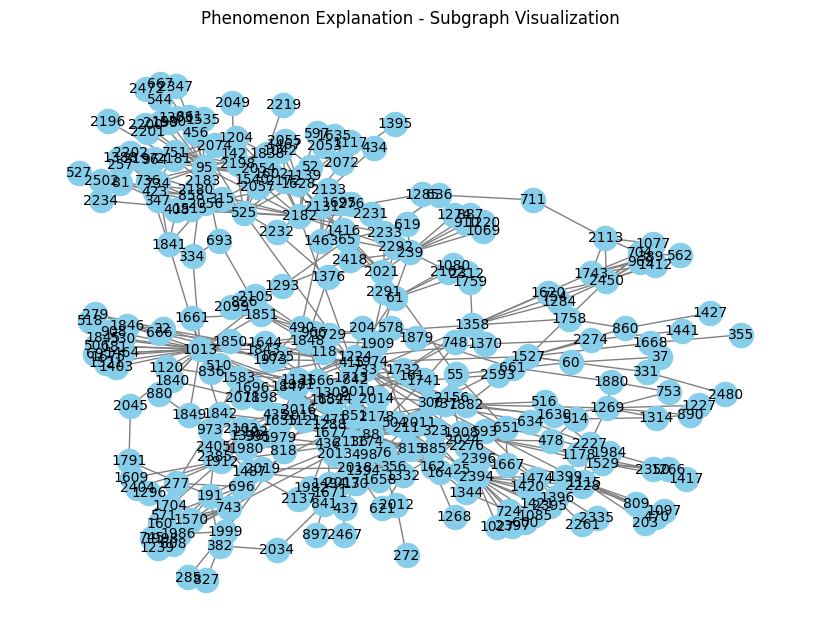

Train Explainer:   7%|▋         | 4/60 [00:09<02:12,  2.37s/it]

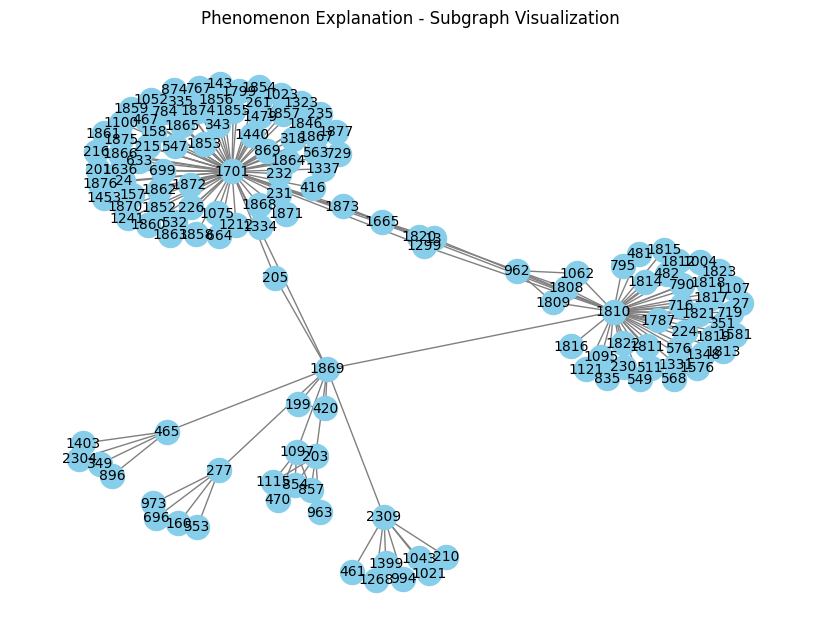

Train Explainer:   8%|▊         | 5/60 [00:11<02:01,  2.20s/it]

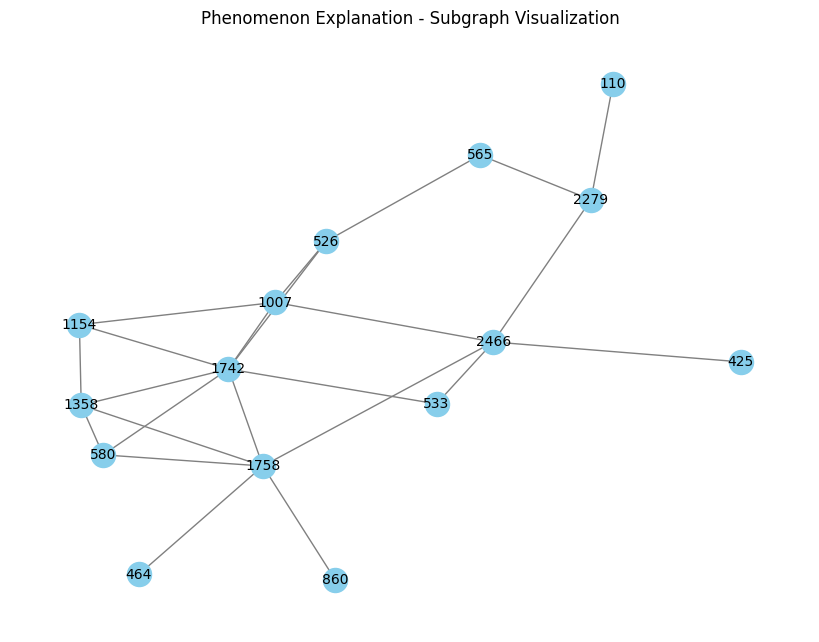

Train Explainer:  10%|█         | 6/60 [00:13<01:54,  2.11s/it]

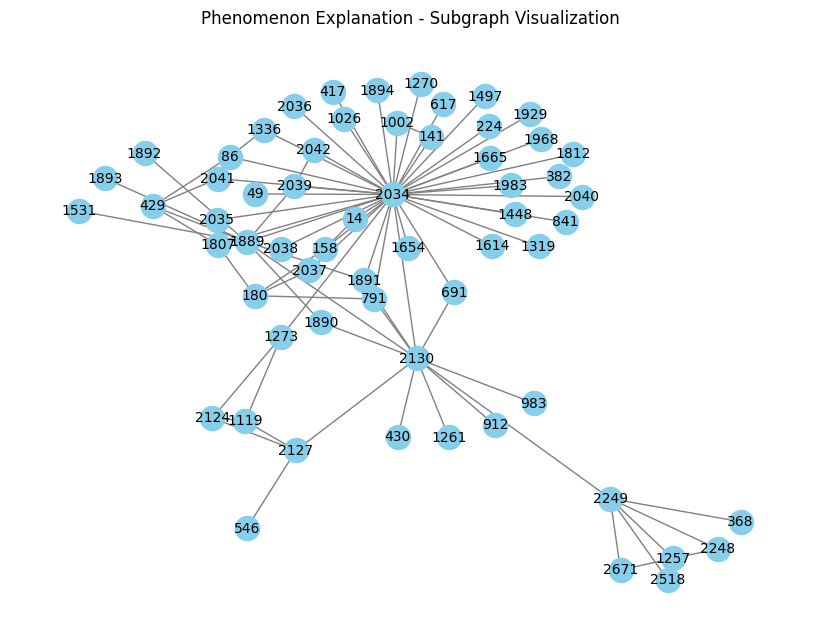

Train Explainer:  12%|█▏        | 7/60 [00:15<01:46,  2.00s/it]

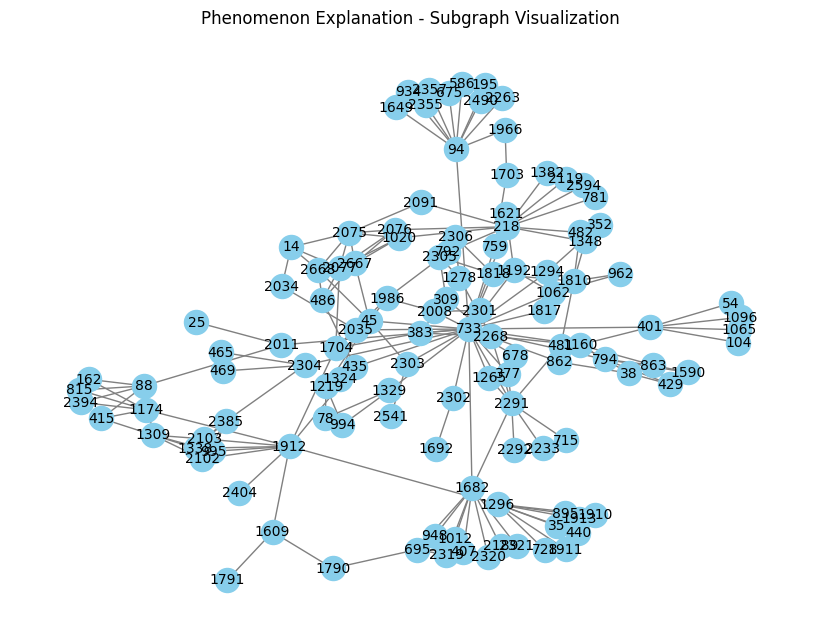

Train Explainer:  13%|█▎        | 8/60 [00:16<01:41,  1.96s/it]

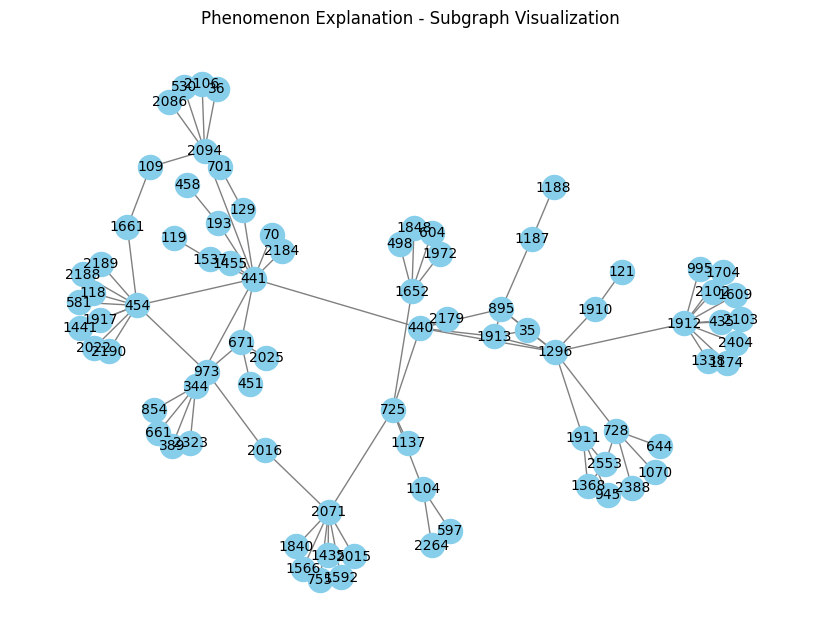

Train Explainer:  15%|█▌        | 9/60 [00:18<01:37,  1.91s/it]

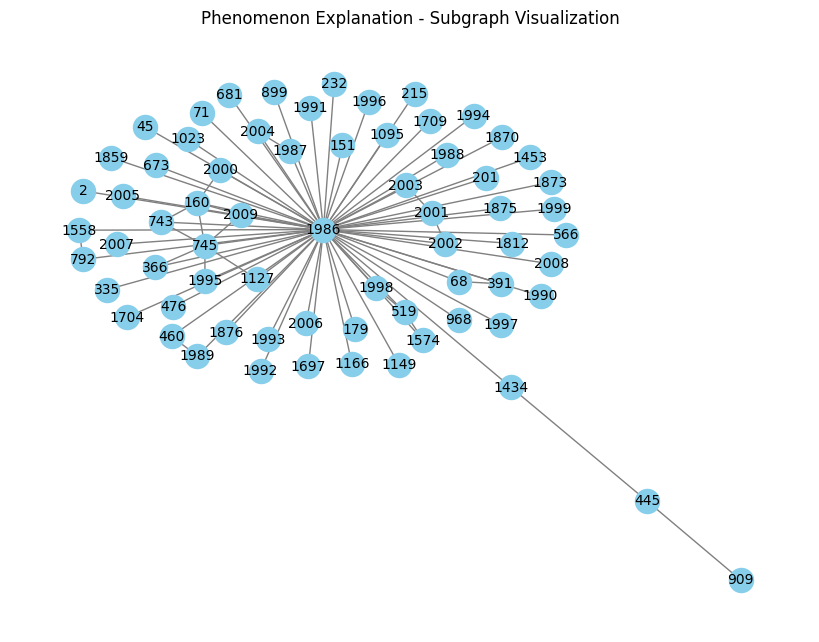

Train Explainer:  17%|█▋        | 10/60 [00:21<01:40,  2.00s/it]

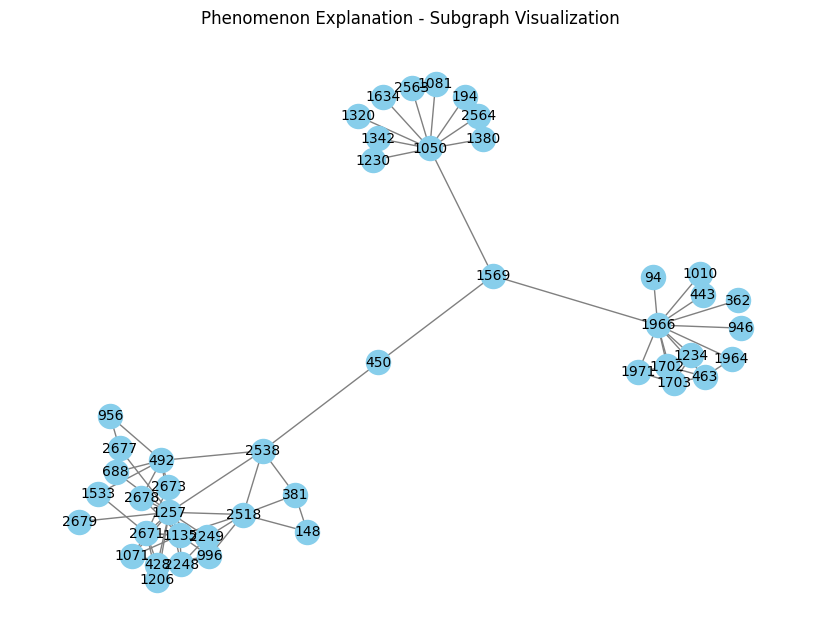

Train Explainer:  18%|█▊        | 11/60 [00:22<01:37,  1.98s/it]

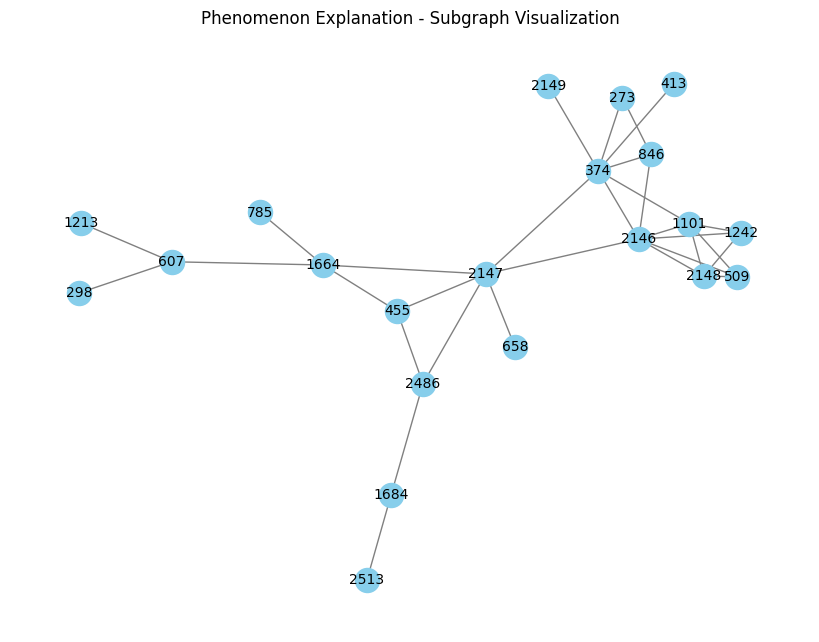

Train Explainer:  20%|██        | 12/60 [00:24<01:31,  1.90s/it]

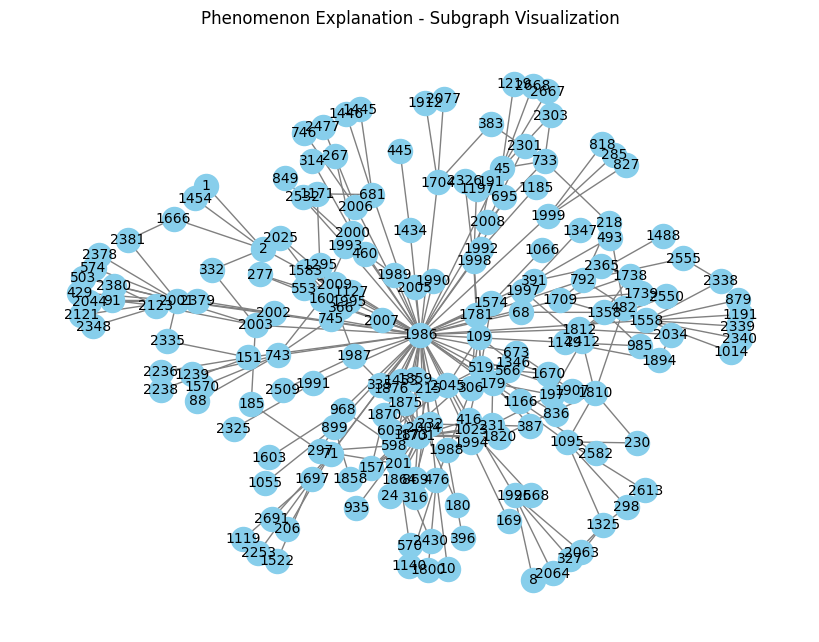

Train Explainer:  22%|██▏       | 13/60 [00:26<01:30,  1.94s/it]

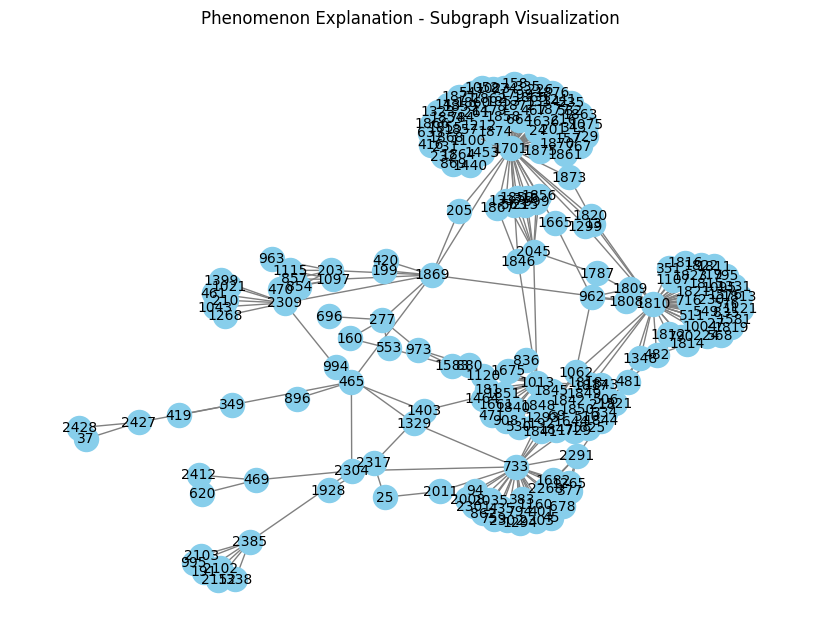

Train Explainer:  23%|██▎       | 14/60 [00:28<01:30,  1.98s/it]

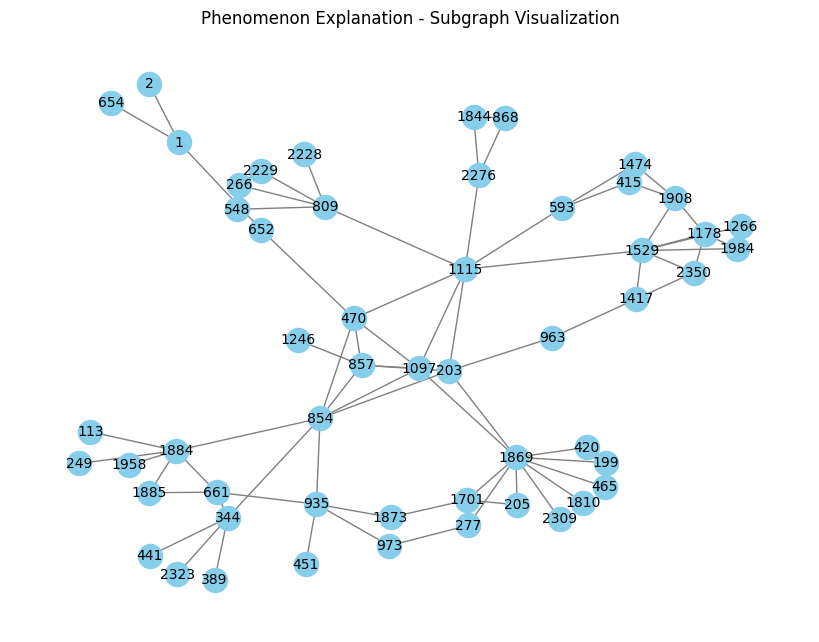

Train Explainer:  25%|██▌       | 15/60 [00:30<01:26,  1.91s/it]

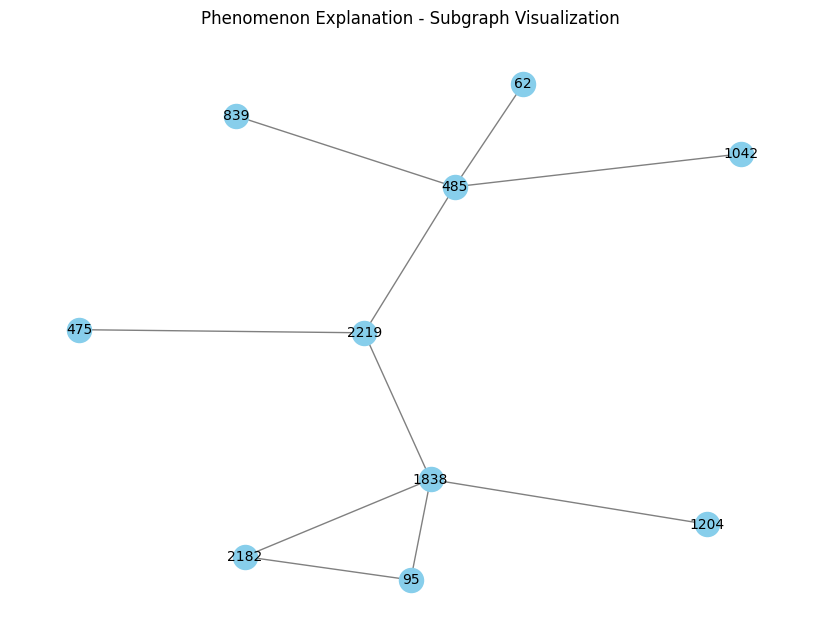

Train Explainer:  27%|██▋       | 16/60 [00:32<01:22,  1.87s/it]

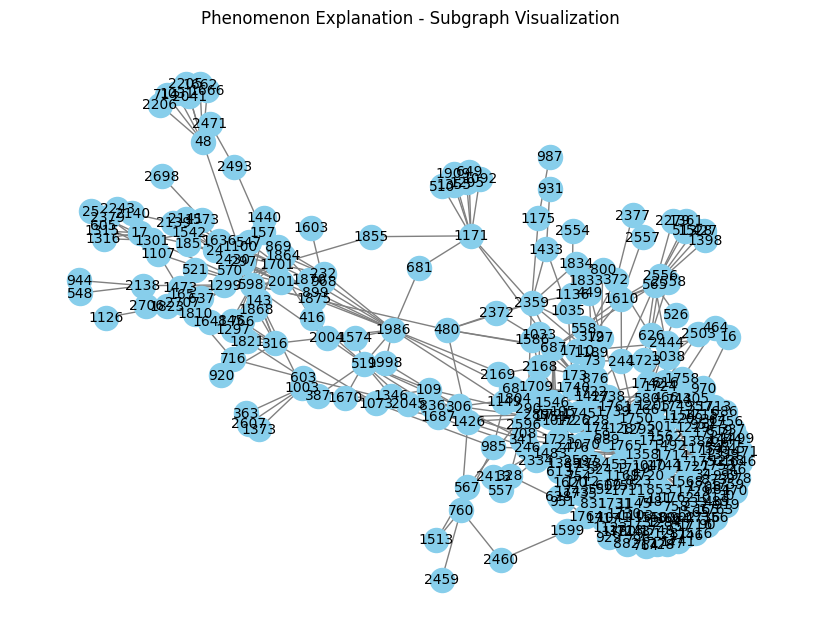

Train Explainer:  28%|██▊       | 17/60 [00:35<01:36,  2.23s/it]

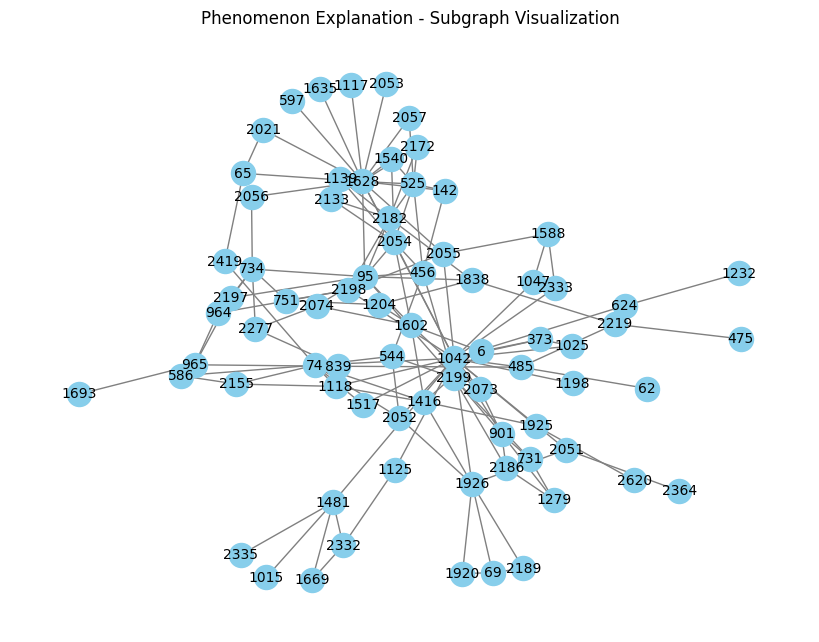

Train Explainer:  30%|███       | 18/60 [00:38<01:40,  2.40s/it]

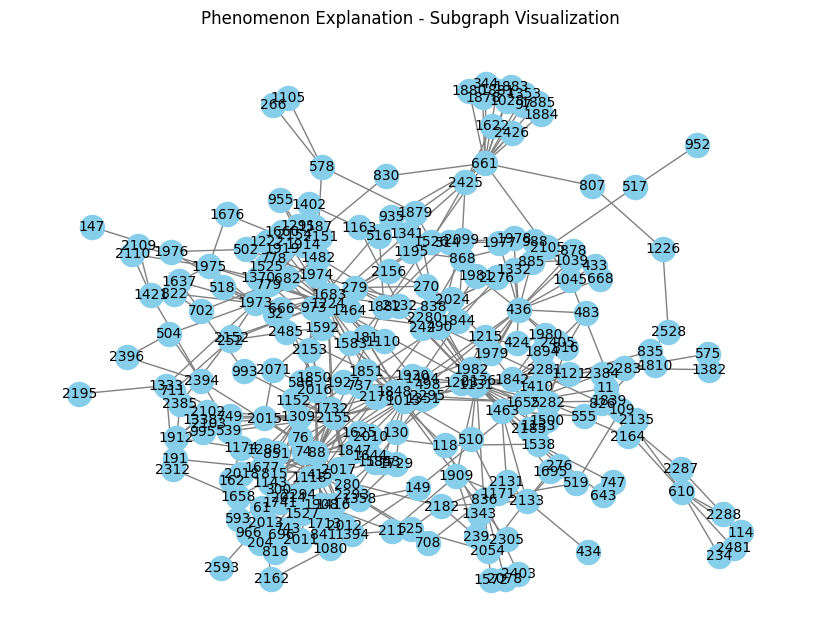

Train Explainer:  32%|███▏      | 19/60 [00:40<01:35,  2.33s/it]

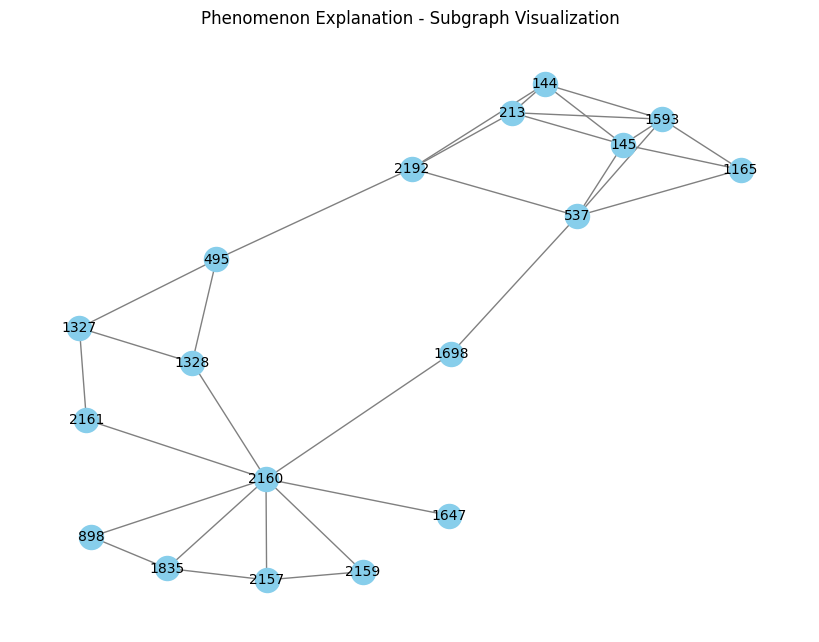

Train Explainer:  33%|███▎      | 20/60 [00:42<01:26,  2.15s/it]

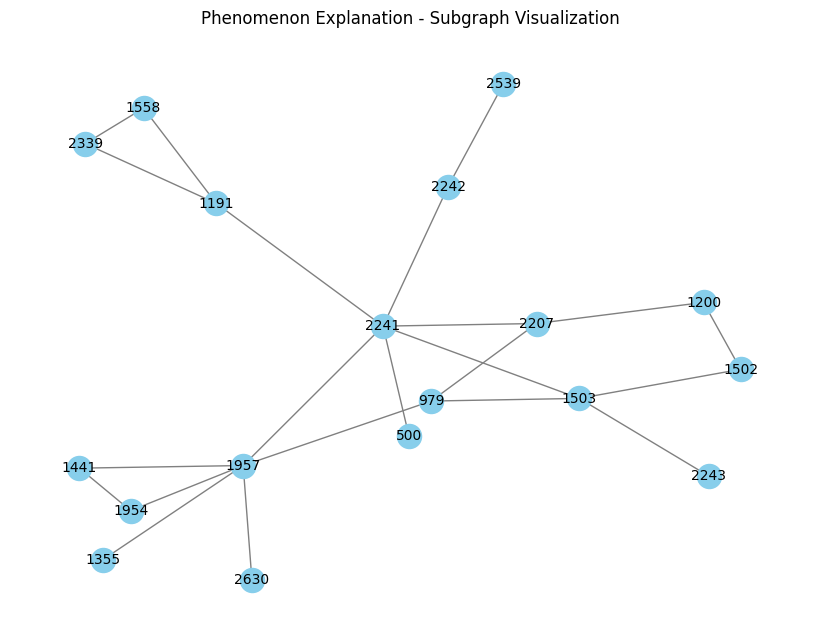

Train Explainer:  35%|███▌      | 21/60 [00:43<01:19,  2.03s/it]

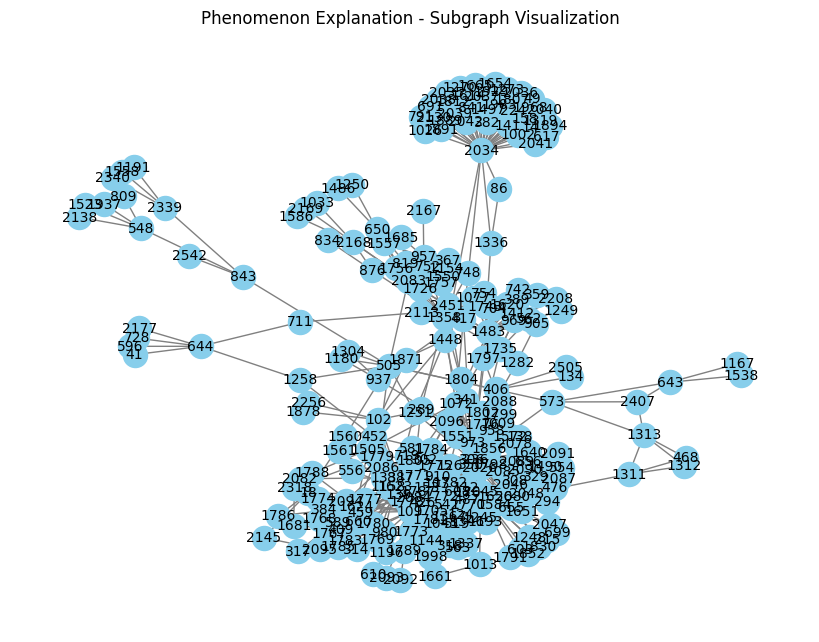

Train Explainer:  37%|███▋      | 22/60 [00:46<01:23,  2.20s/it]

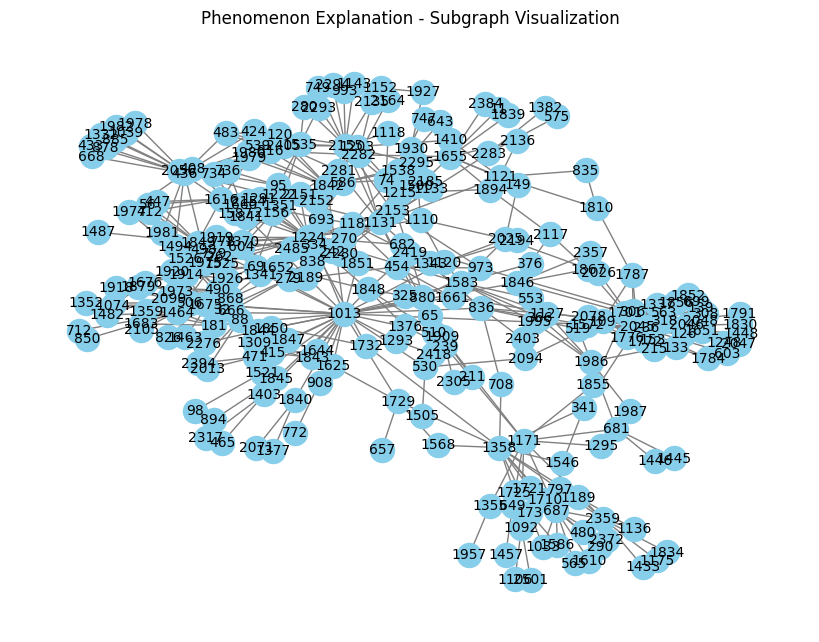

Train Explainer:  38%|███▊      | 23/60 [00:48<01:24,  2.30s/it]

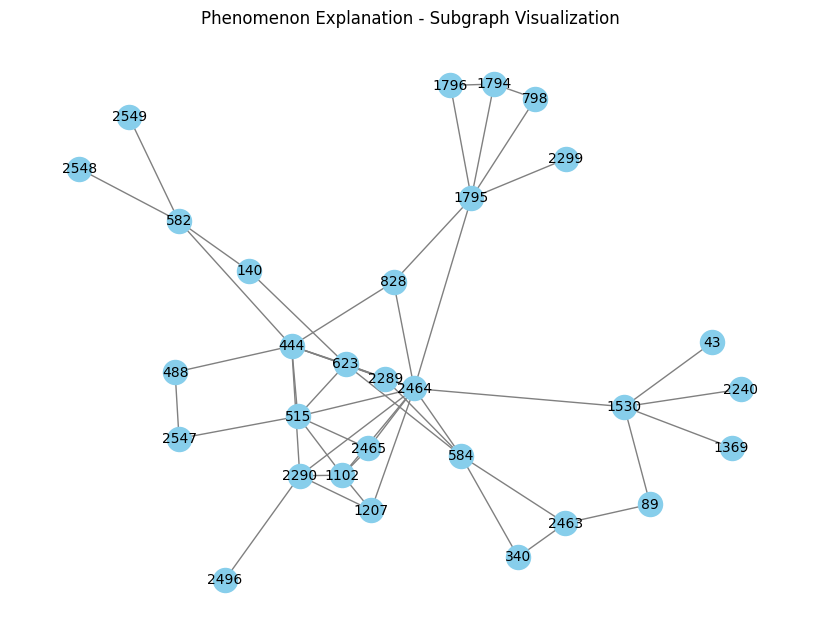

Train Explainer:  40%|████      | 24/60 [00:50<01:16,  2.13s/it]

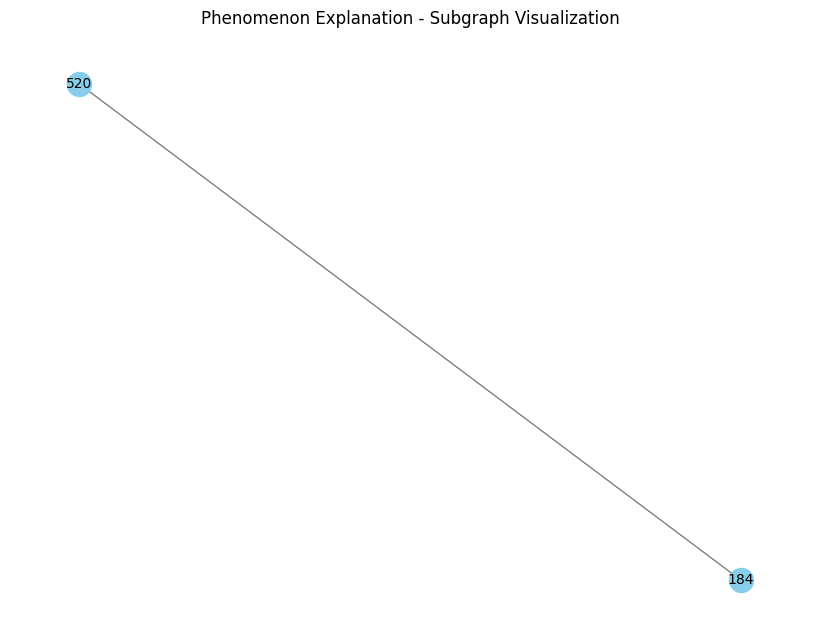

Train Explainer:  42%|████▏     | 25/60 [00:52<01:09,  1.99s/it]

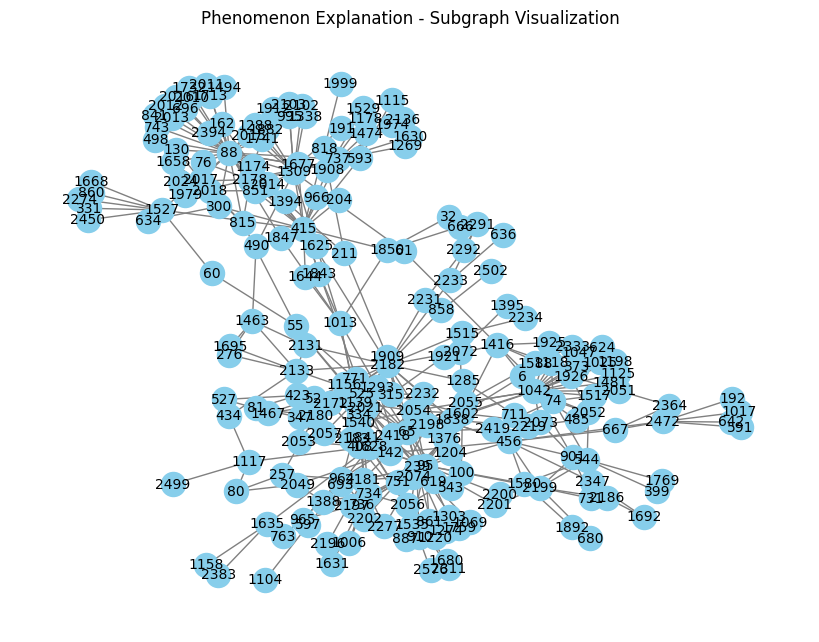

Train Explainer:  43%|████▎     | 26/60 [00:54<01:08,  2.03s/it]

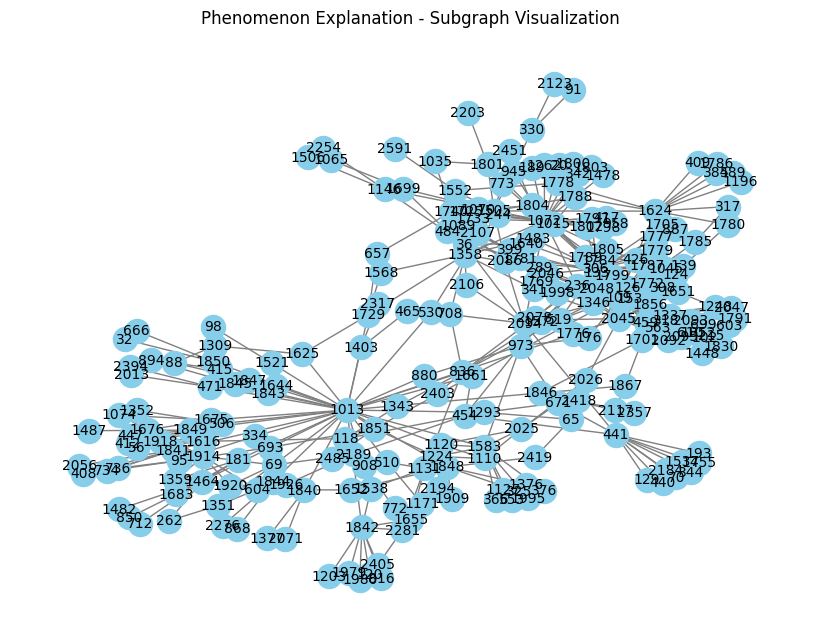

Train Explainer:  45%|████▌     | 27/60 [00:56<01:10,  2.14s/it]

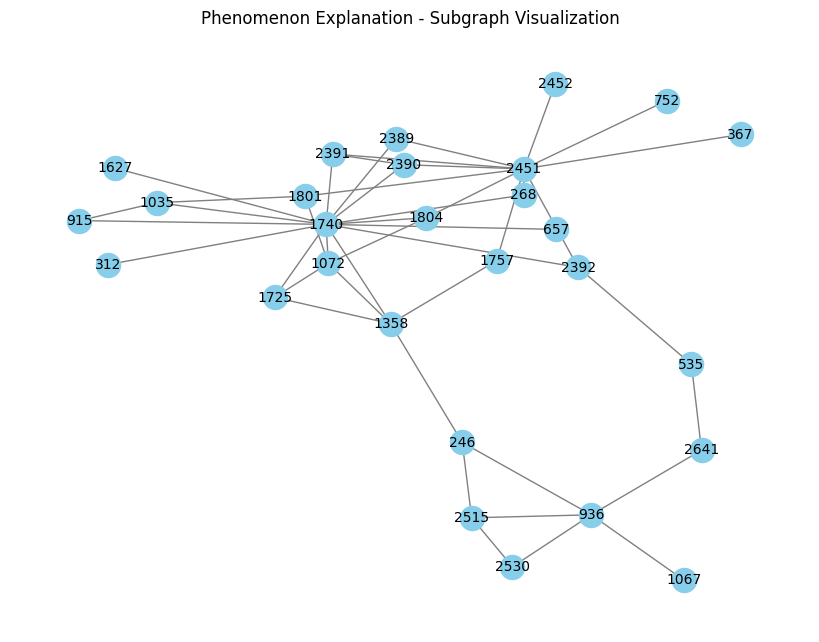

Train Explainer:  47%|████▋     | 28/60 [00:58<01:07,  2.11s/it]

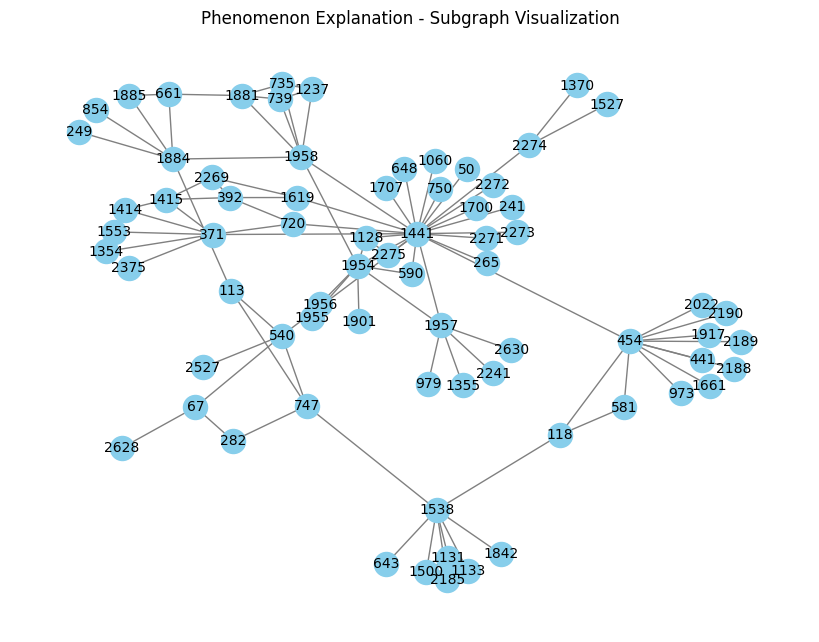

Train Explainer:  48%|████▊     | 29/60 [01:01<01:05,  2.12s/it]

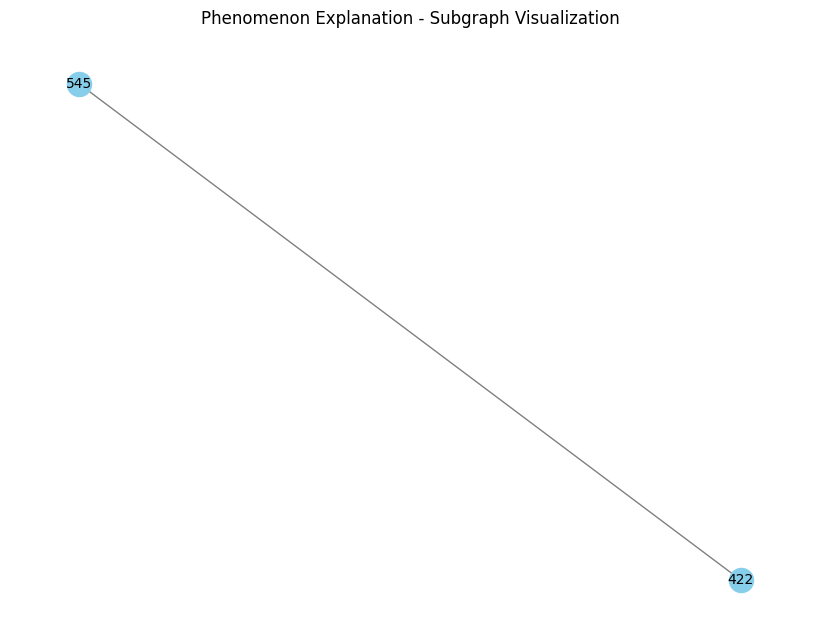

Train Explainer:  50%|█████     | 30/60 [01:02<00:59,  1.99s/it]

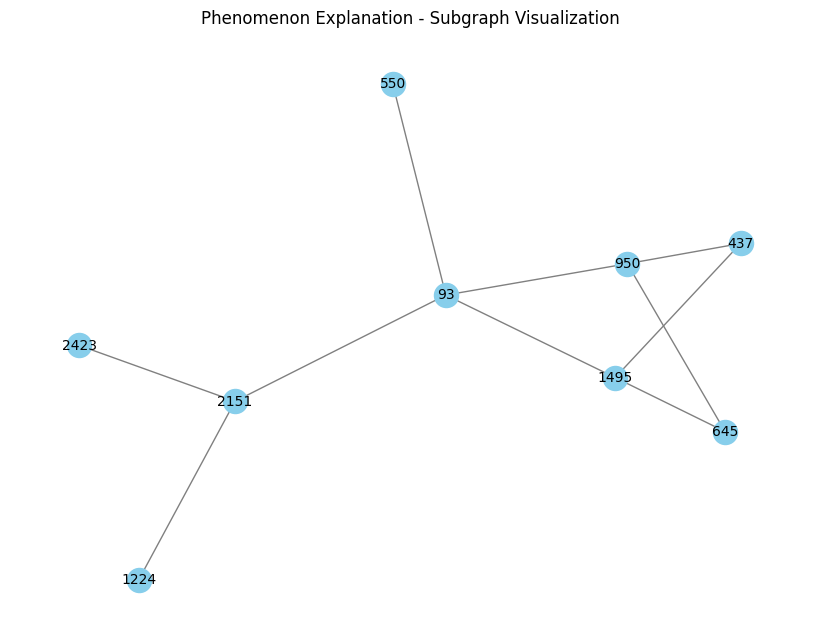

Train Explainer:  52%|█████▏    | 31/60 [01:04<00:55,  1.90s/it]

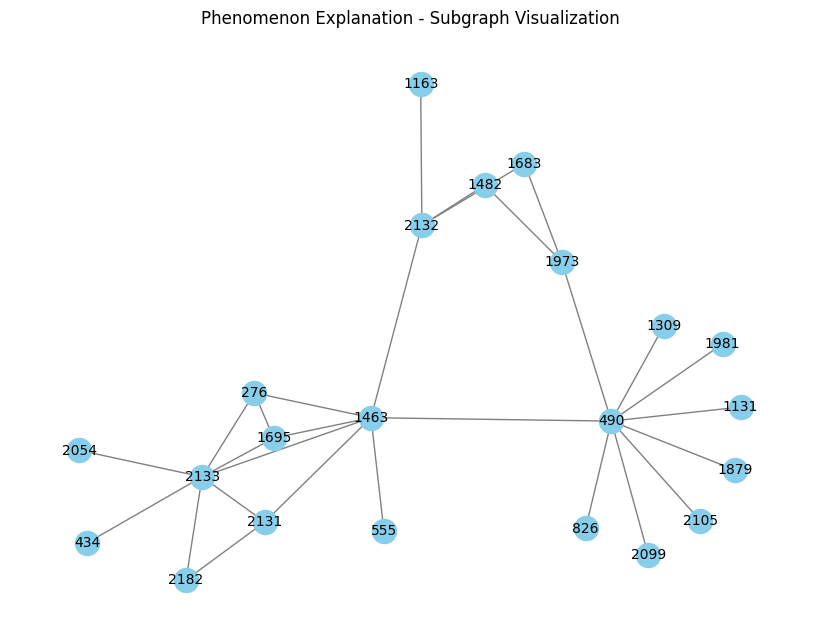

Train Explainer:  53%|█████▎    | 32/60 [01:06<00:51,  1.84s/it]

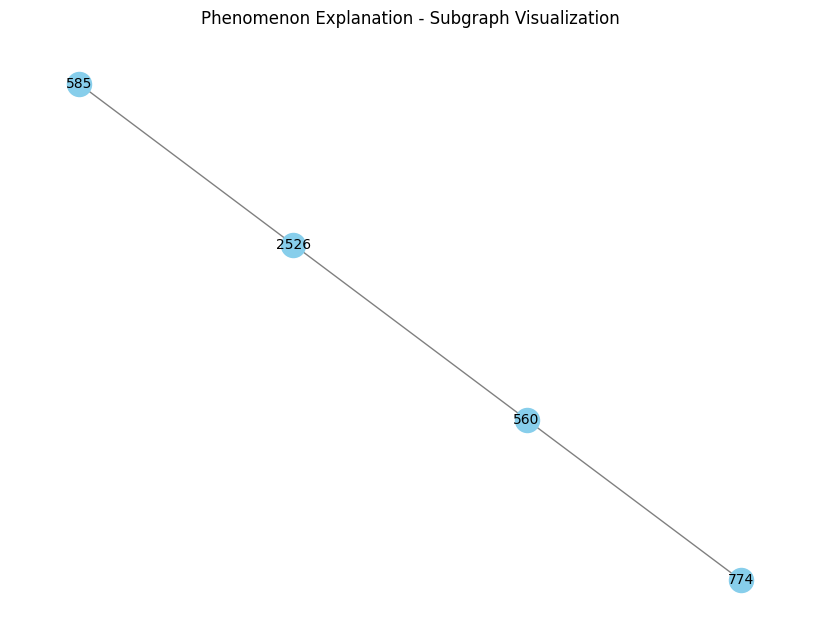

Train Explainer:  55%|█████▌    | 33/60 [01:07<00:48,  1.80s/it]

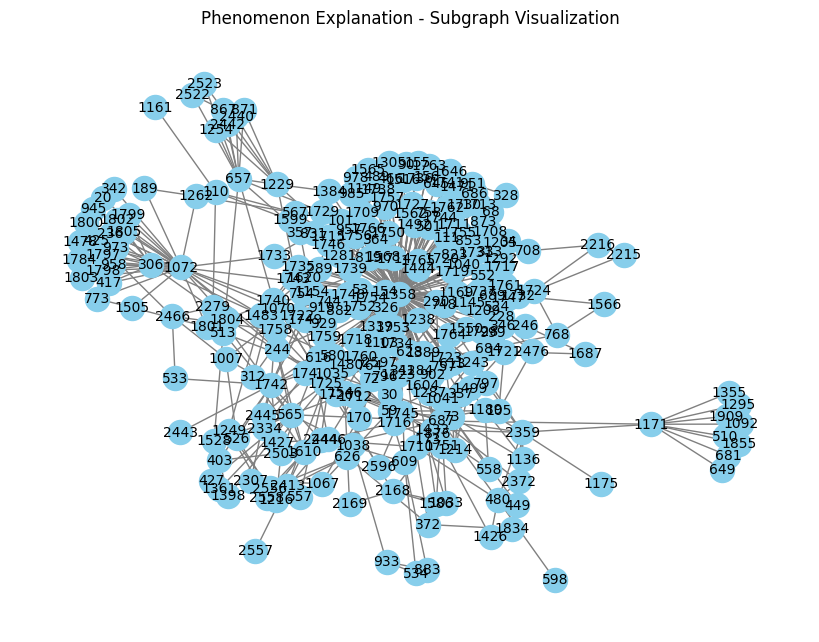

Train Explainer:  57%|█████▋    | 34/60 [01:10<00:50,  1.93s/it]

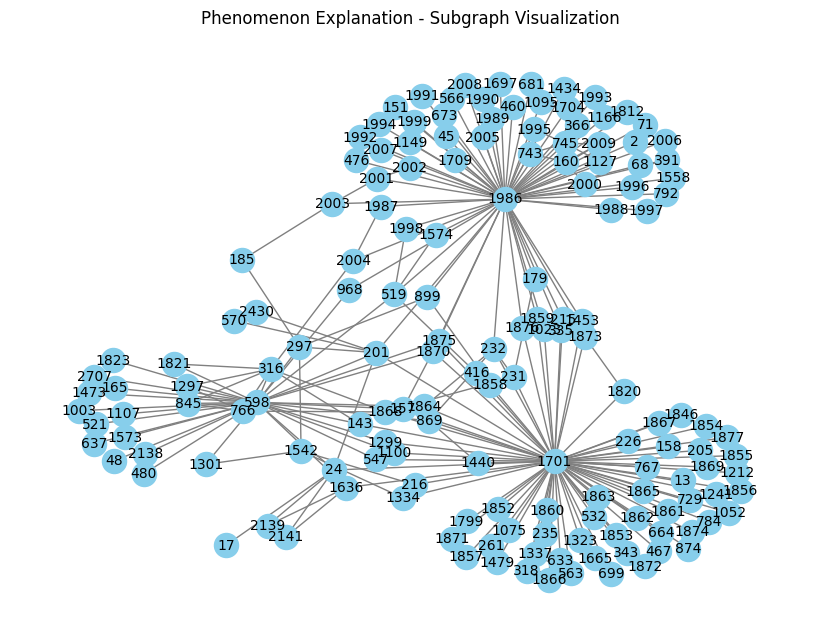

Train Explainer:  58%|█████▊    | 35/60 [01:12<00:52,  2.08s/it]

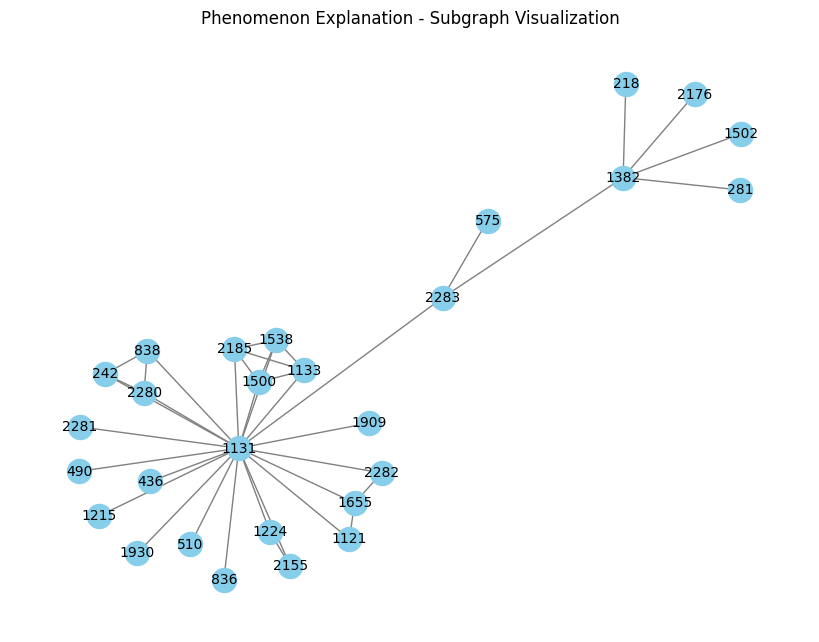

Train Explainer:  60%|██████    | 36/60 [01:14<00:48,  2.04s/it]

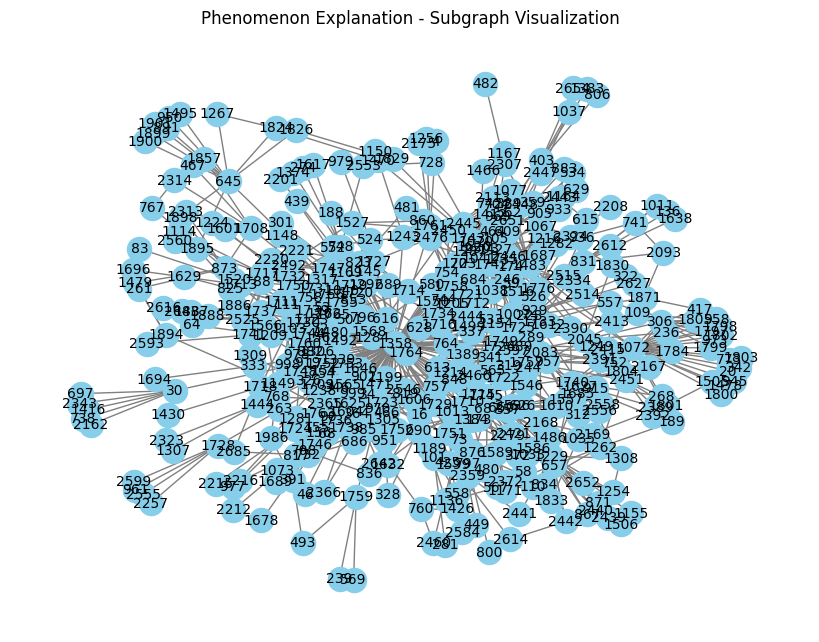

Train Explainer:  62%|██████▏   | 37/60 [01:17<00:51,  2.23s/it]

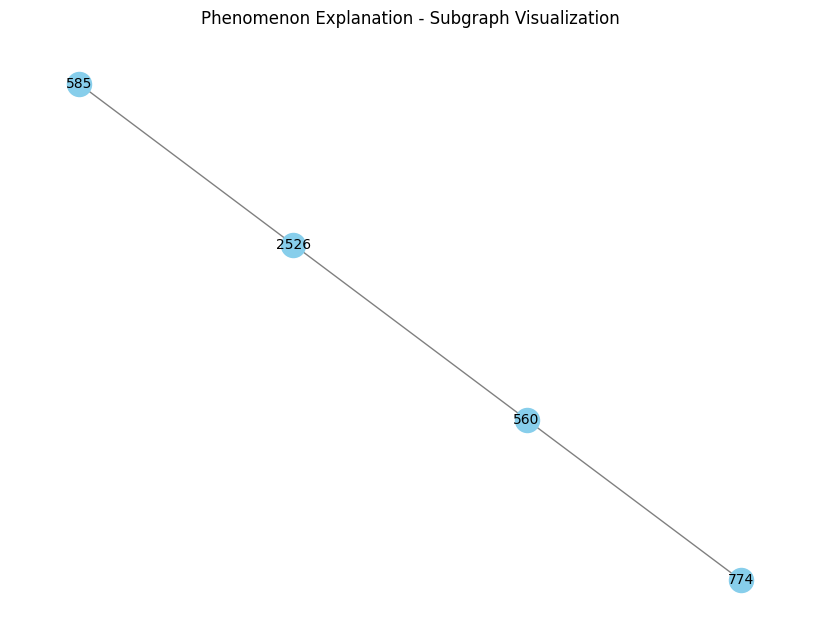

Train Explainer:  63%|██████▎   | 38/60 [01:19<00:47,  2.15s/it]

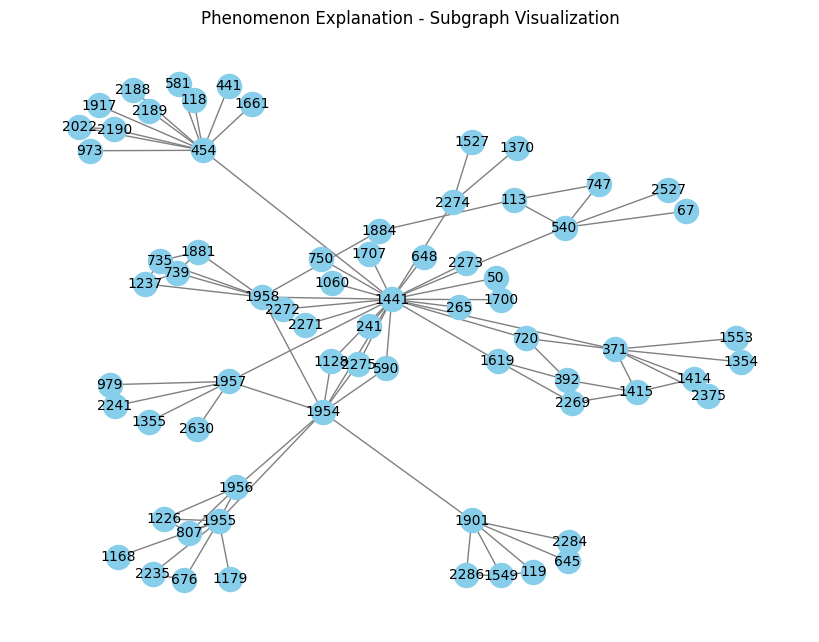

Train Explainer:  65%|██████▌   | 39/60 [01:20<00:42,  2.05s/it]

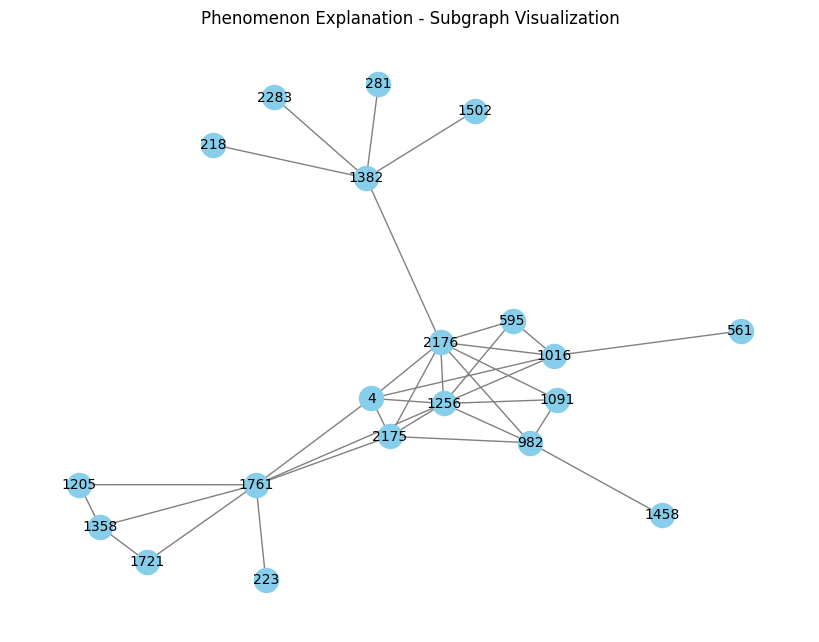

Train Explainer:  67%|██████▋   | 40/60 [01:22<00:38,  1.94s/it]

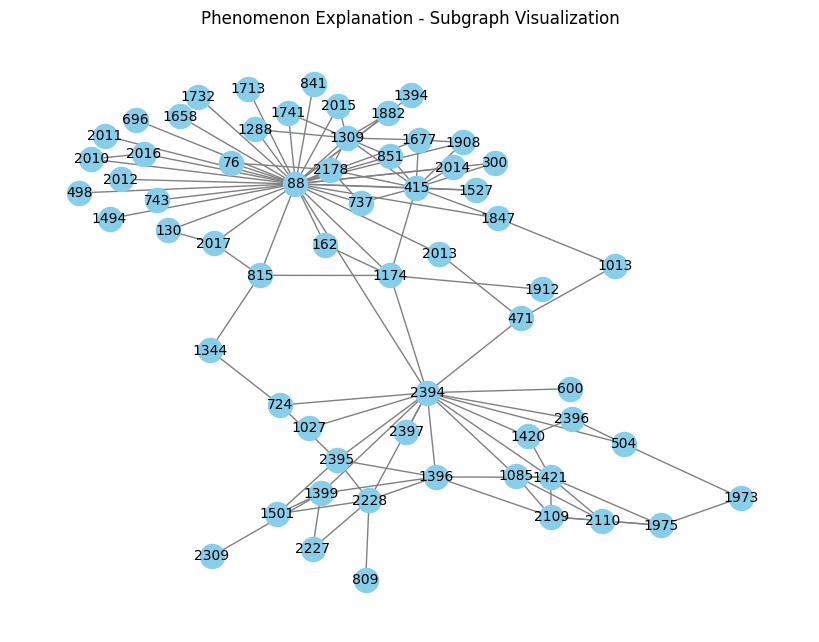

Train Explainer:  68%|██████▊   | 41/60 [01:24<00:37,  1.99s/it]

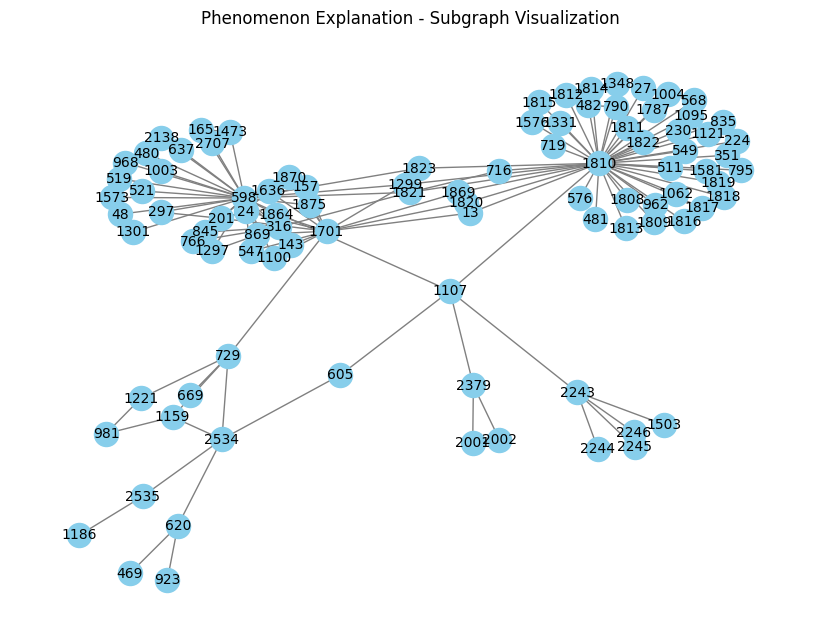

Train Explainer:  70%|███████   | 42/60 [01:26<00:37,  2.06s/it]

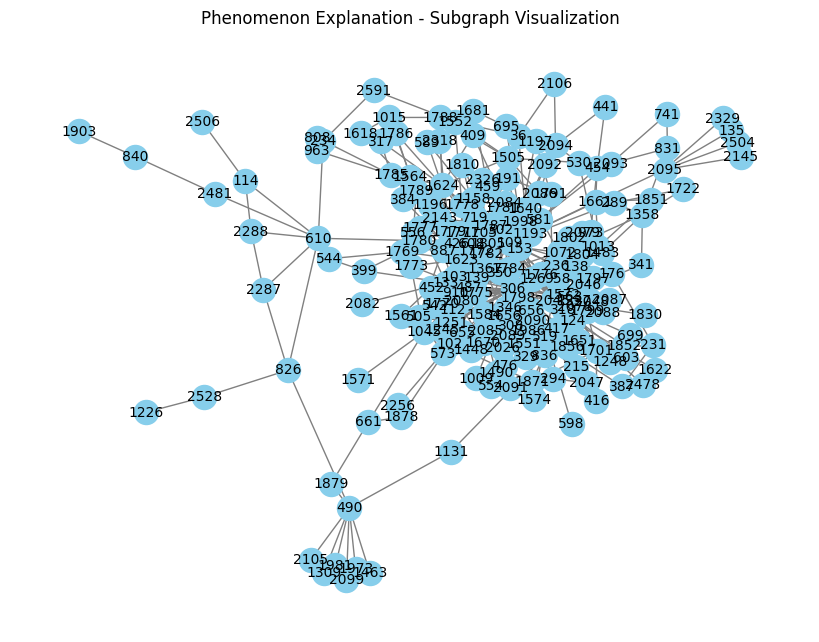

Train Explainer:  72%|███████▏  | 43/60 [01:28<00:34,  2.05s/it]

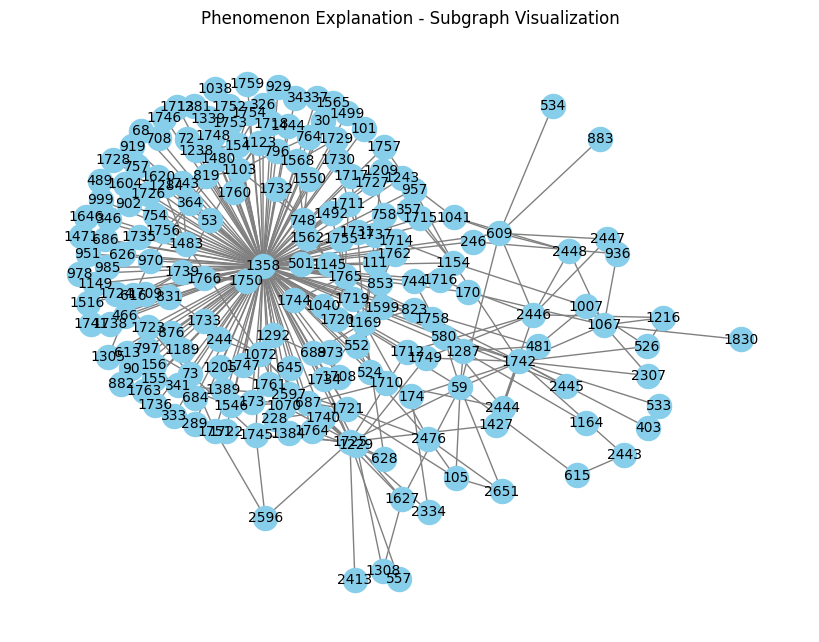

Train Explainer:  73%|███████▎  | 44/60 [01:31<00:35,  2.21s/it]

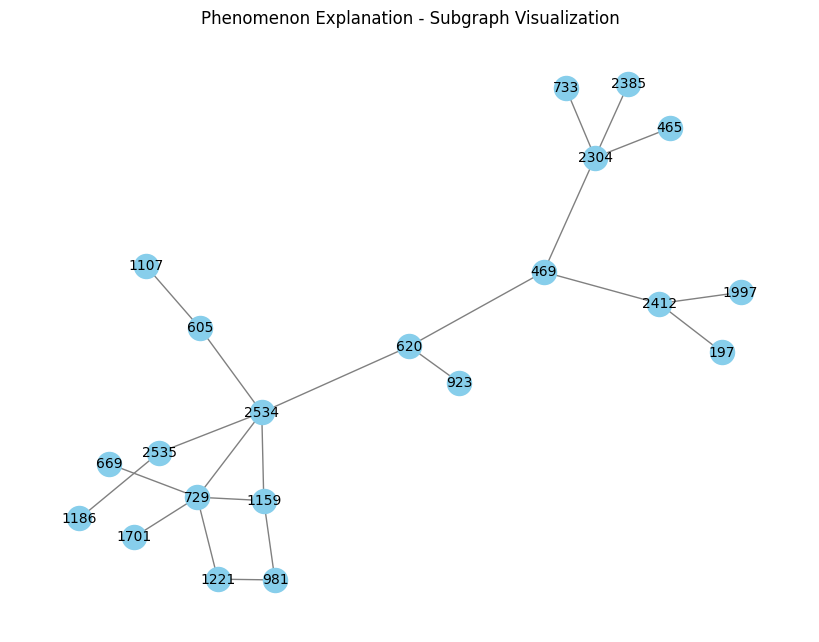

Train Explainer:  75%|███████▌  | 45/60 [01:34<00:35,  2.34s/it]

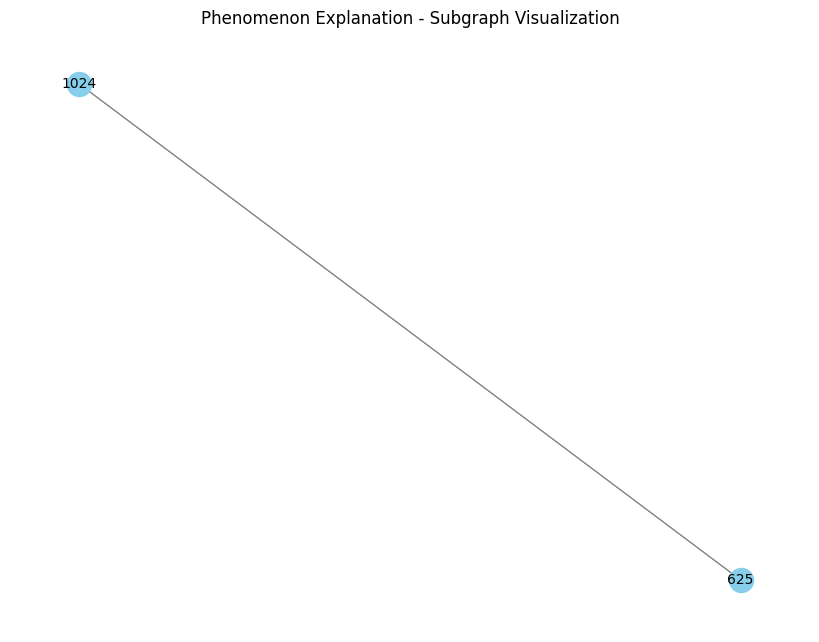

Train Explainer:  77%|███████▋  | 46/60 [01:35<00:30,  2.15s/it]

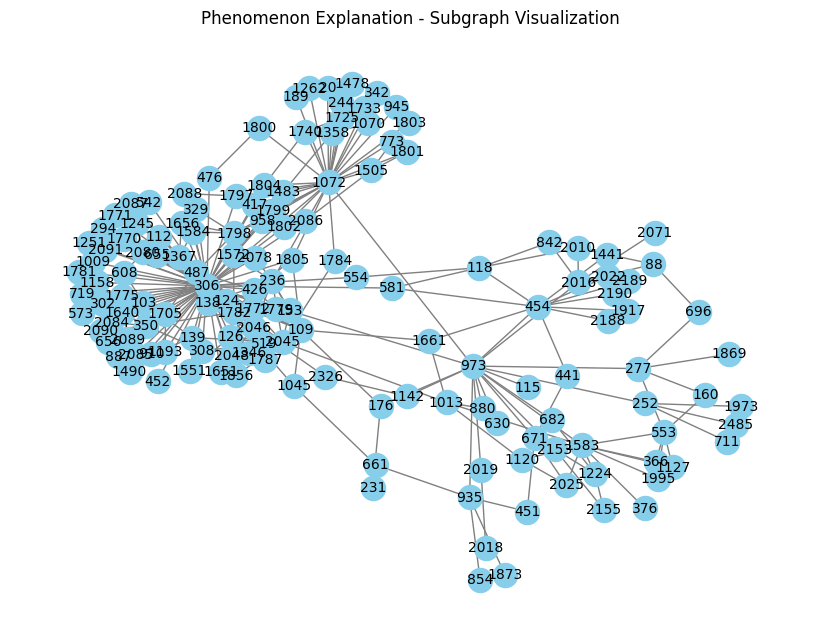

Train Explainer:  78%|███████▊  | 47/60 [01:38<00:28,  2.21s/it]

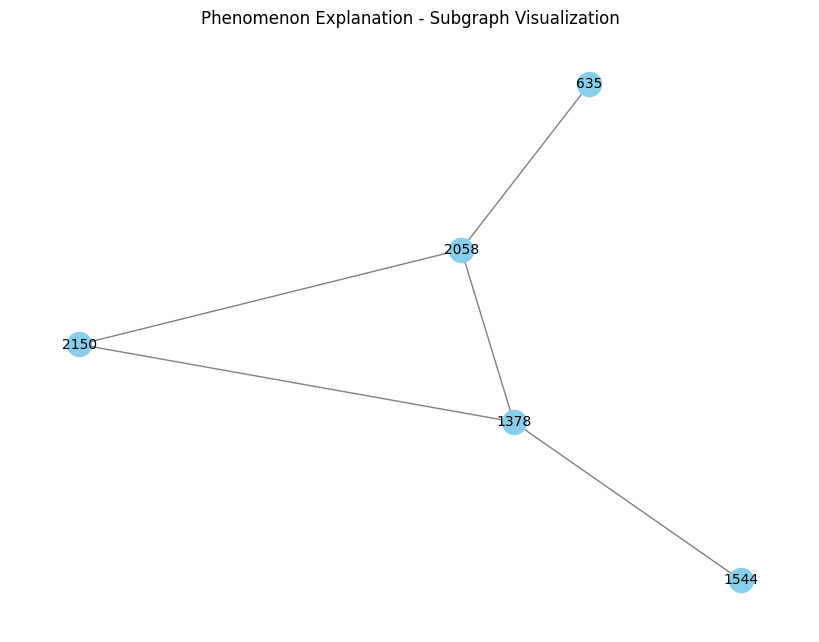

Train Explainer:  80%|████████  | 48/60 [01:40<00:25,  2.13s/it]

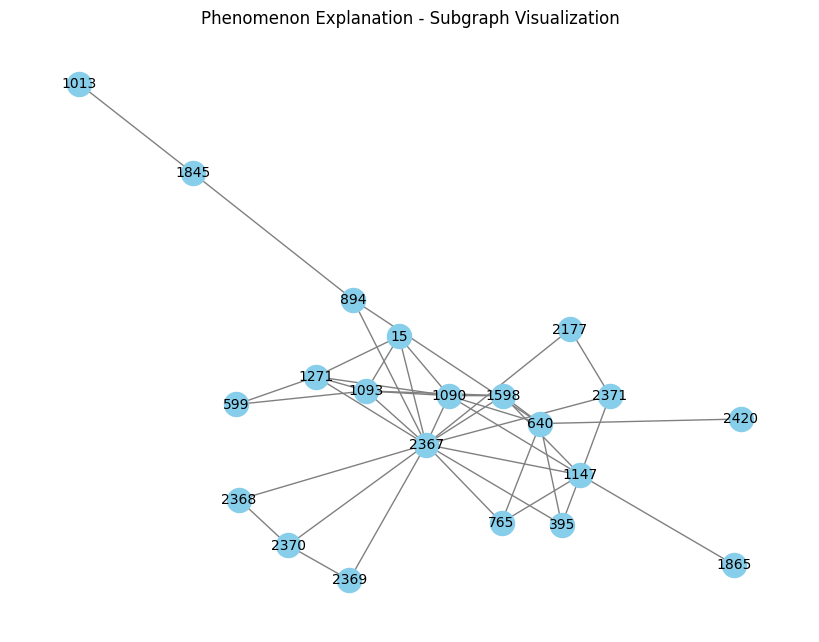

Train Explainer:  82%|████████▏ | 49/60 [01:41<00:22,  2.01s/it]

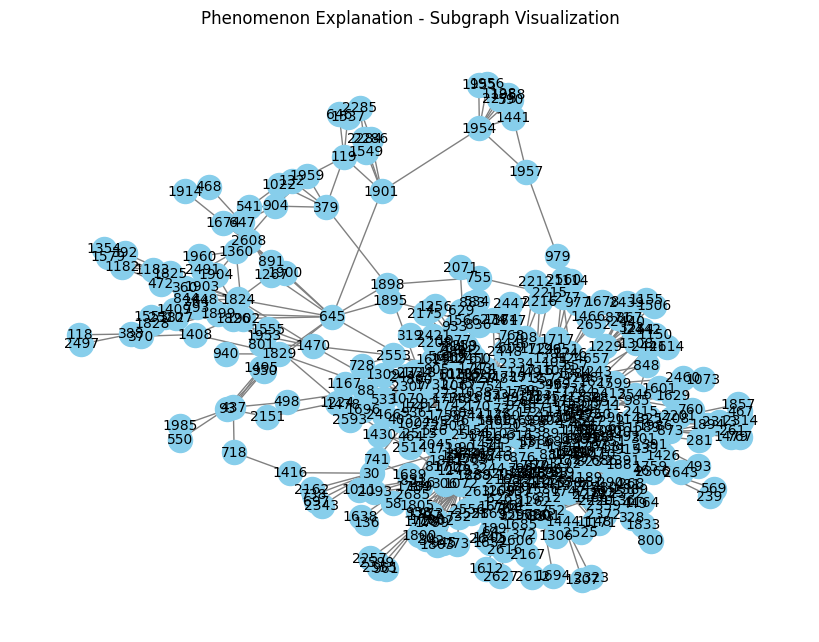

Train Explainer:  83%|████████▎ | 50/60 [01:45<00:23,  2.37s/it]

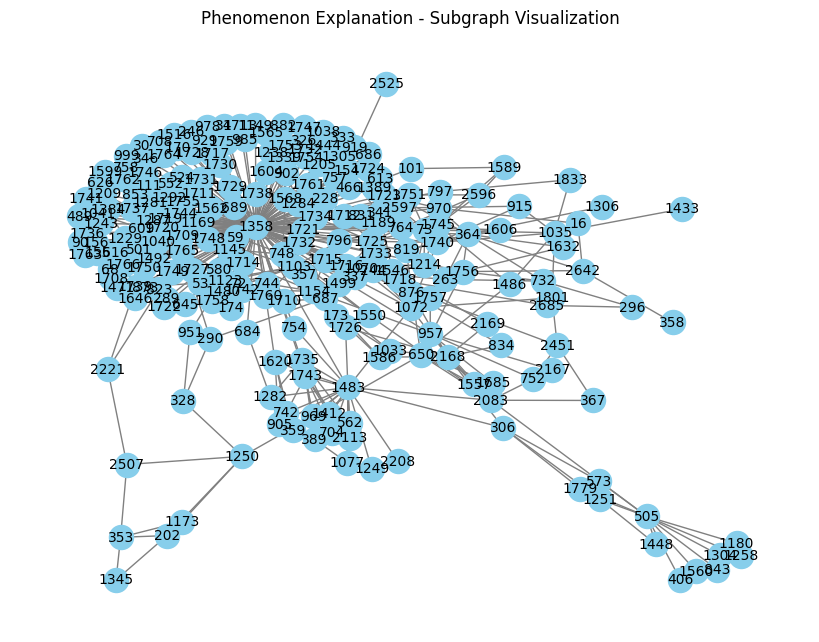

Train Explainer:  85%|████████▌ | 51/60 [01:47<00:20,  2.30s/it]

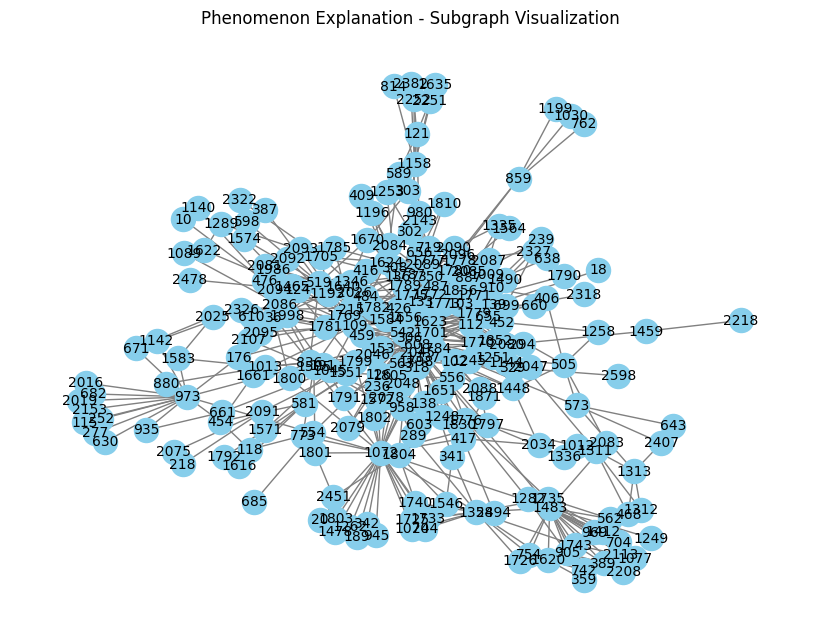

Train Explainer:  87%|████████▋ | 52/60 [01:49<00:18,  2.32s/it]

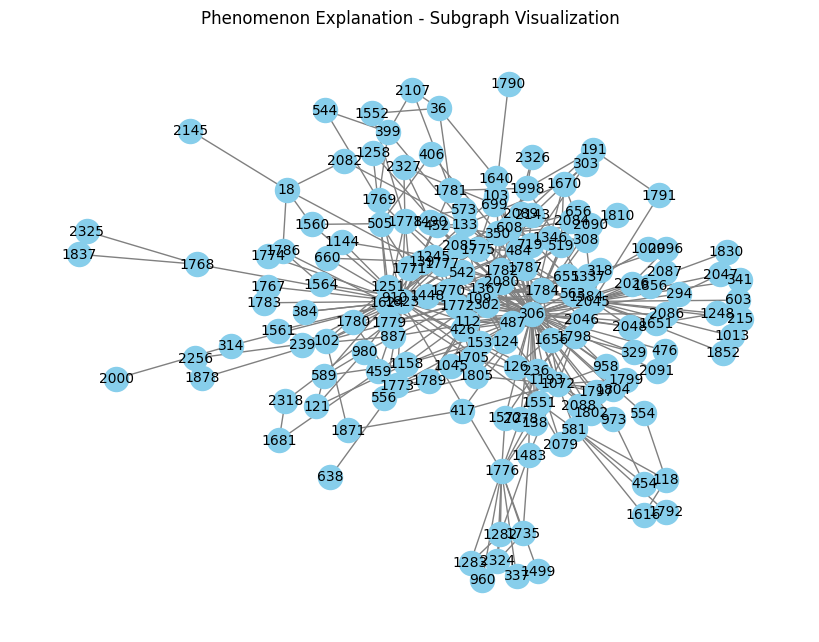

Train Explainer:  88%|████████▊ | 53/60 [01:52<00:16,  2.41s/it]

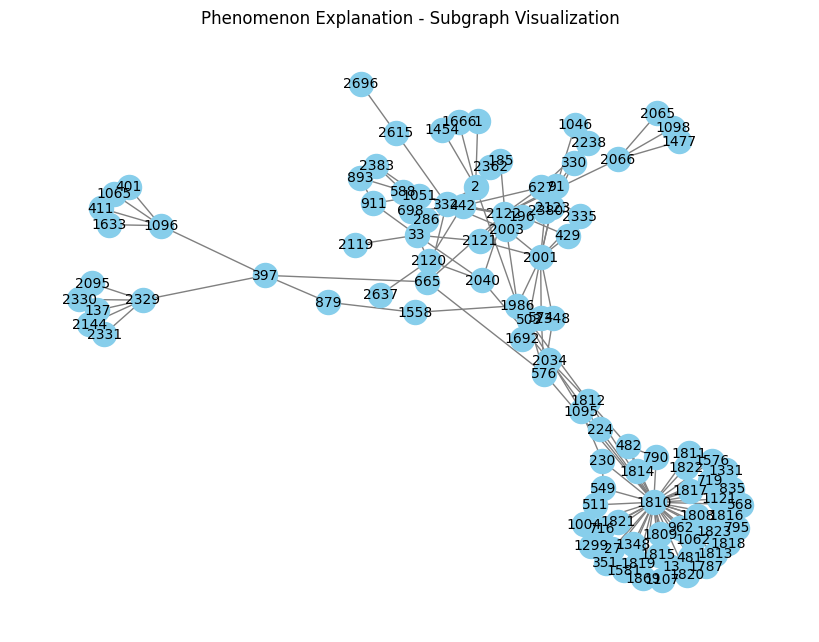

Train Explainer:  90%|█████████ | 54/60 [01:54<00:13,  2.26s/it]

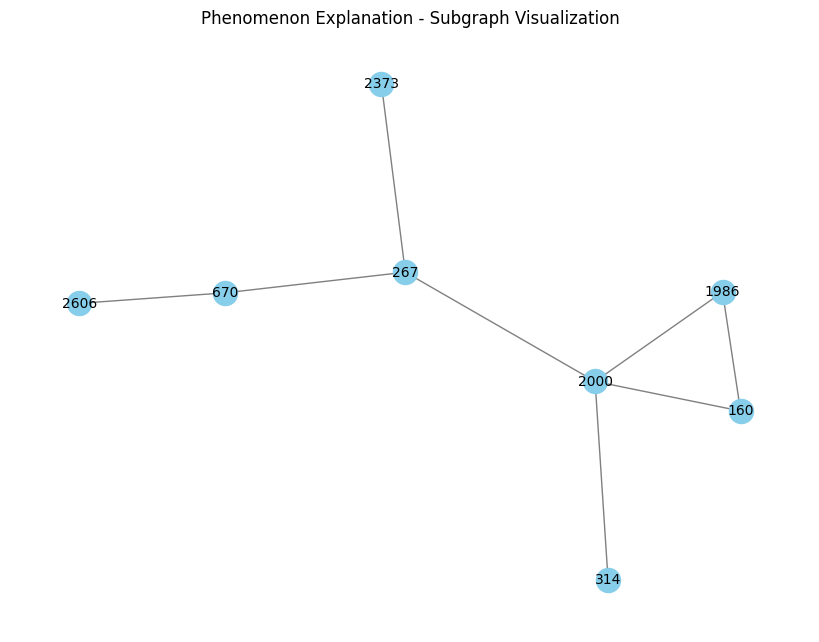

Train Explainer:  92%|█████████▏| 55/60 [01:55<00:10,  2.10s/it]

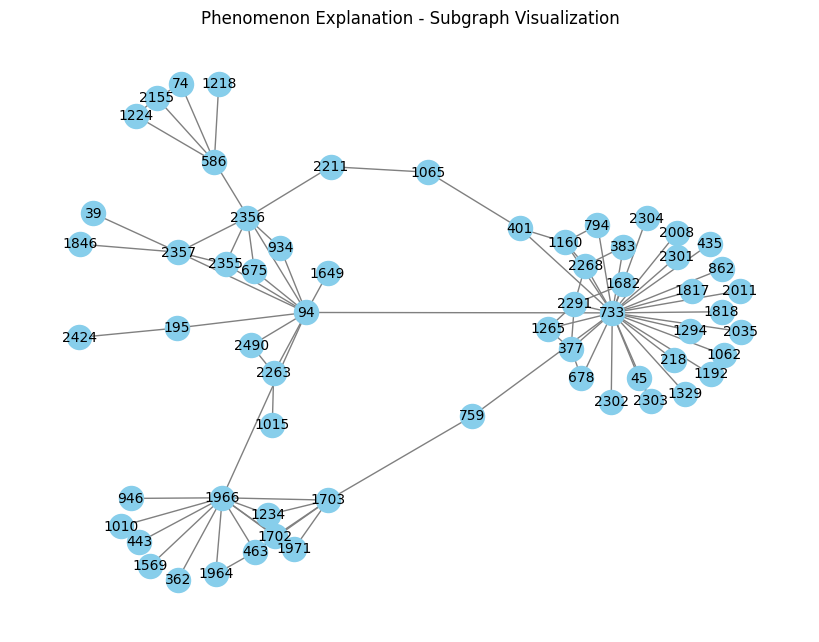

Train Explainer:  93%|█████████▎| 56/60 [01:57<00:08,  2.01s/it]

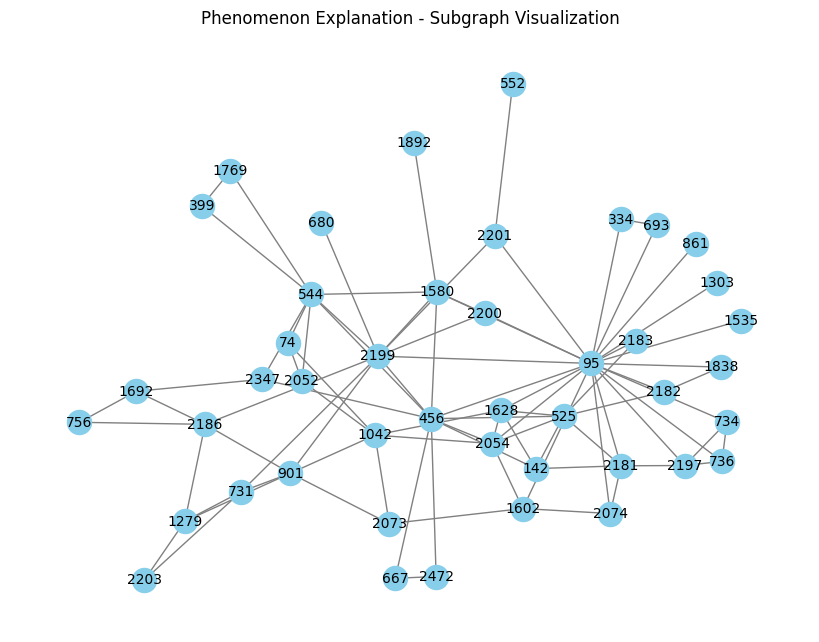

Train Explainer:  95%|█████████▌| 57/60 [01:59<00:05,  1.94s/it]

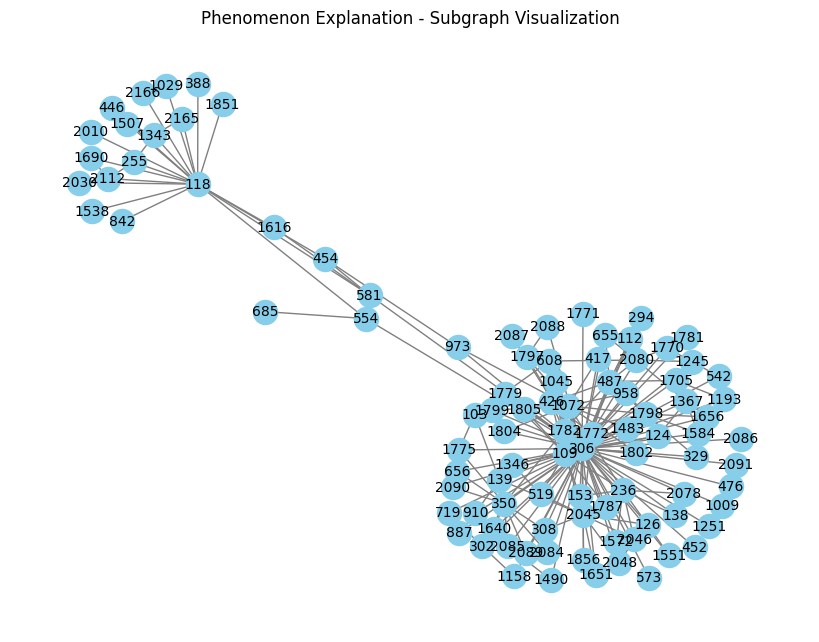

Train Explainer:  97%|█████████▋| 58/60 [02:01<00:03,  1.92s/it]

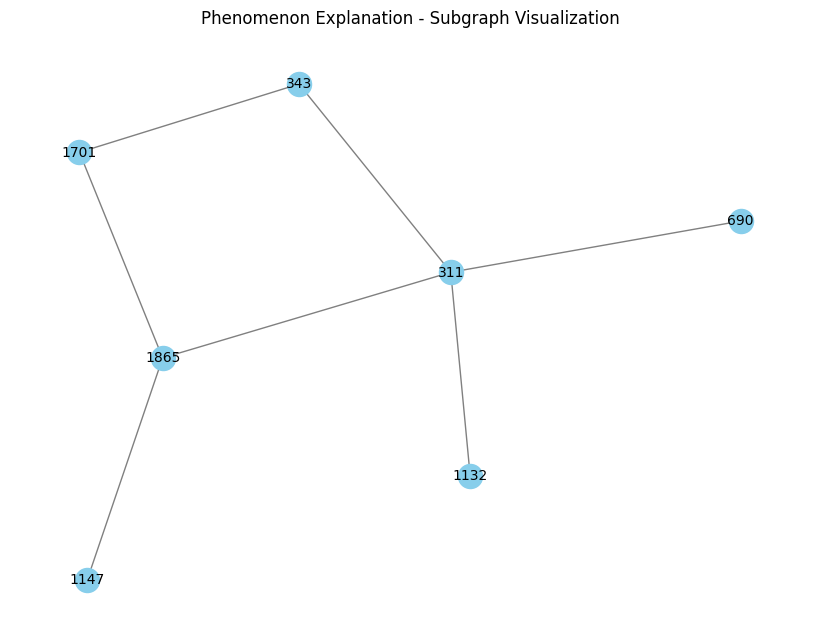

Train Explainer:  98%|█████████▊| 59/60 [02:03<00:01,  1.93s/it]

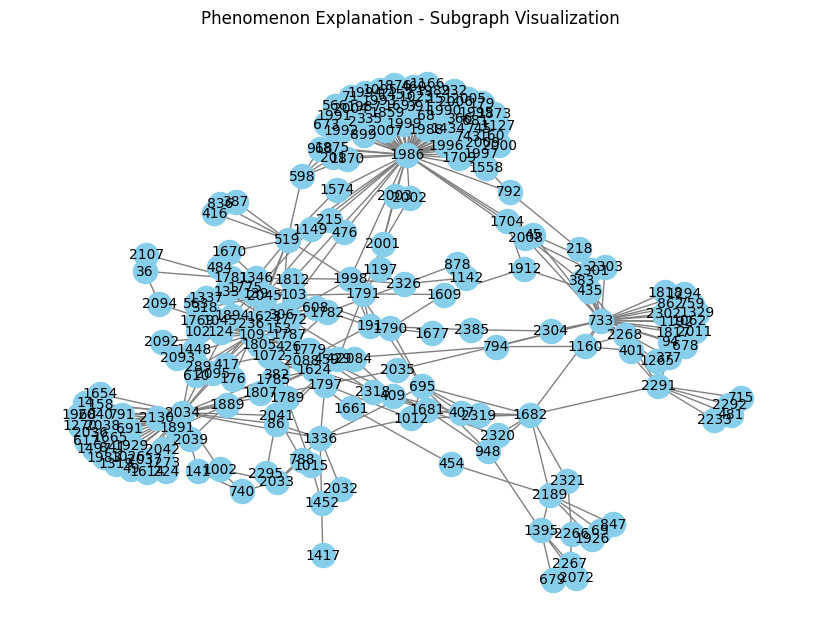

Train Explainer:   0%|          | 0/60 [00:00<?, ?it/s]

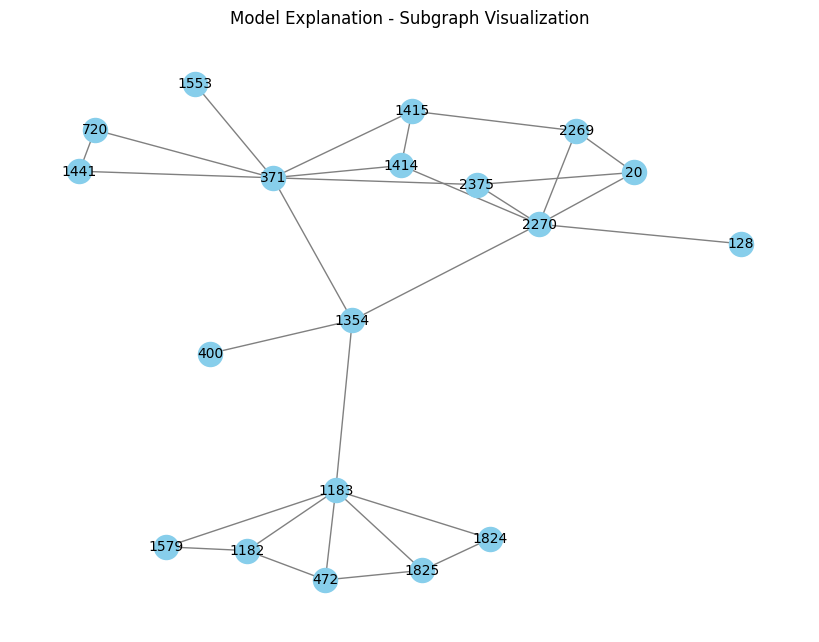

Train Explainer:   2%|▏         | 1/60 [00:01<01:48,  1.85s/it]

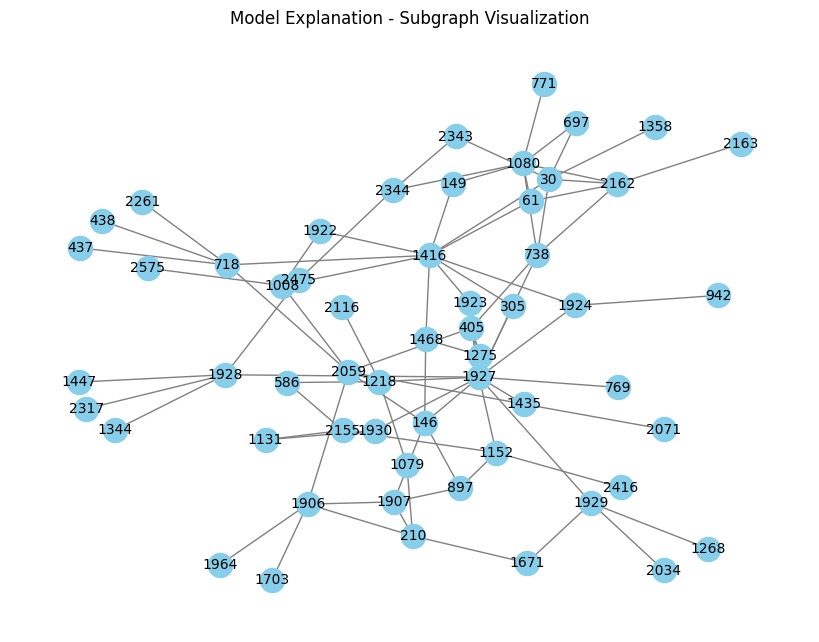

Train Explainer:   3%|▎         | 2/60 [00:03<01:45,  1.83s/it]

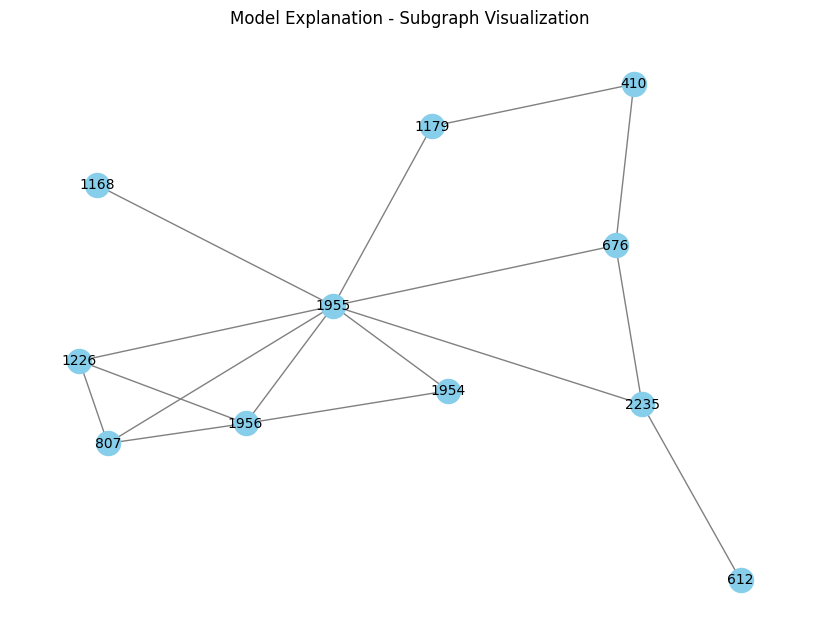

Train Explainer:   5%|▌         | 3/60 [00:05<01:41,  1.78s/it]

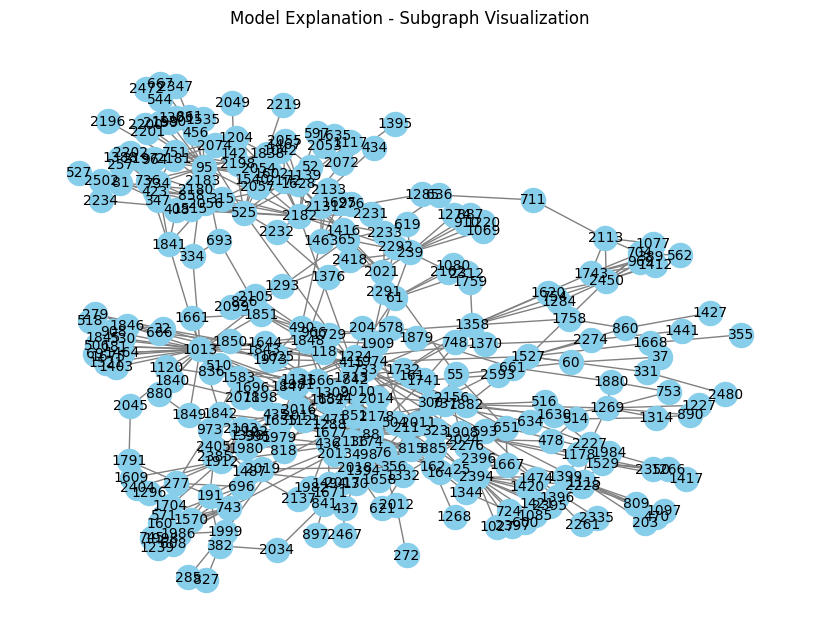

Train Explainer:   7%|▋         | 4/60 [00:07<01:54,  2.04s/it]

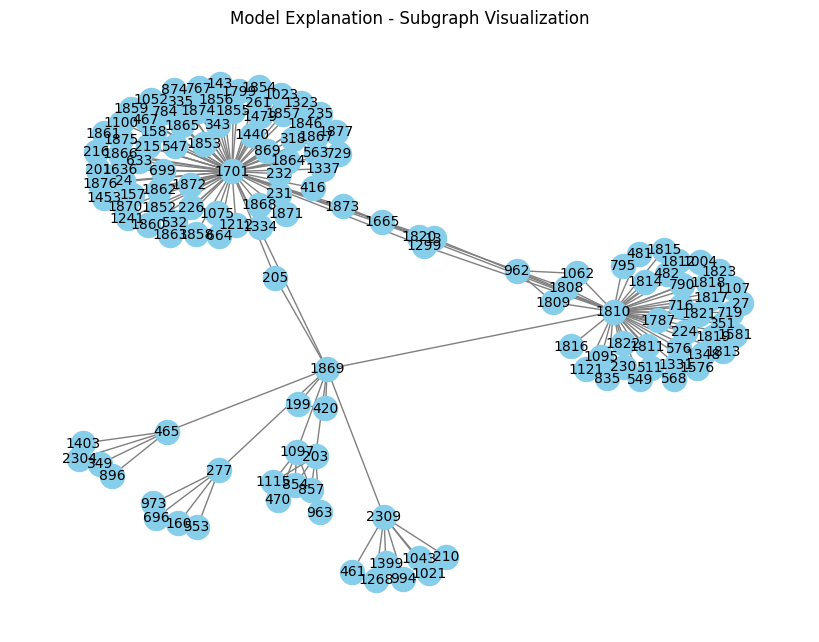

Train Explainer:   8%|▊         | 5/60 [00:10<01:55,  2.11s/it]

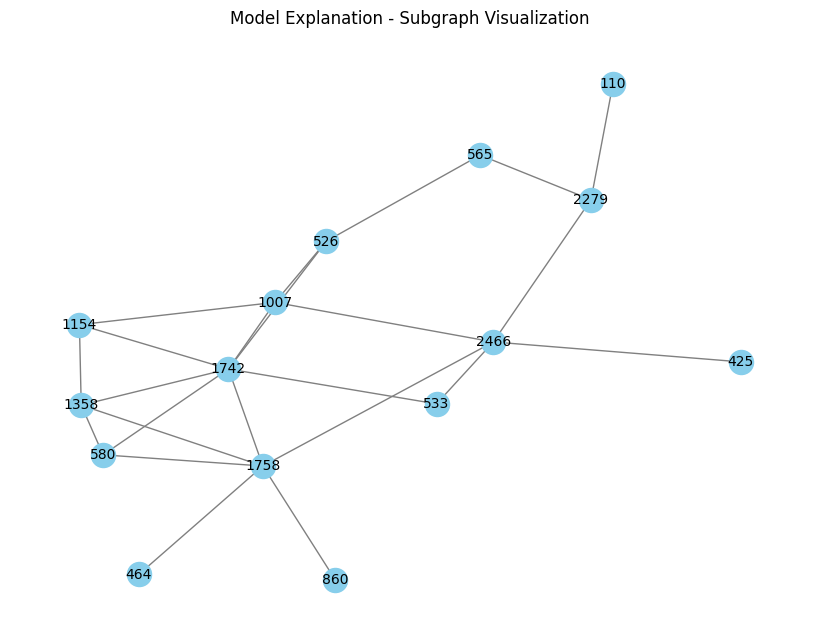

Train Explainer:  10%|█         | 6/60 [00:12<01:54,  2.12s/it]

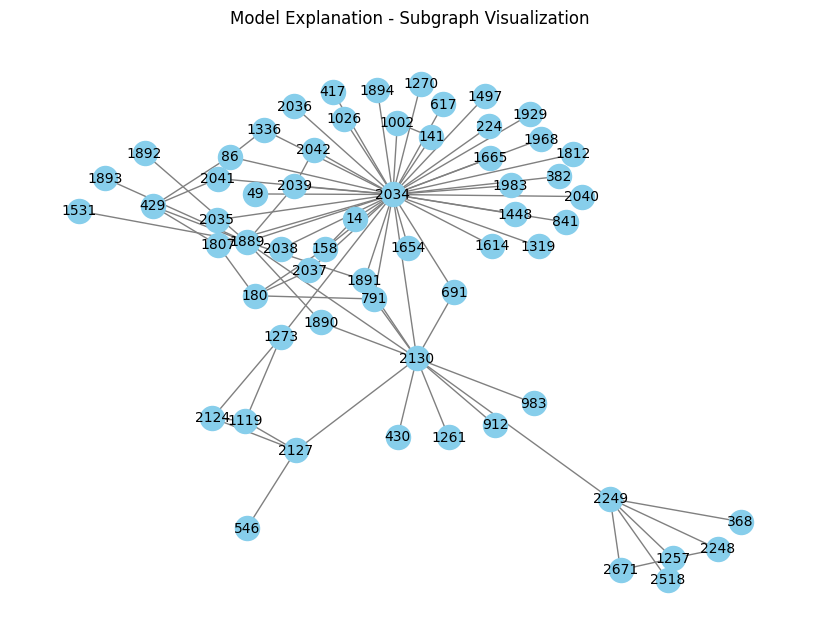

Train Explainer:  12%|█▏        | 7/60 [00:13<01:46,  2.01s/it]

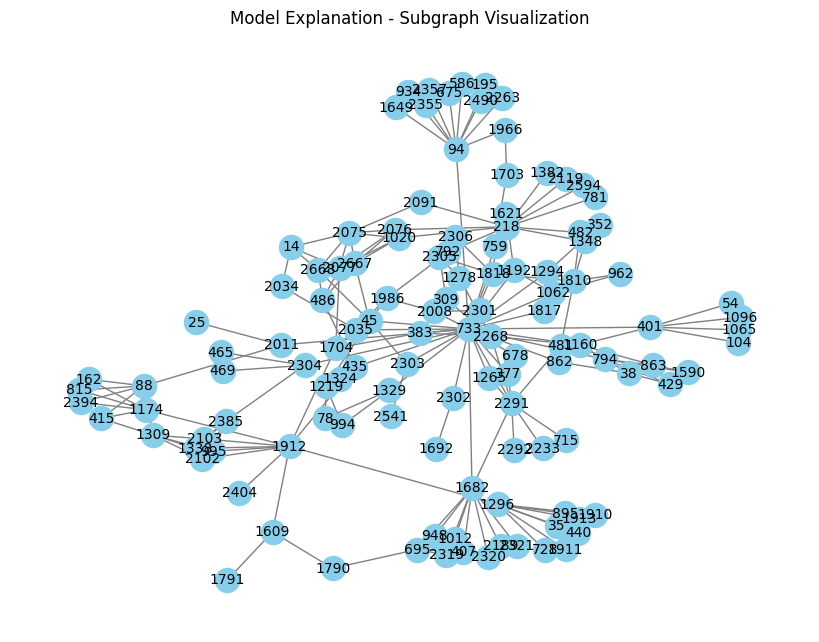

Train Explainer:  13%|█▎        | 8/60 [00:15<01:43,  1.98s/it]

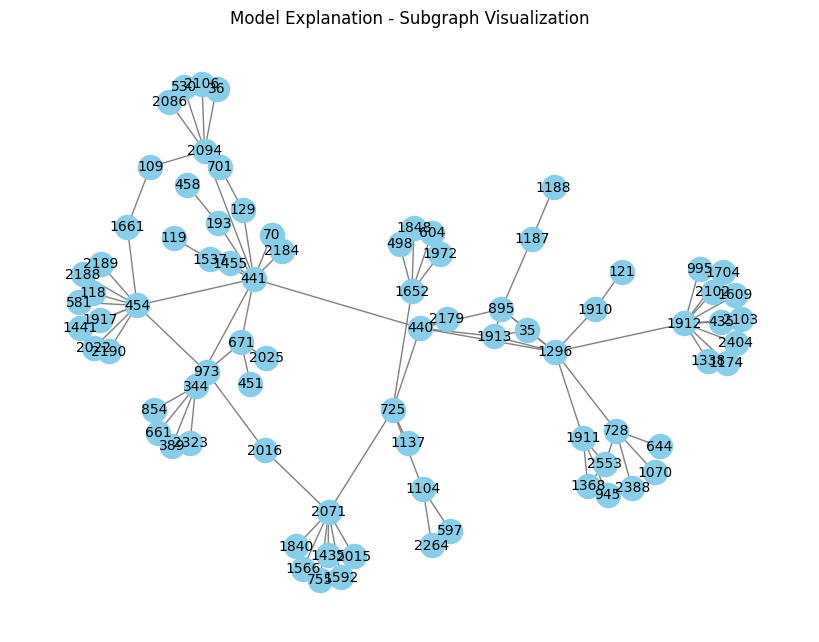

Train Explainer:  15%|█▌        | 9/60 [00:17<01:38,  1.94s/it]

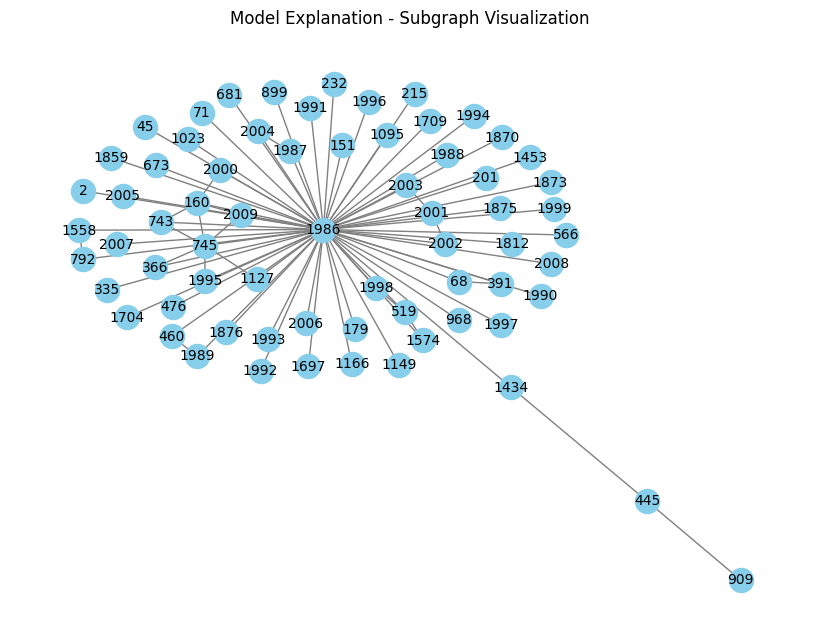

Train Explainer:  17%|█▋        | 10/60 [00:19<01:35,  1.91s/it]

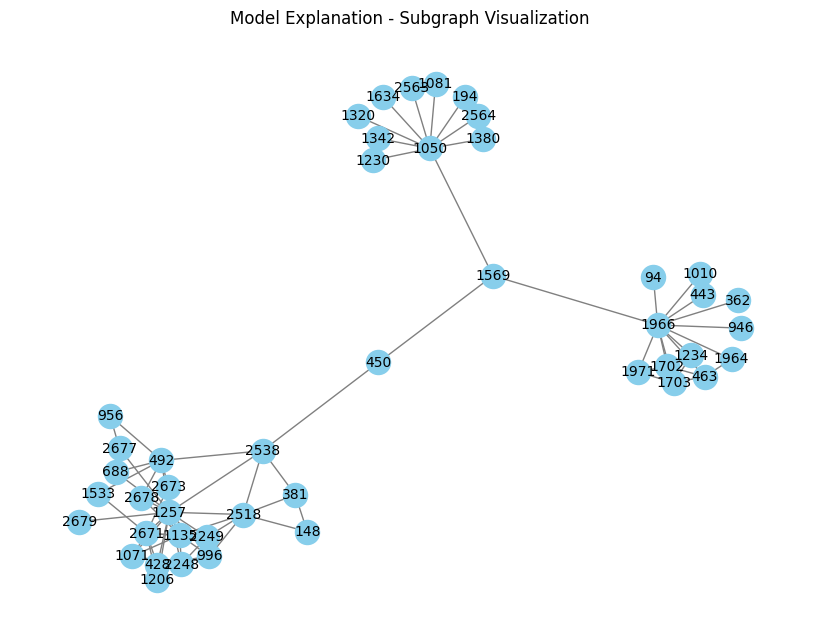

Train Explainer:  18%|█▊        | 11/60 [00:21<01:32,  1.88s/it]

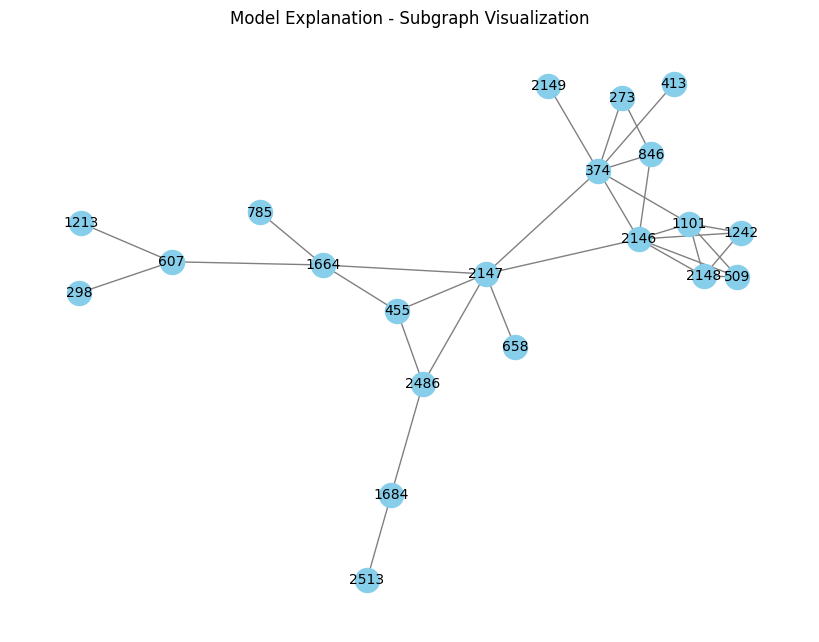

Train Explainer:  20%|██        | 12/60 [00:23<01:32,  1.93s/it]

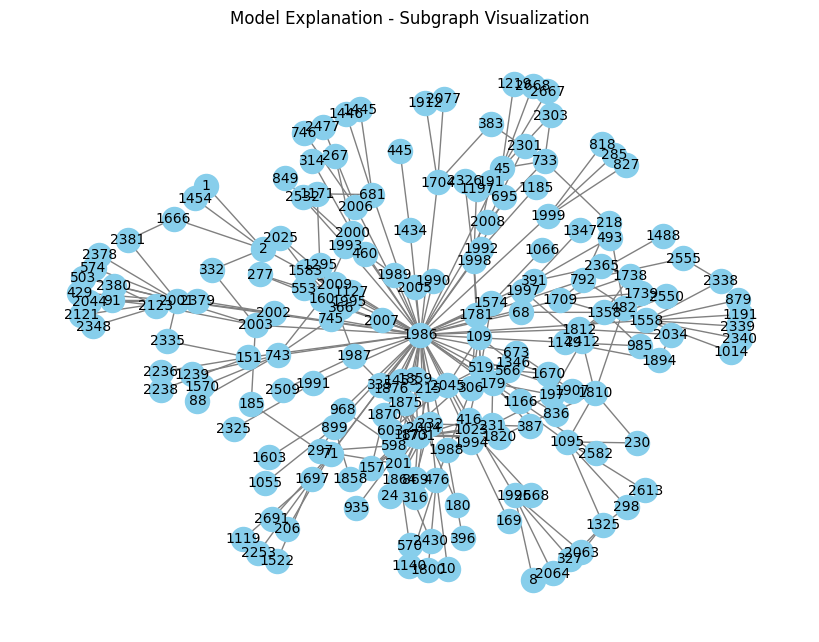

Train Explainer:  22%|██▏       | 13/60 [00:26<01:40,  2.15s/it]

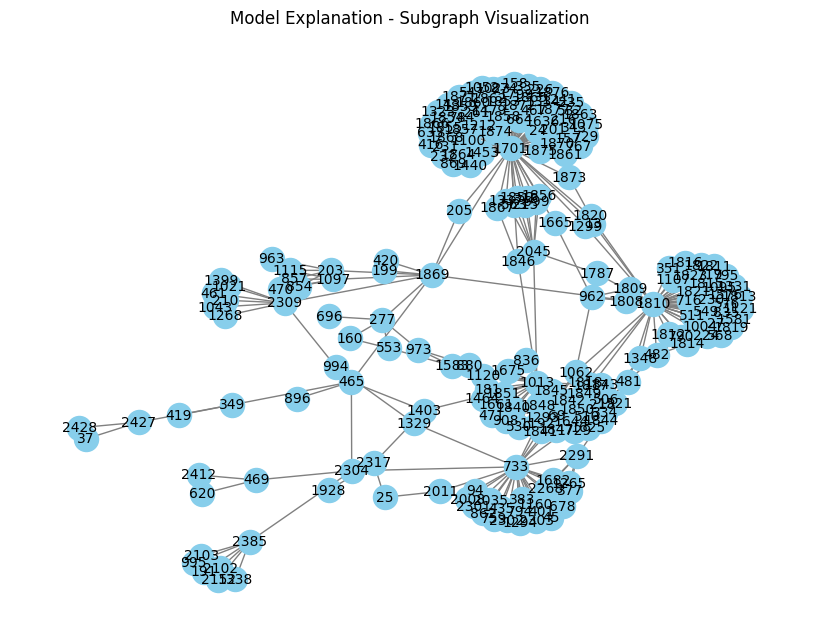

Train Explainer:  23%|██▎       | 14/60 [00:28<01:38,  2.14s/it]

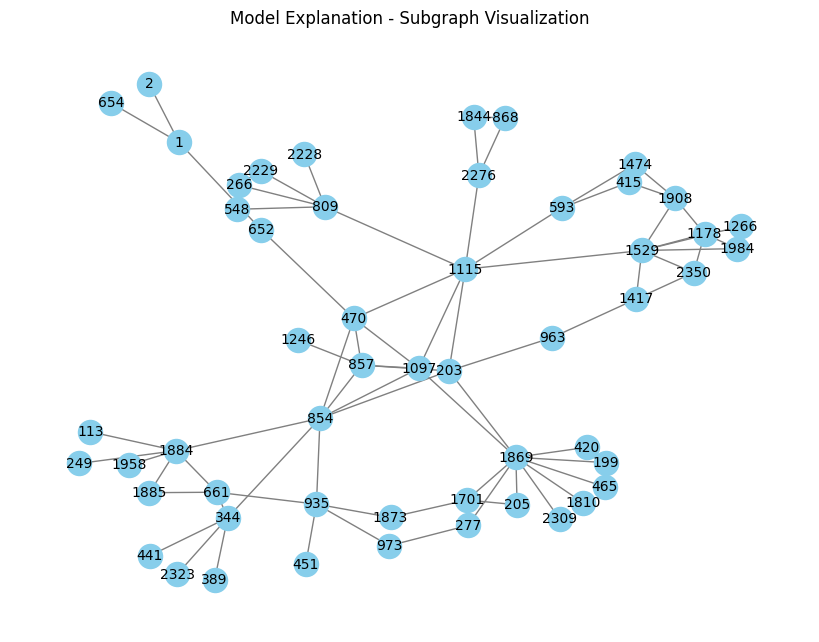

Train Explainer:  25%|██▌       | 15/60 [00:30<01:32,  2.04s/it]

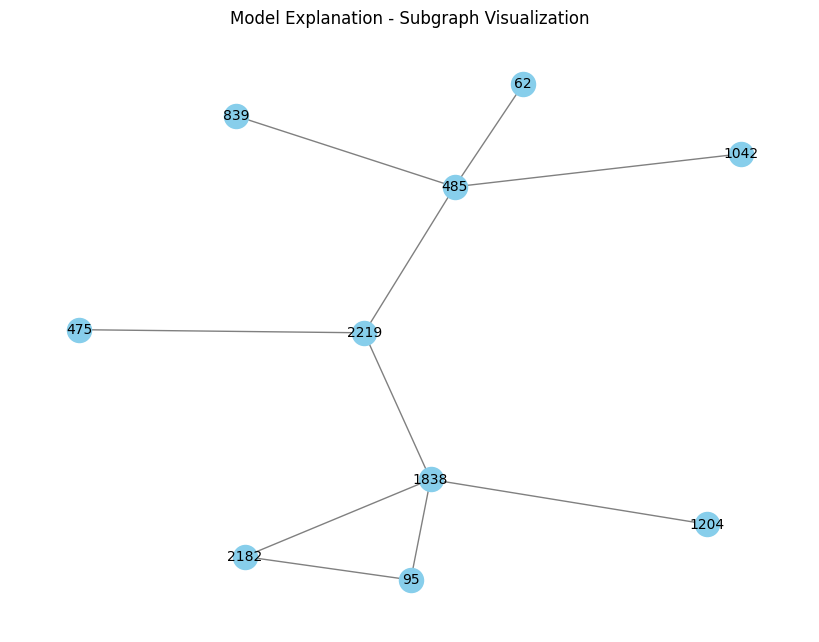

Train Explainer:  27%|██▋       | 16/60 [00:31<01:25,  1.95s/it]

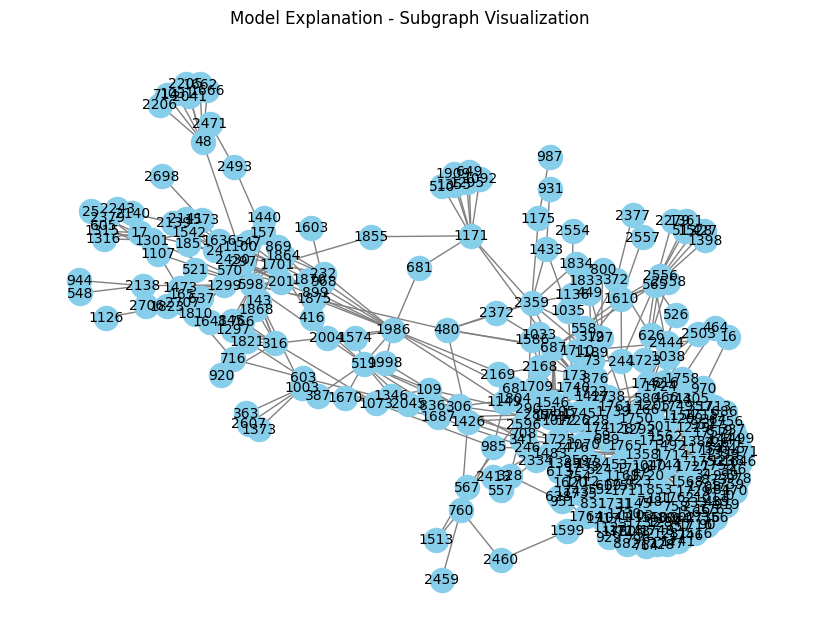

Train Explainer:  28%|██▊       | 17/60 [00:34<01:28,  2.07s/it]

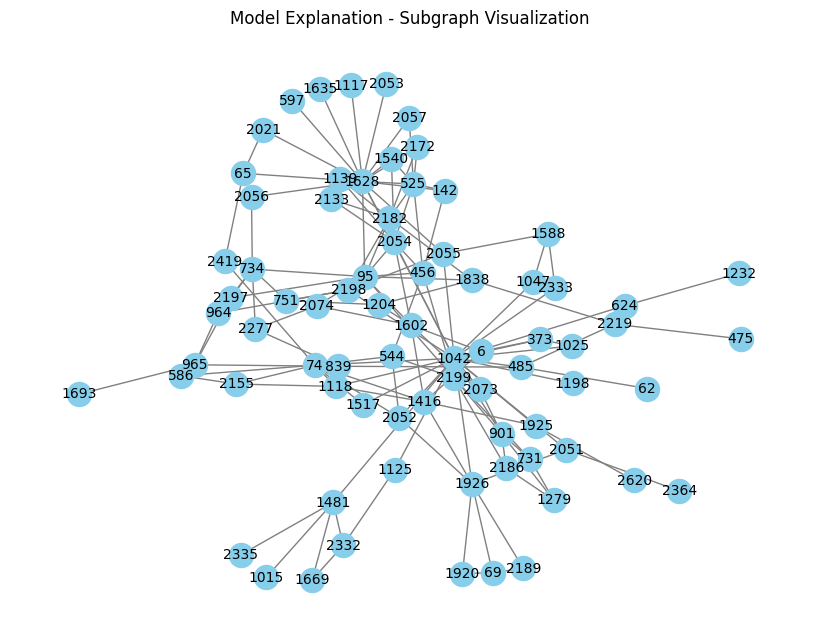

Train Explainer:  30%|███       | 18/60 [00:36<01:27,  2.08s/it]

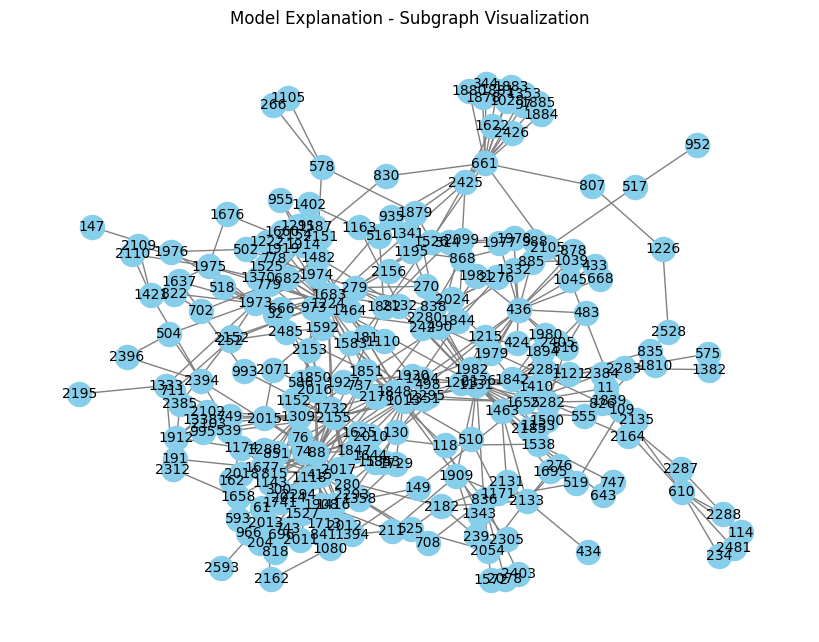

Train Explainer:  32%|███▏      | 19/60 [00:38<01:31,  2.24s/it]

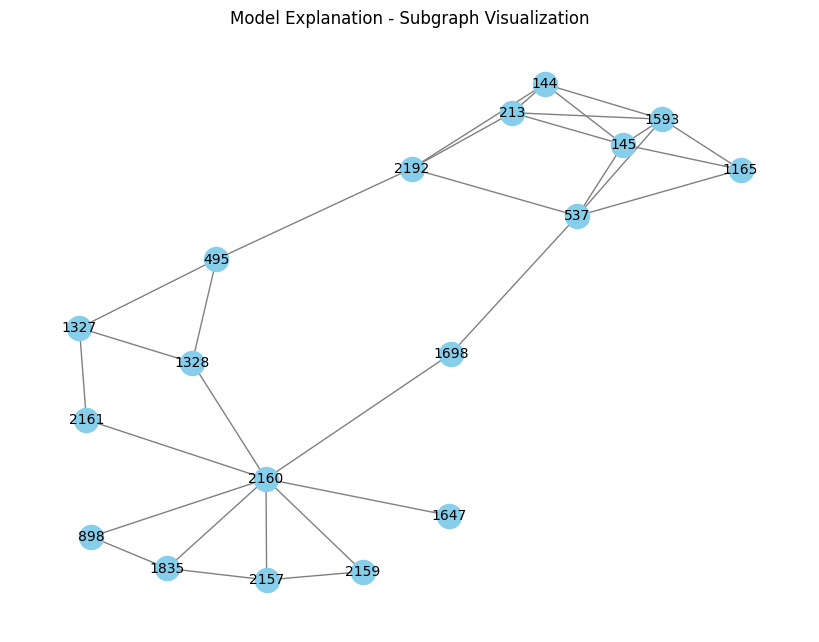

Train Explainer:  33%|███▎      | 20/60 [00:40<01:23,  2.09s/it]

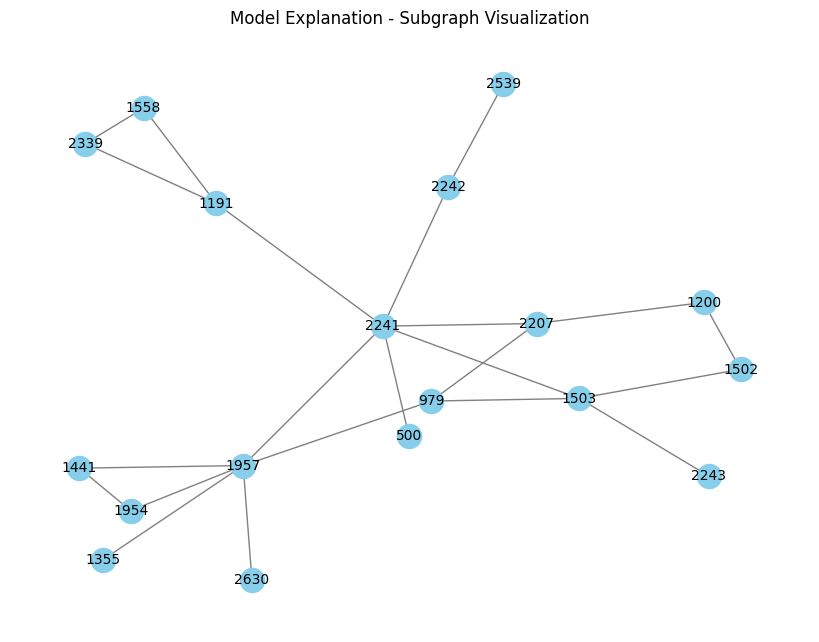

Train Explainer:  35%|███▌      | 21/60 [00:42<01:17,  1.98s/it]

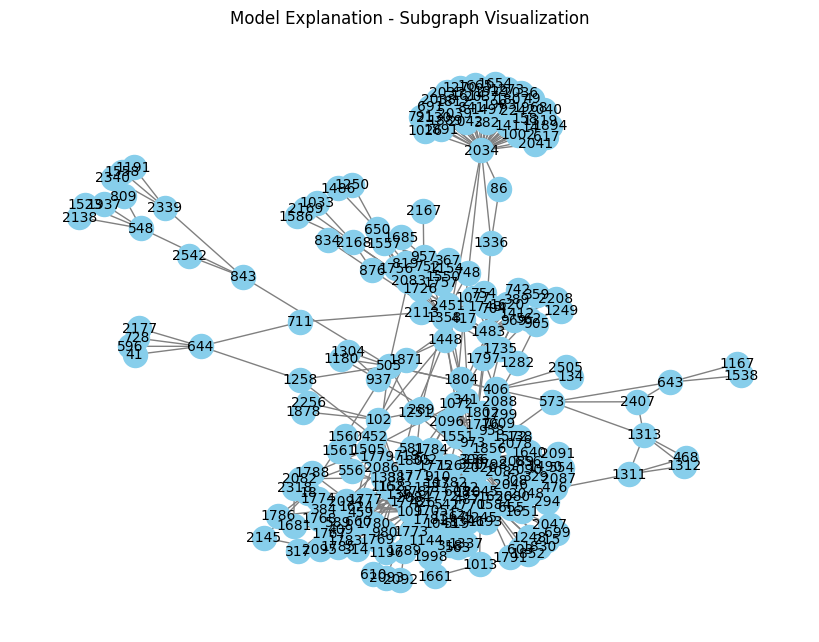

Train Explainer:  37%|███▋      | 22/60 [00:44<01:20,  2.13s/it]

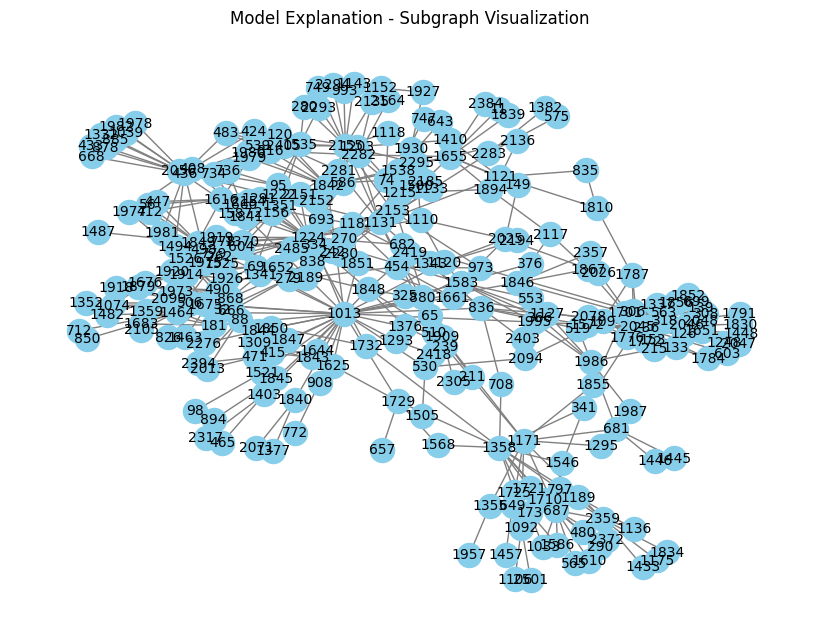

Train Explainer:  38%|███▊      | 23/60 [00:47<01:20,  2.18s/it]

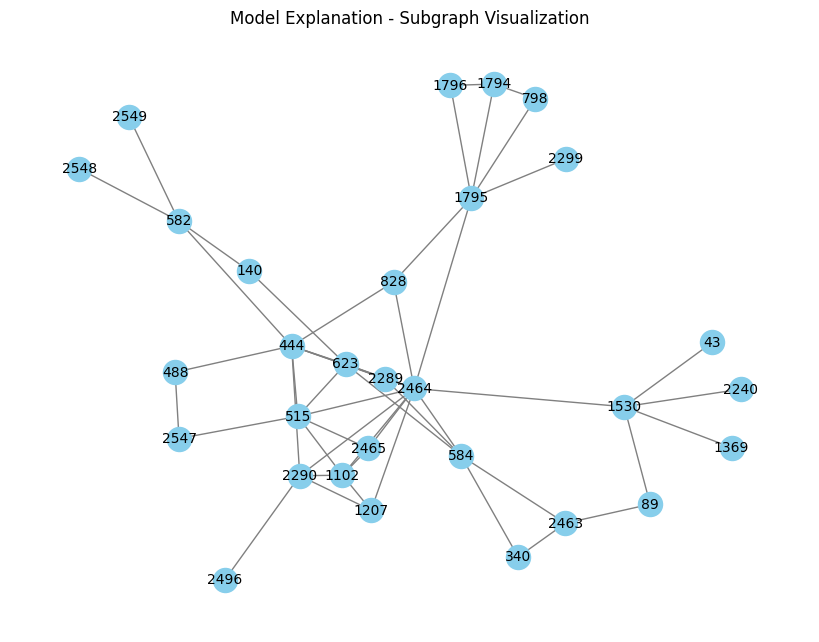

Train Explainer:  40%|████      | 24/60 [00:49<01:16,  2.13s/it]

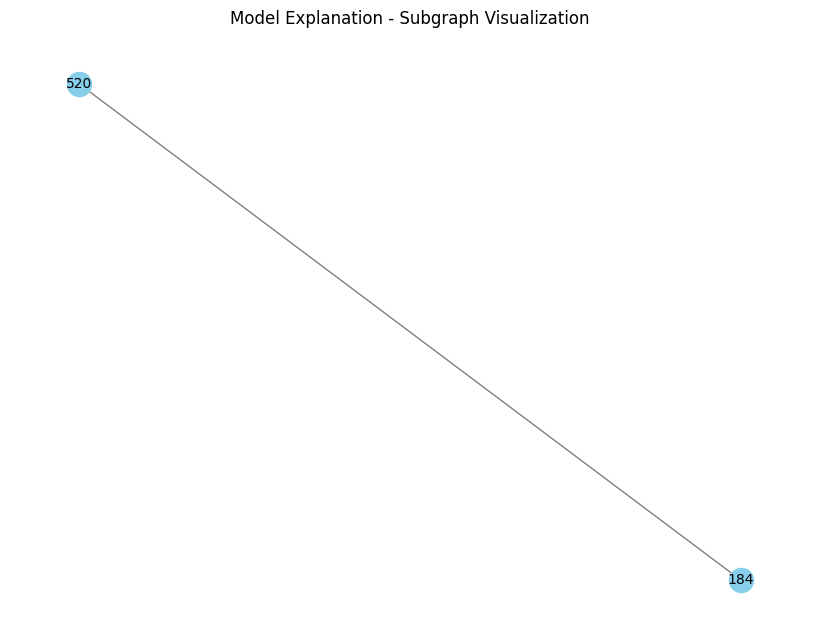

Train Explainer:  42%|████▏     | 25/60 [00:51<01:14,  2.13s/it]

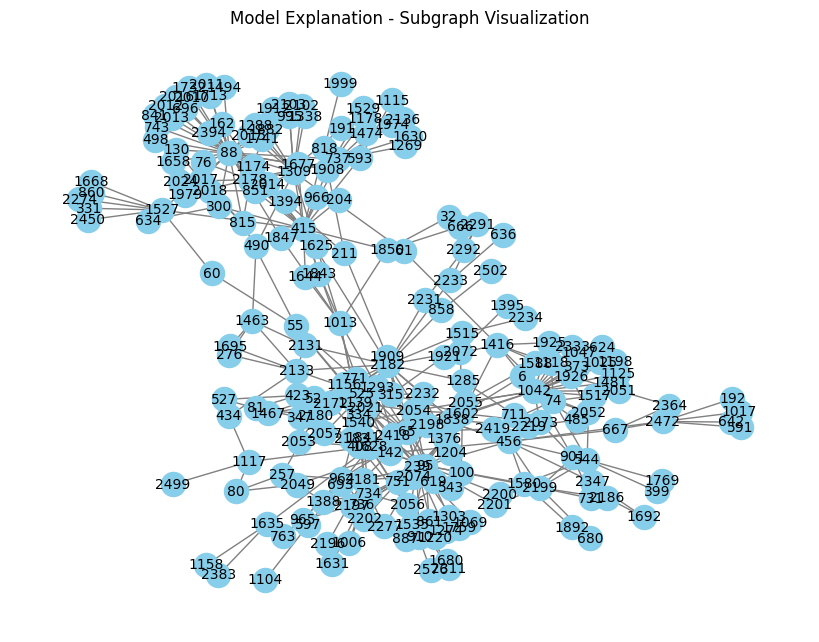

Train Explainer:  43%|████▎     | 26/60 [00:53<01:12,  2.13s/it]

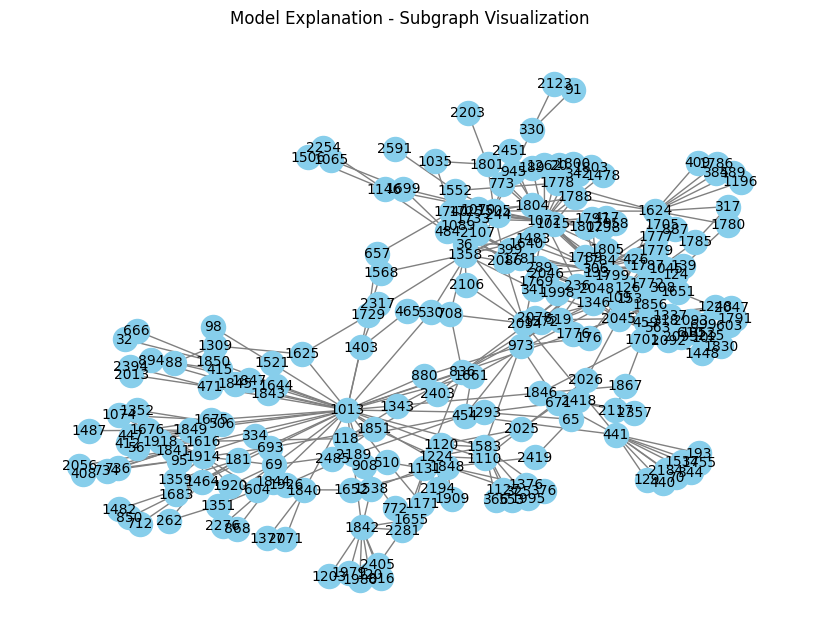

Train Explainer:  45%|████▌     | 27/60 [00:55<01:10,  2.14s/it]

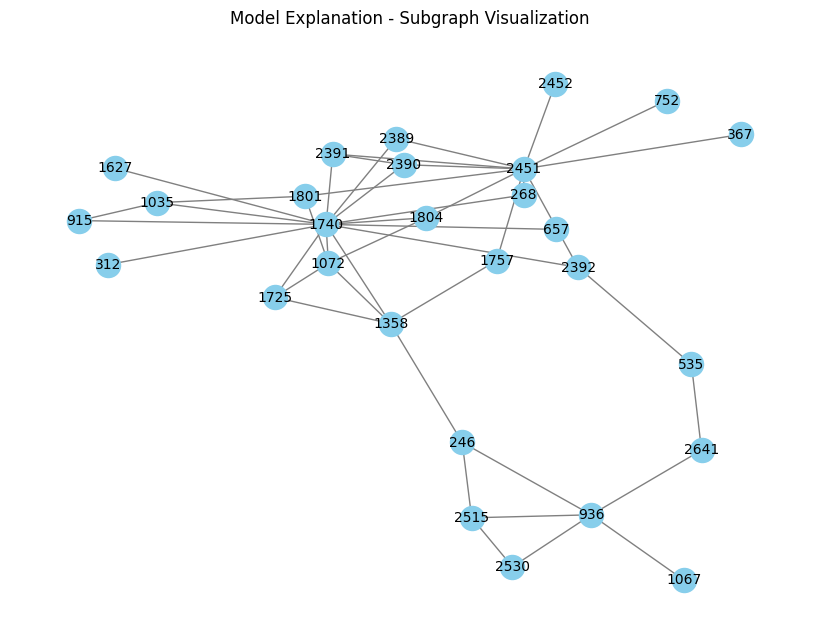

Train Explainer:  47%|████▋     | 28/60 [00:57<01:04,  2.03s/it]

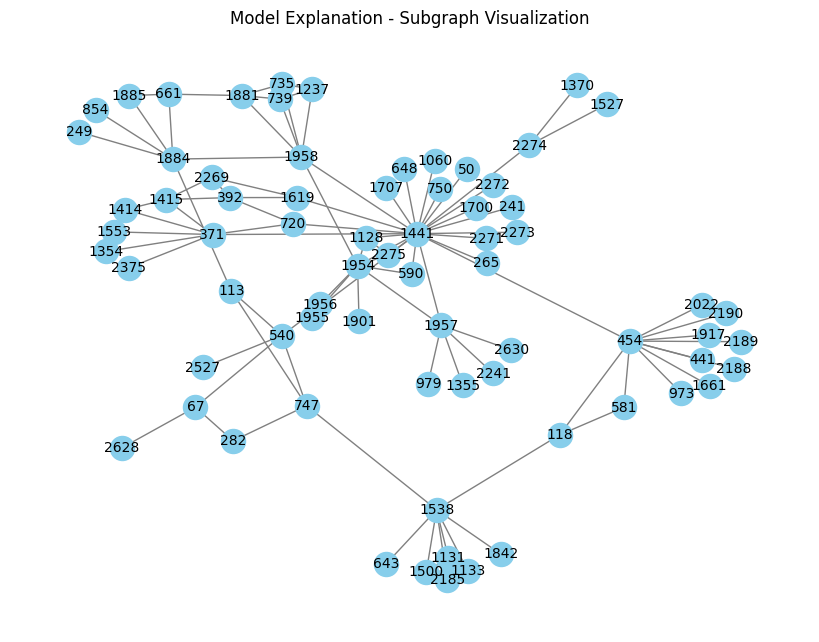

Train Explainer:  48%|████▊     | 29/60 [00:59<01:01,  1.98s/it]

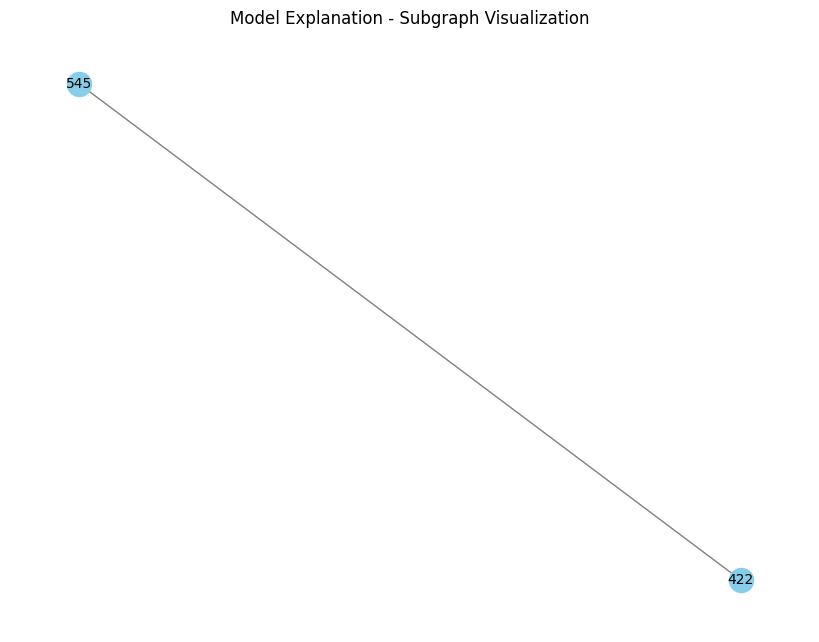

Train Explainer:  50%|█████     | 30/60 [01:00<00:57,  1.90s/it]

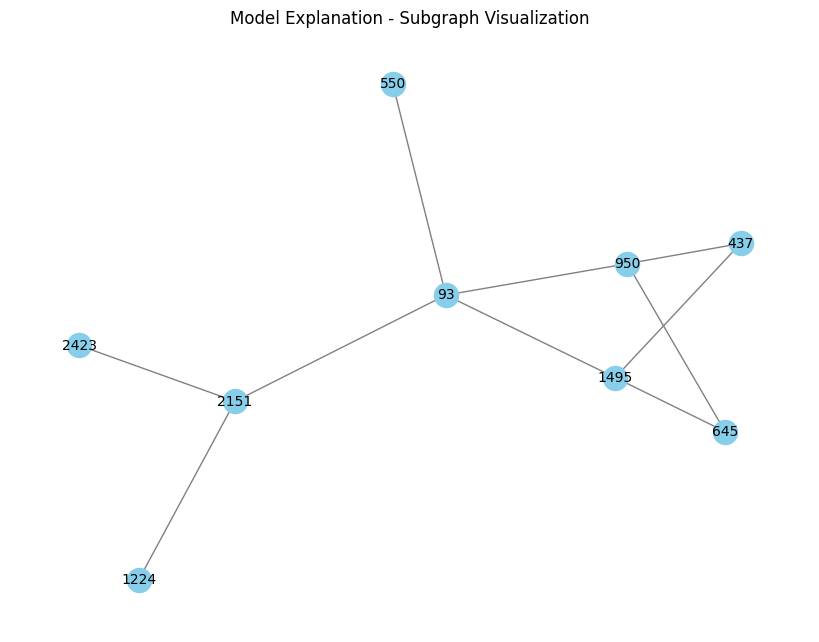

Train Explainer:  52%|█████▏    | 31/60 [01:03<00:57,  1.97s/it]

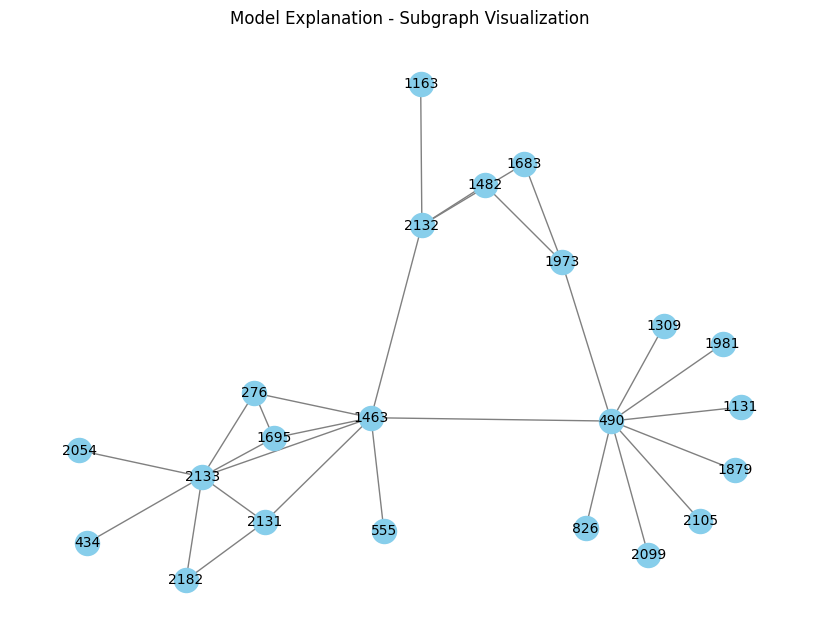

Train Explainer:  53%|█████▎    | 32/60 [01:04<00:55,  1.97s/it]

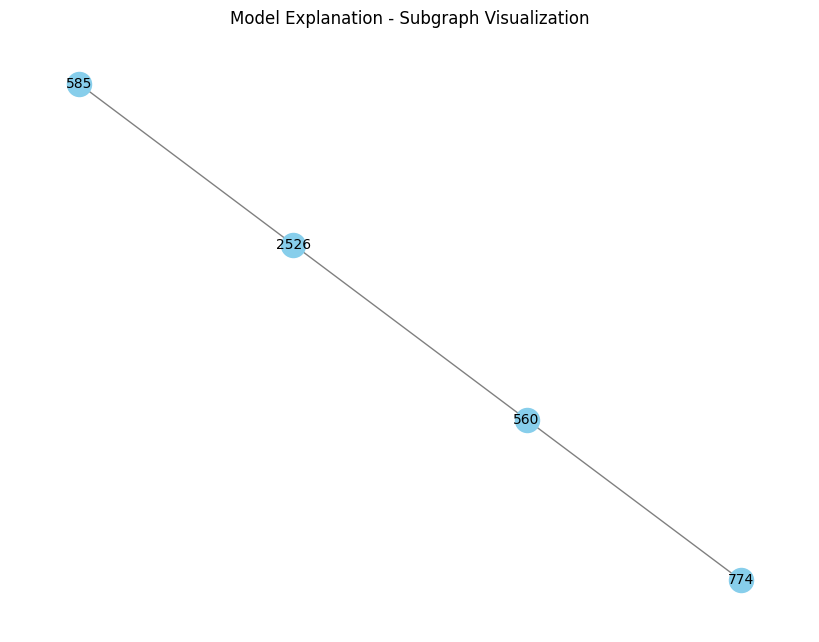

Train Explainer:  55%|█████▌    | 33/60 [01:06<00:51,  1.89s/it]

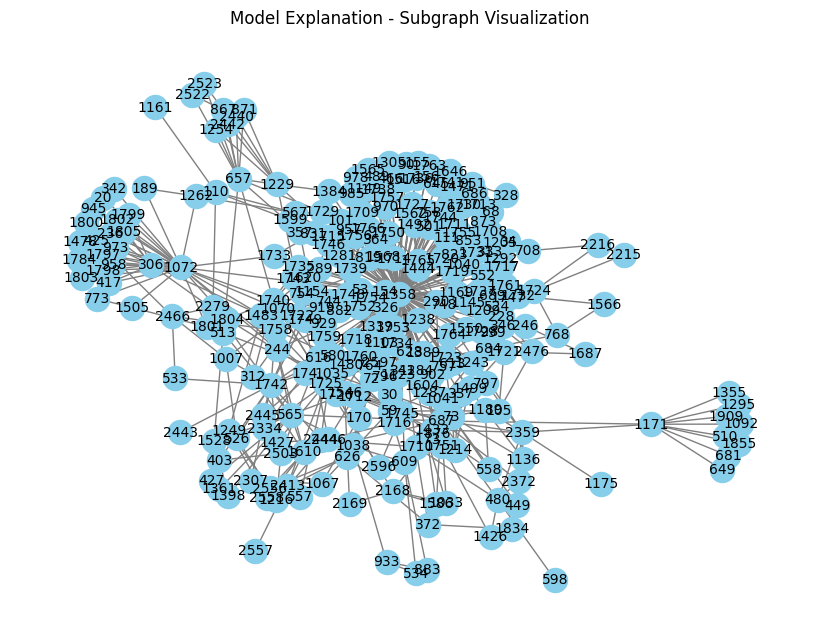

Train Explainer:  57%|█████▋    | 34/60 [01:08<00:52,  2.02s/it]

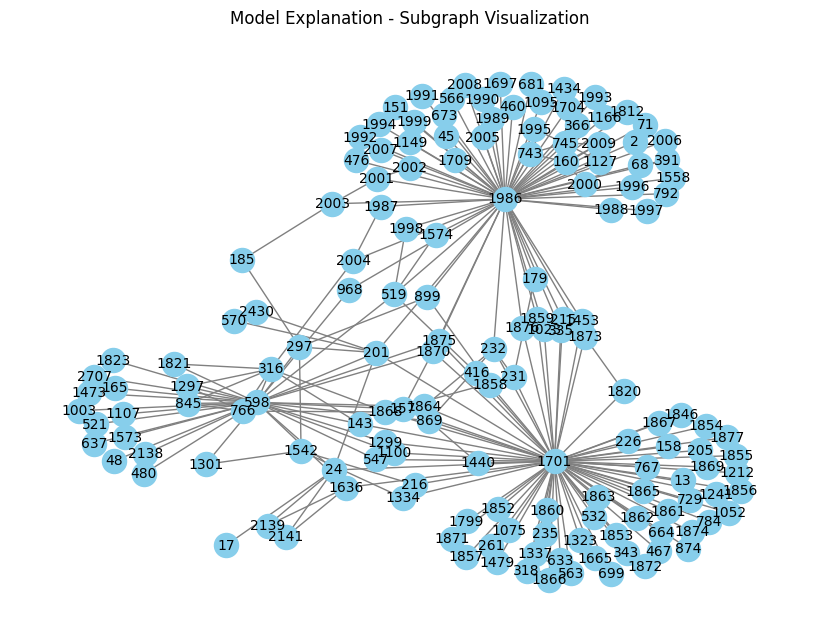

Train Explainer:  58%|█████▊    | 35/60 [01:11<00:52,  2.09s/it]

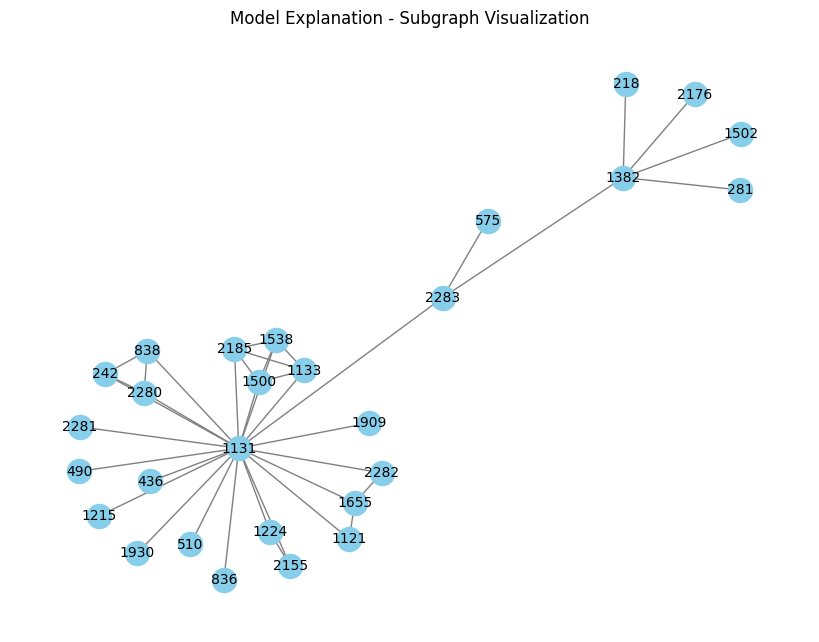

Train Explainer:  60%|██████    | 36/60 [01:13<00:48,  2.00s/it]

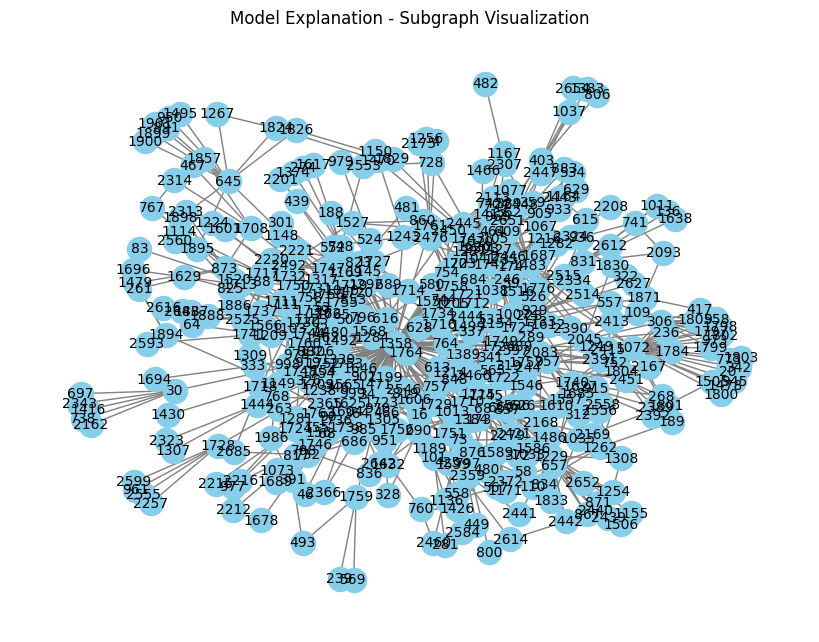

Train Explainer:  62%|██████▏   | 37/60 [01:16<00:55,  2.43s/it]

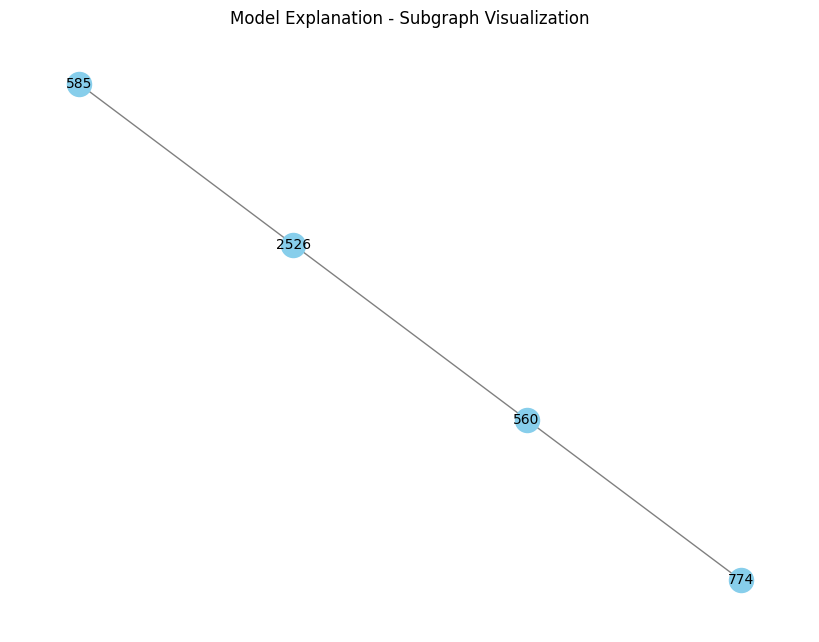

Train Explainer:  63%|██████▎   | 38/60 [01:18<00:49,  2.27s/it]

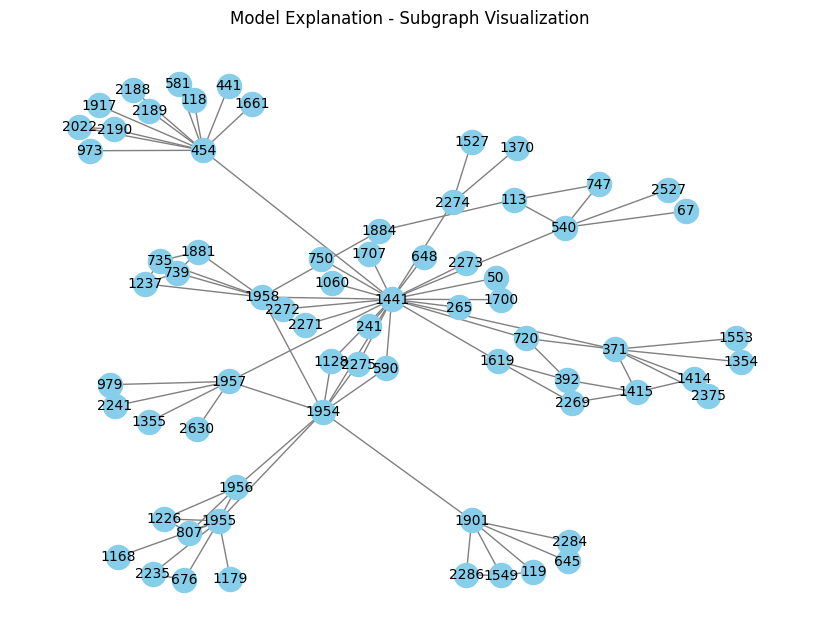

Train Explainer:  65%|██████▌   | 39/60 [01:20<00:44,  2.14s/it]

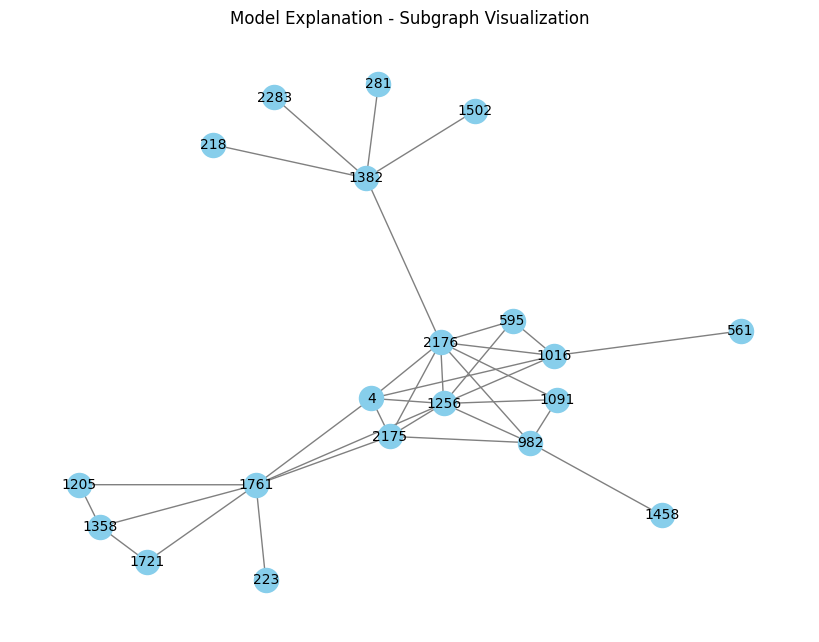

Train Explainer:  67%|██████▋   | 40/60 [01:21<00:40,  2.03s/it]

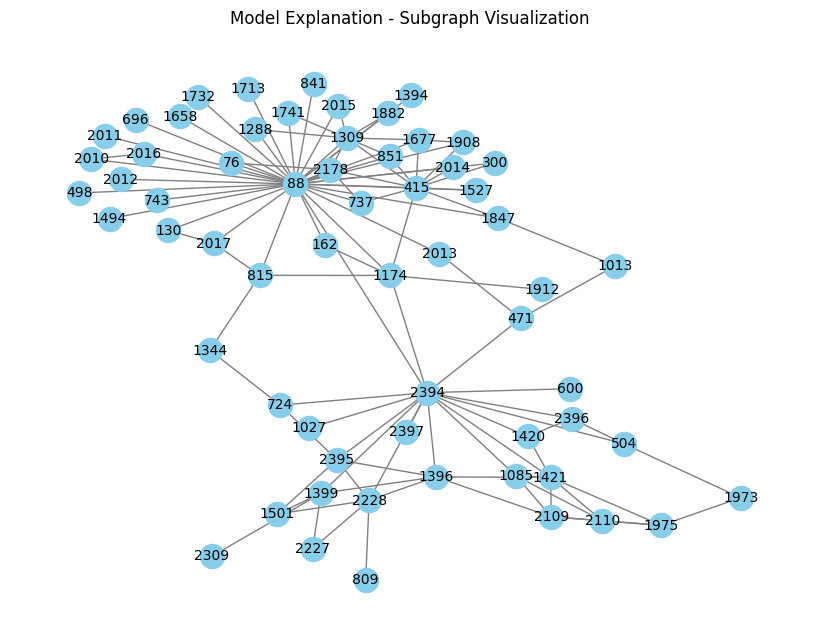

Train Explainer:  68%|██████▊   | 41/60 [01:23<00:37,  1.97s/it]

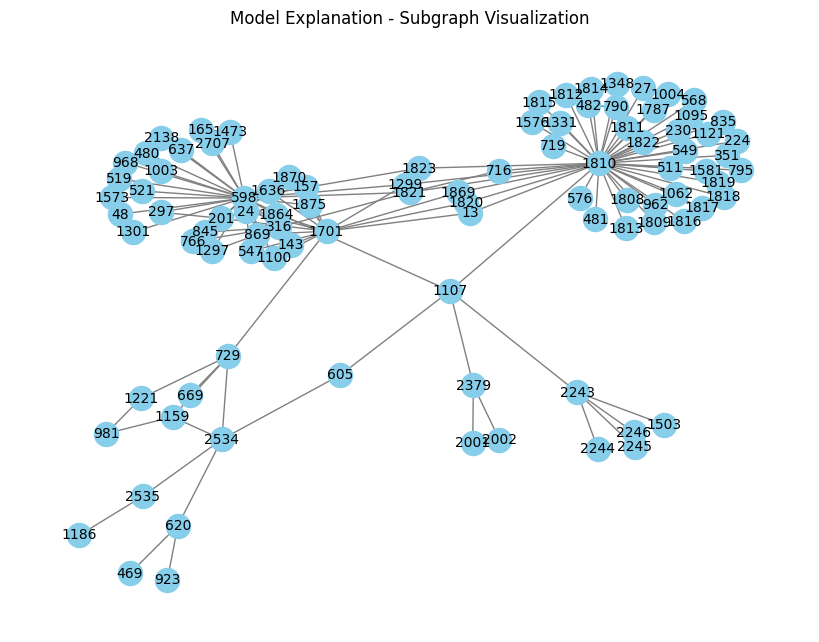

Train Explainer:  70%|███████   | 42/60 [01:25<00:34,  1.94s/it]

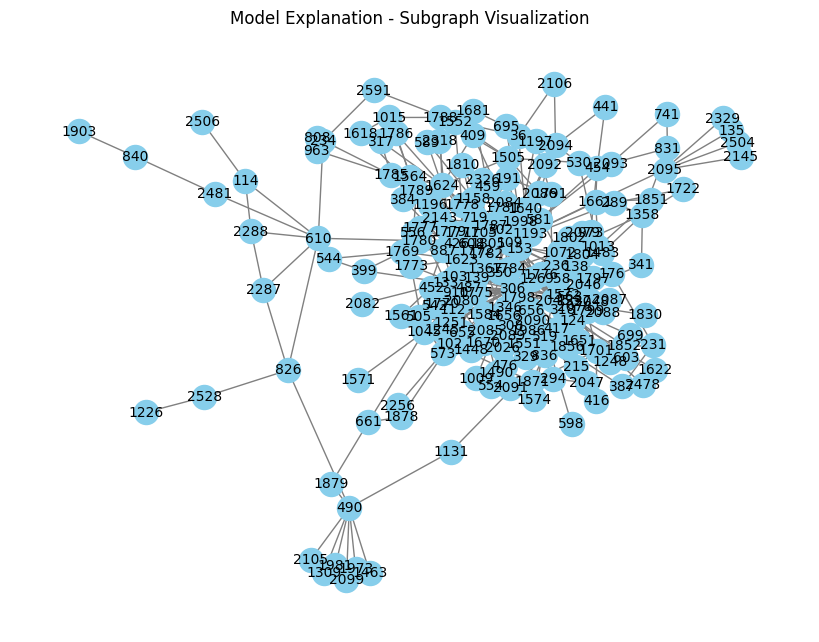

Train Explainer:  72%|███████▏  | 43/60 [01:27<00:34,  2.05s/it]

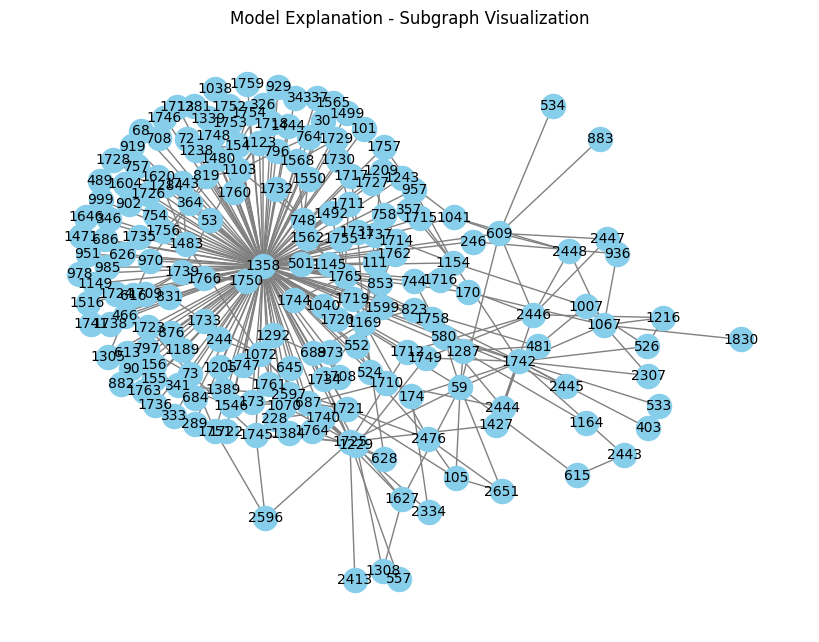

Train Explainer:  73%|███████▎  | 44/60 [01:30<00:35,  2.21s/it]

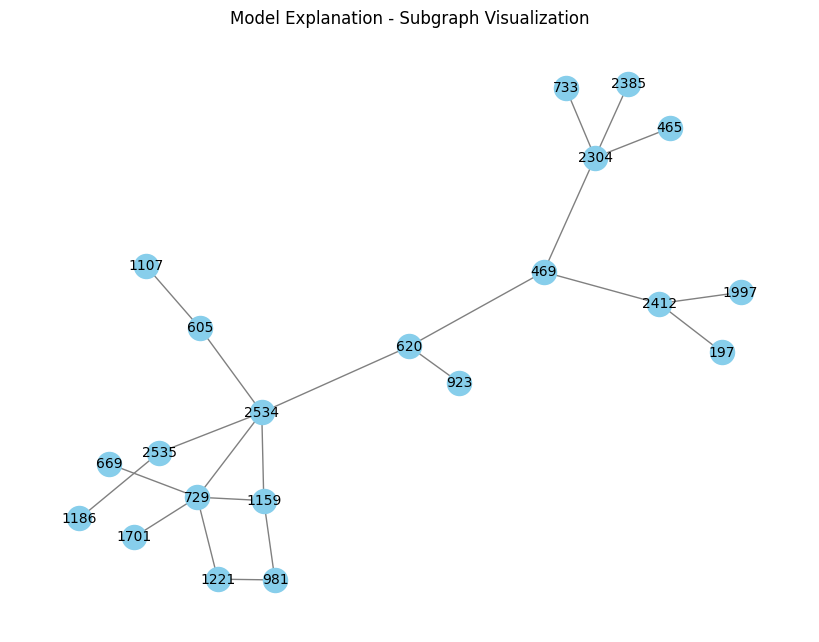

Train Explainer:  75%|███████▌  | 45/60 [01:32<00:31,  2.08s/it]

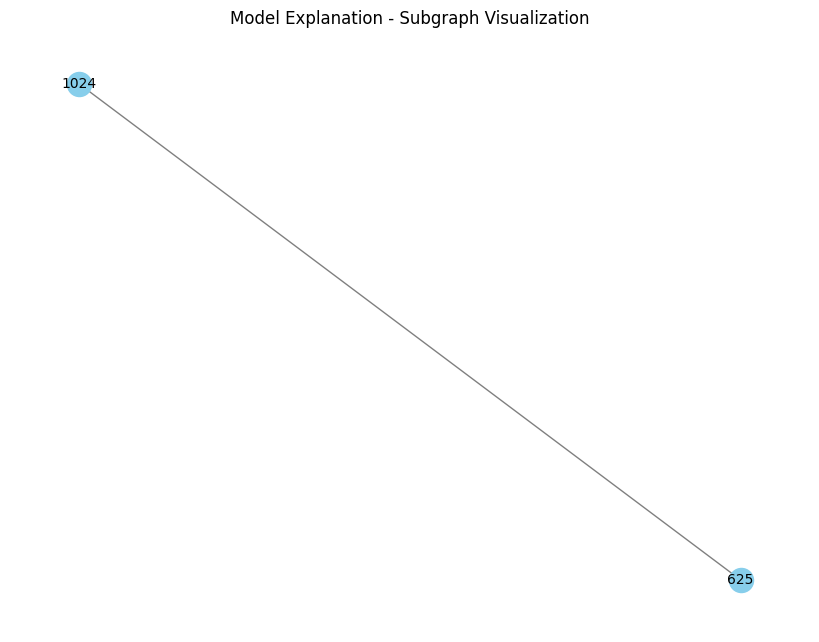

Train Explainer:  77%|███████▋  | 46/60 [01:34<00:28,  2.05s/it]

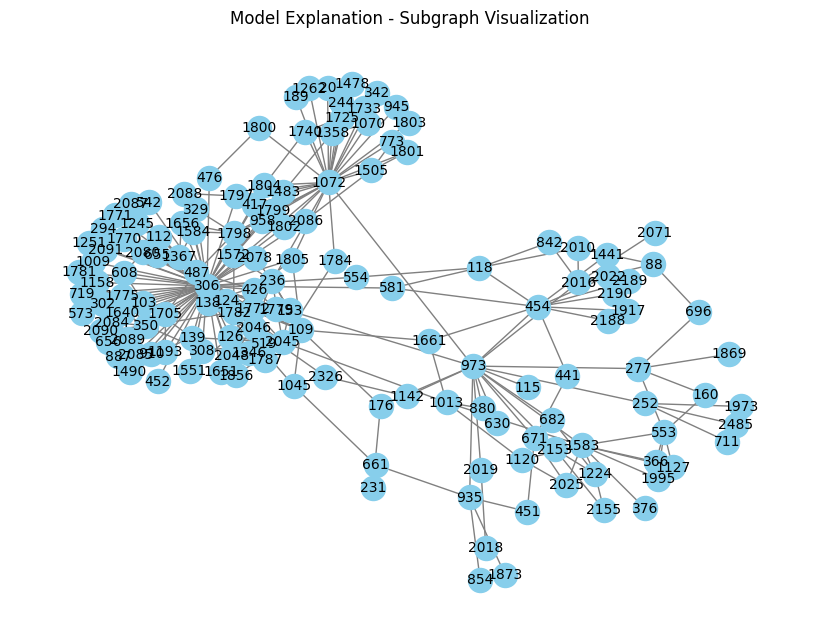

Train Explainer:  78%|███████▊  | 47/60 [01:36<00:26,  2.03s/it]

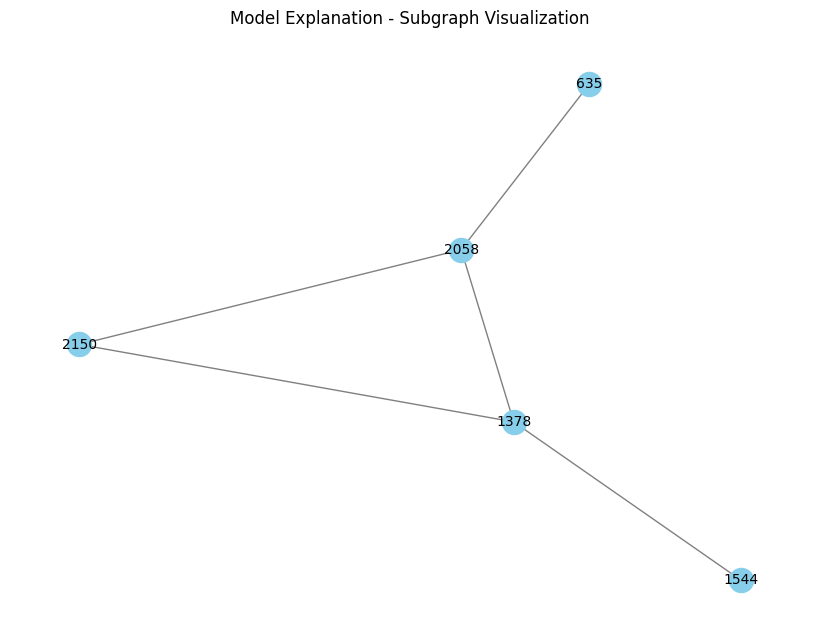

Train Explainer:  80%|████████  | 48/60 [01:38<00:23,  1.97s/it]

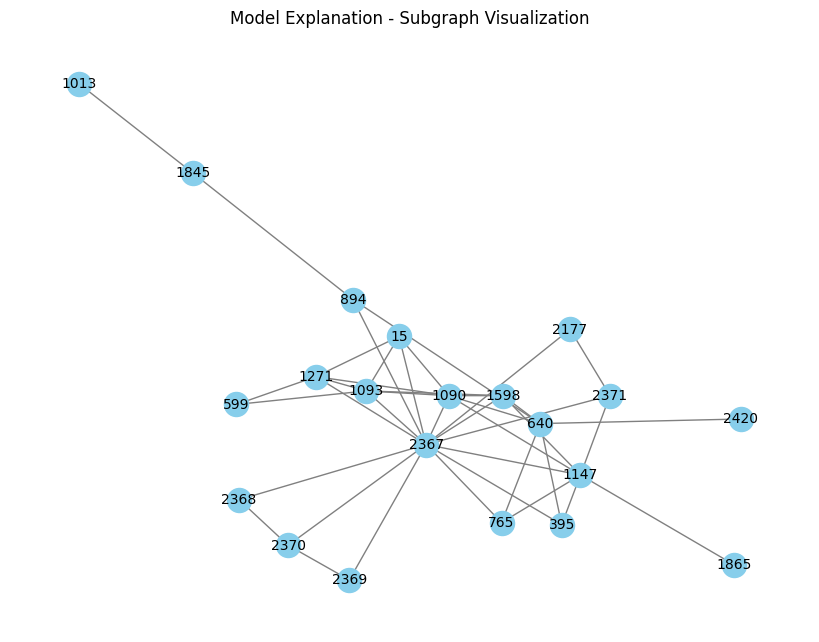

Train Explainer:  82%|████████▏ | 49/60 [01:39<00:21,  1.91s/it]

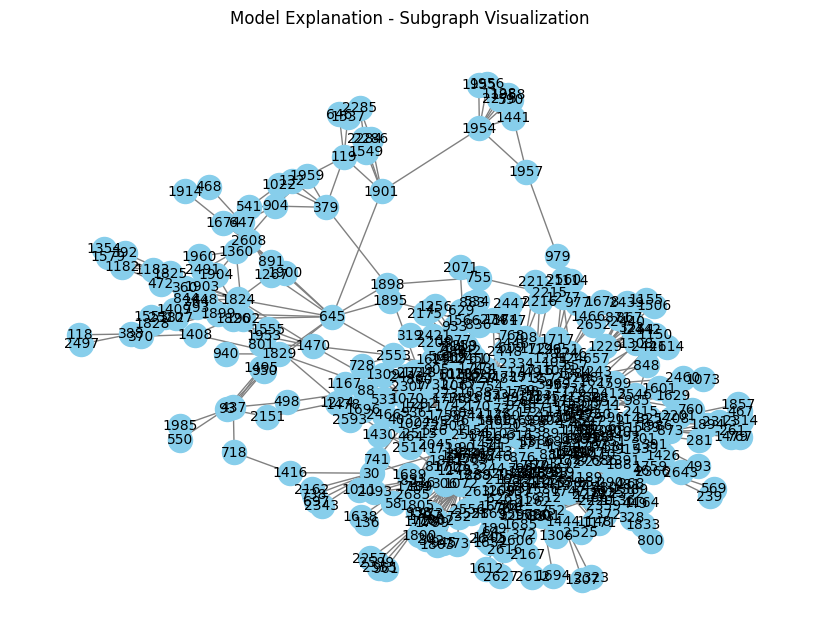

Train Explainer:  83%|████████▎ | 50/60 [01:43<00:24,  2.45s/it]

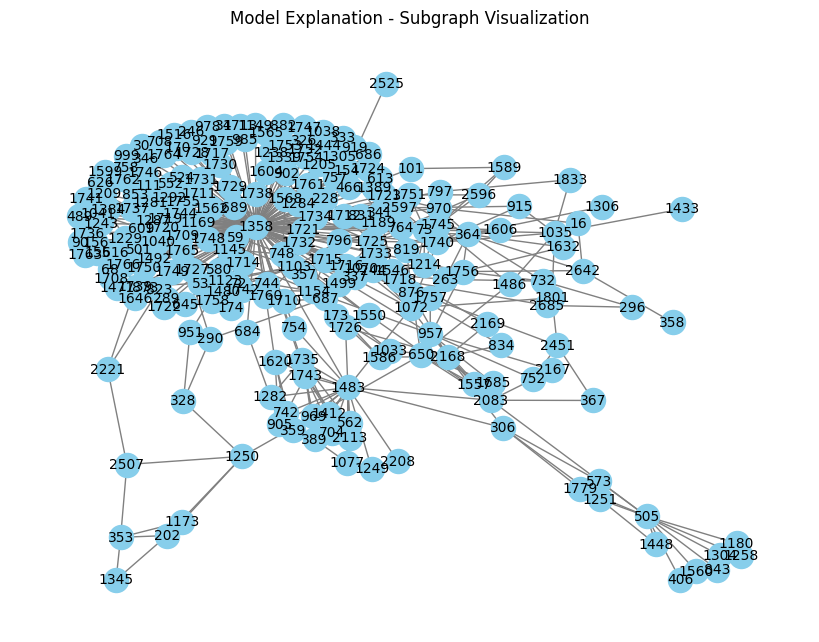

Train Explainer:  85%|████████▌ | 51/60 [01:45<00:21,  2.38s/it]

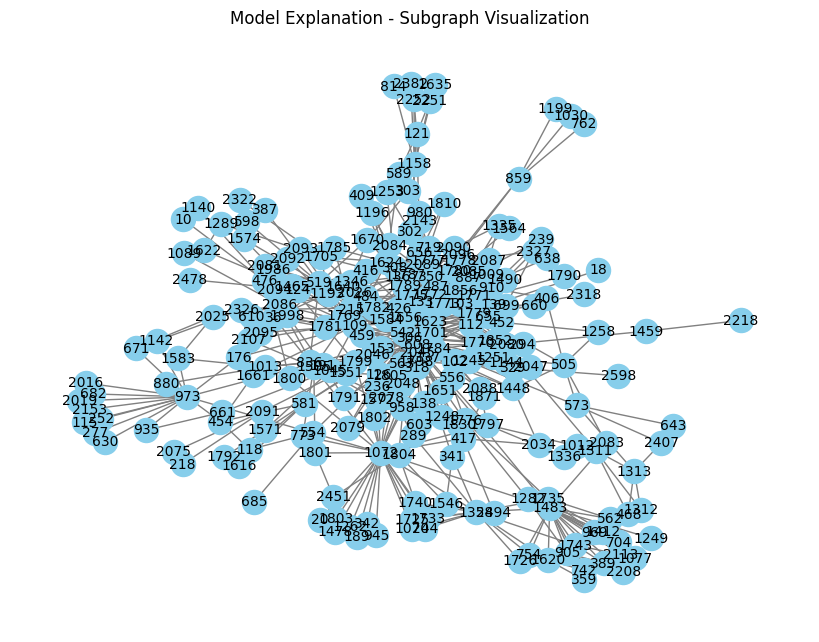

Train Explainer:  87%|████████▋ | 52/60 [01:48<00:18,  2.33s/it]

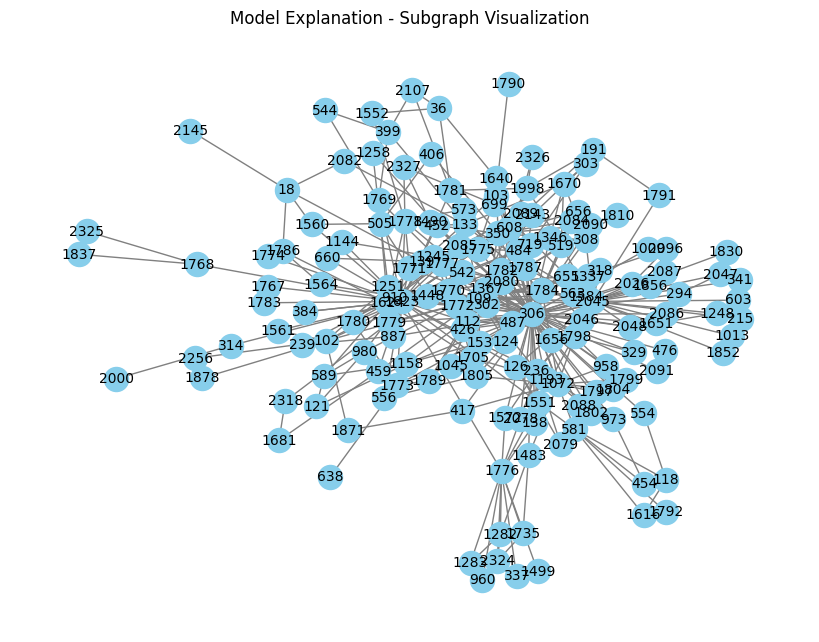

Train Explainer:  88%|████████▊ | 53/60 [01:50<00:16,  2.32s/it]

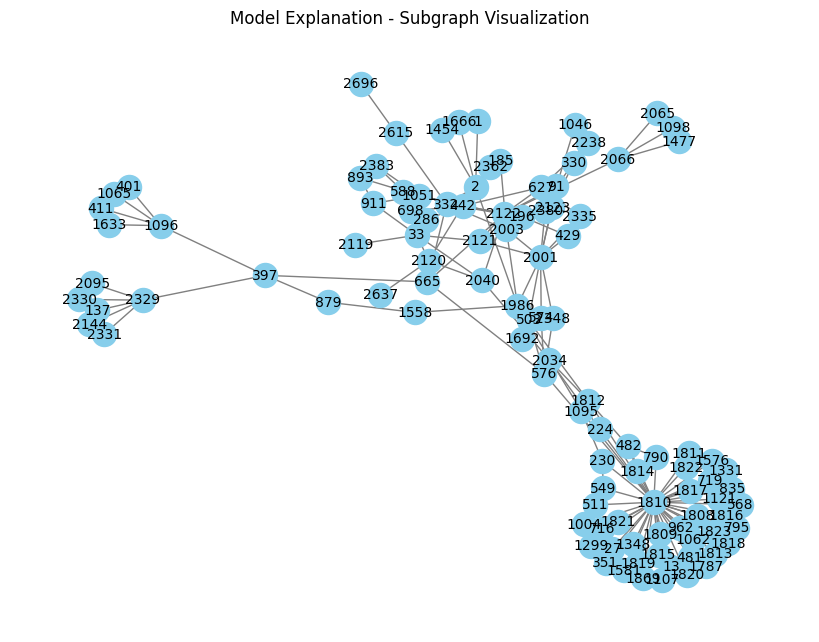

Train Explainer:  90%|█████████ | 54/60 [01:52<00:13,  2.21s/it]

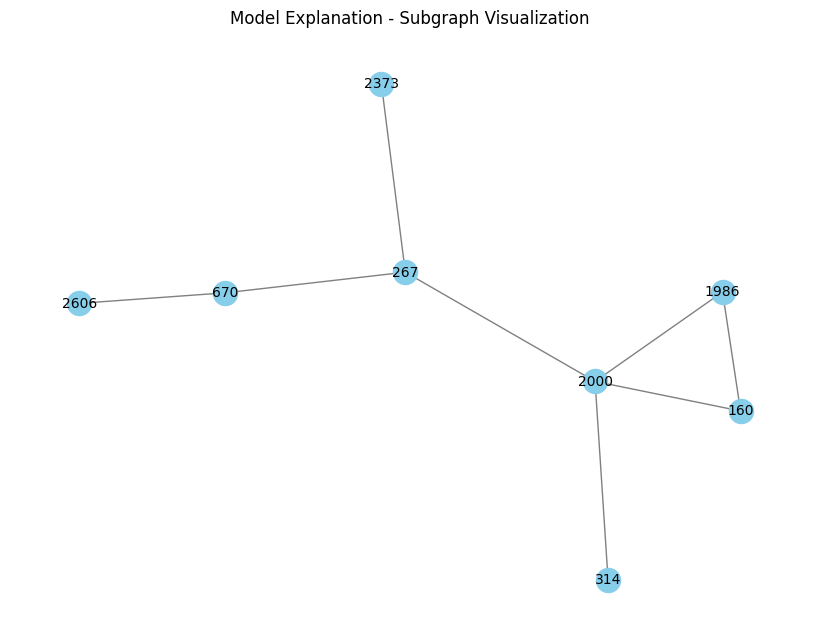

Train Explainer:  92%|█████████▏| 55/60 [01:54<00:10,  2.14s/it]

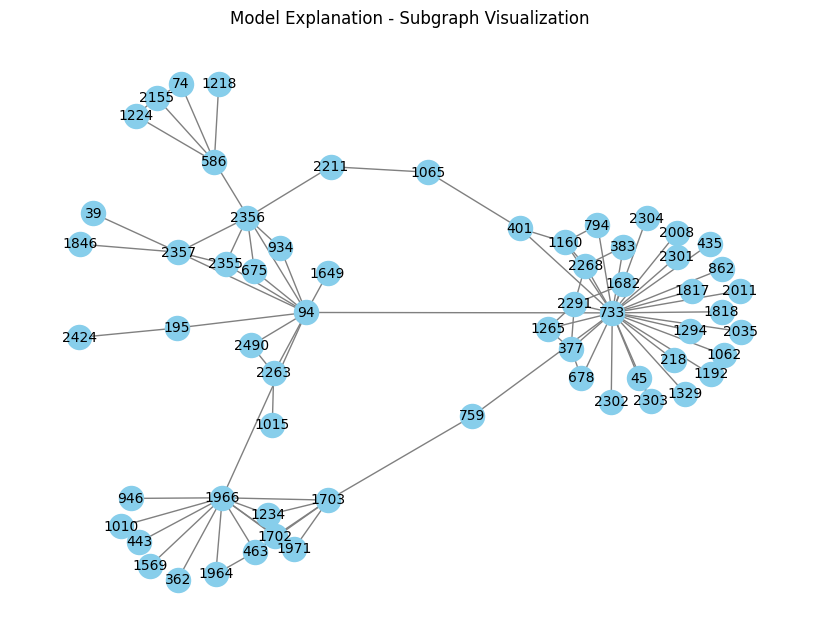

Train Explainer:  93%|█████████▎| 56/60 [01:56<00:08,  2.16s/it]

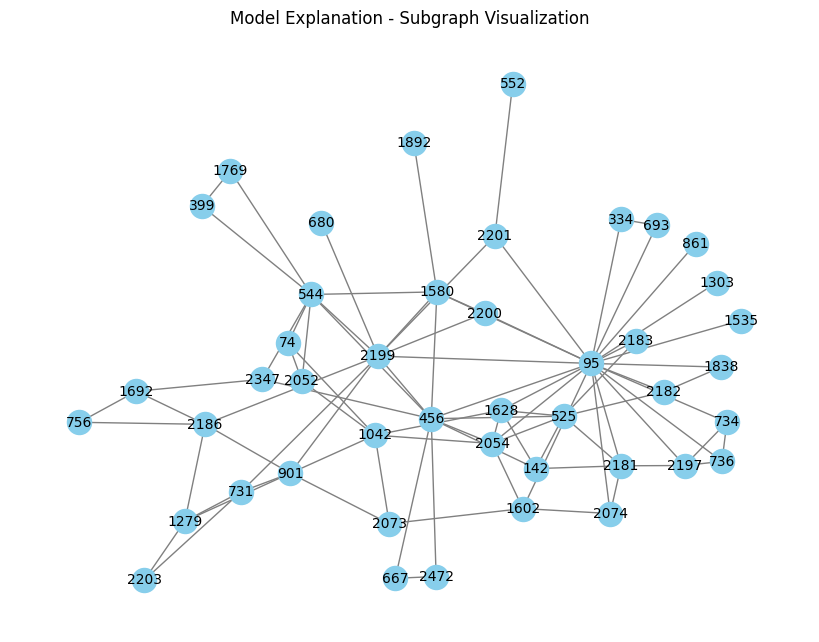

Train Explainer:  95%|█████████▌| 57/60 [01:58<00:06,  2.06s/it]

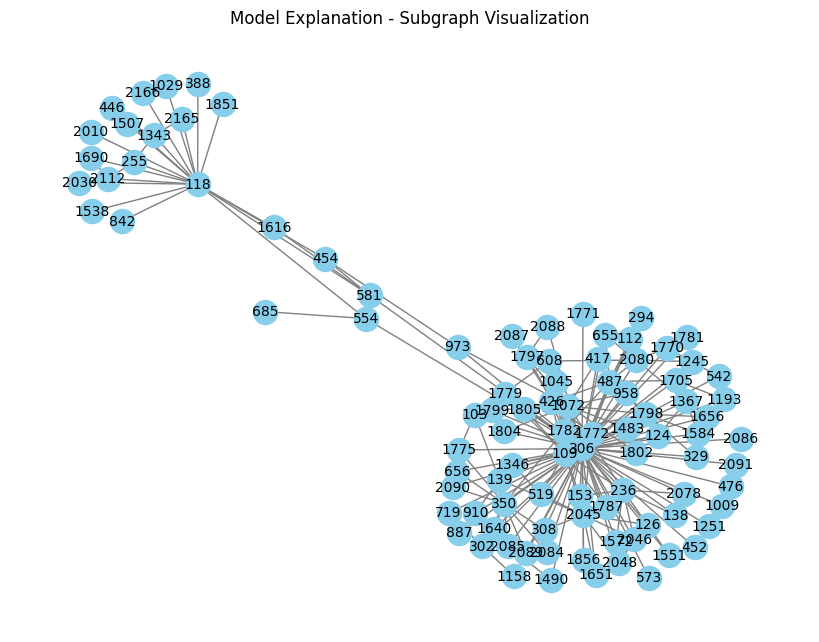

Train Explainer:  97%|█████████▋| 58/60 [02:00<00:04,  2.01s/it]

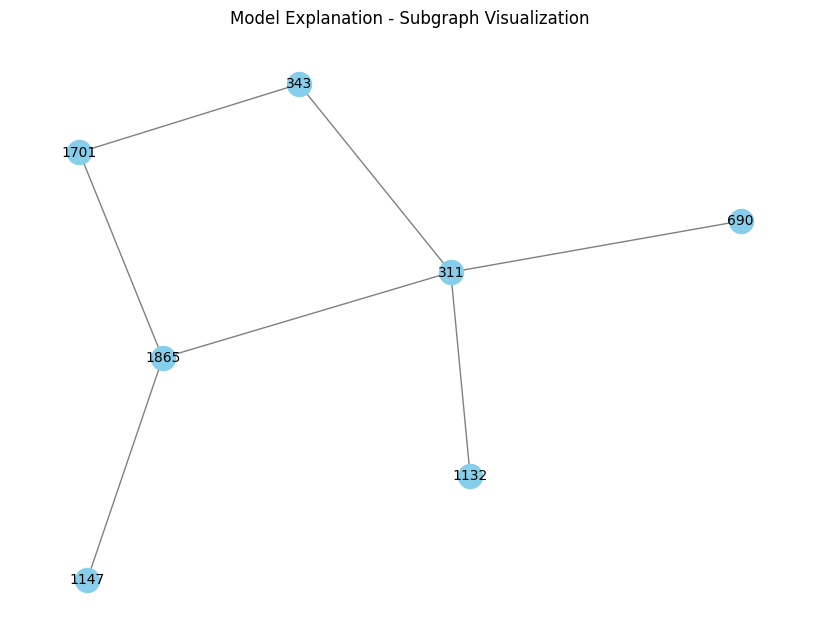

Train Explainer:  98%|█████████▊| 59/60 [02:01<00:01,  1.94s/it]

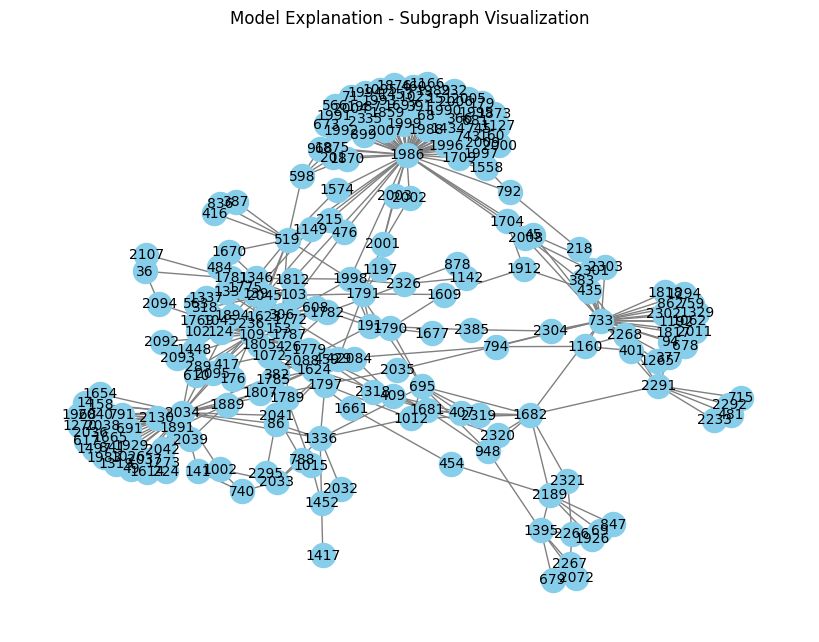

In [38]:
# Phenomenon Explanation Visualization with Subgraph
for node_index in tqdm(node_indices, leave=False, desc='Train Explainer'):
    target = data.y if explanation_type == 'phenomenon' else None
    explanation = explainer(data.x, data.edge_index, index=node_index,
                            target=target)

    _, _, _, hard_edge_mask = k_hop_subgraph(node_index, num_hops=3,
                                             edge_index=data.edge_index)

    # Move data to the same device
    device = data.x.device
    subgraph_nodes = torch.cat([data.edge_index[0, hard_edge_mask].to(device),
                                data.edge_index[1, hard_edge_mask].to(device),
                                torch.tensor([node_index]).to(device)])

    subgraph_edges = data.edge_index[:, hard_edge_mask].to(device)

    # Visualization of Subgraph
    G = nx.Graph()
    G.add_nodes_from(subgraph_nodes.tolist())
    G.add_edges_from(subgraph_edges.t().tolist())

    pos = nx.spring_layout(G, seed=42)  # Fixed layout for consistent visualization
    plt.figure(figsize=(8, 6))
    nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=300,
            edge_color='gray', font_size=10)
    plt.title('Phenomenon Explanation - Subgraph Visualization')
    plt.show()

# Model Explanation Visualization with Subgraph
for node_index in tqdm(node_indices, leave=False, desc='Train Explainer'):
    target = data.y if explanation_type == 'phenomenon' else None
    explanation = explainer(data.x, data.edge_index, index=node_index,
                            target=target)

    _, _, _, hard_edge_mask = k_hop_subgraph(node_index, num_hops=3,
                                             edge_index=data.edge_index)

    # Move data to the same device
    device = data.x.device
    subgraph_nodes = torch.cat([data.edge_index[0, hard_edge_mask].to(device),
                                data.edge_index[1, hard_edge_mask].to(device),
                                torch.tensor([node_index]).to(device)])

    subgraph_edges = data.edge_index[:, hard_edge_mask].to(device)

    # Visualization of Subgraph
    G = nx.Graph()
    G.add_nodes_from(subgraph_nodes.tolist())
    G.add_edges_from(subgraph_edges.t().tolist())

    pos = nx.spring_layout(G, seed=42)  # Fixed layout for consistent visualization
    plt.figure(figsize=(8, 6))
    nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=300,
            edge_color='gray', font_size=10)
    plt.title('Model Explanation - Subgraph Visualization')
    plt.show()

In [ ]:
# GPU 사용 가능 여부 확인
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

# 데이터셋 설정
dataset = 'Cora'
path = '/content/data/Planetoid'  # Google Colab에서 사용할 경로
transform = T.Compose([
    T.NormalizeFeatures(),
    T.ToDevice(device),
    T.RandomLinkSplit(num_val=0.05, num_test=0.1, is_undirected=True),
])
dataset = Planetoid(path, dataset, transform=transform)
train_data, val_data, test_data = dataset[0]

In [41]:
import os.path as osp

import torch
import torch.nn.functional as F
from sklearn.metrics import roc_auc_score

import torch_geometric.transforms as T
from torch_geometric.datasets import Planetoid
from torch_geometric.explain import Explainer, GNNExplainer, ModelConfig
from torch_geometric.nn import GCNConv

if torch.cuda.is_available():
    device = torch.device('cuda')
elif hasattr(torch.backends, 'mps') and torch.backends.mps.is_available():
    device = torch.device('mps')
else:
    device = torch.device('cpu')

# 데이터셋 설정
dataset = 'Cora'
path = '/content/data/Planetoid'  # Google Colab에서 사용할 경로
transform = T.Compose([
    T.NormalizeFeatures(),
    T.ToDevice(device),
    T.RandomLinkSplit(num_val=0.05, num_test=0.1, is_undirected=True),
])
dataset = Planetoid(path, dataset, transform=transform)
train_data, val_data, test_data = dataset[0]


class GCN(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super().__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, out_channels)

    def encode(self, x, edge_index):
        x = self.conv1(x, edge_index).relu()
        x = self.conv2(x, edge_index)
        return x

    def decode(self, z, edge_label_index):
        src, dst = edge_label_index
        return (z[src] * z[dst]).sum(dim=-1)

    def forward(self, x, edge_index, edge_label_index):
        z = model.encode(x, edge_index)
        return model.decode(z, edge_label_index).view(-1)


model = GCN(dataset.num_features, 128, 64).to(device)
optimizer = torch.optim.Adam(params=model.parameters(), lr=0.01)


def train():
    model.train()
    optimizer.zero_grad()

    out = model(train_data.x, train_data.edge_index,
                train_data.edge_label_index)
    loss = F.binary_cross_entropy_with_logits(out, train_data.edge_label)
    loss.backward()
    optimizer.step()
    return float(loss)


@torch.no_grad()
def test(data):
    model.eval()
    out = model(data.x, data.edge_index, data.edge_label_index).sigmoid()
    return roc_auc_score(data.edge_label.cpu().numpy(), out.cpu().numpy())


for epoch in range(1, 201):
    loss = train()
    if epoch % 20 == 0:
        val_auc = test(val_data)
        test_auc = test(test_data)
        print(f'Epoch: {epoch:02d}, Loss: {loss:.4f}, Val: {val_auc:.4f}, '
              f'Test: {test_auc:.4f}')

model_config = ModelConfig(
    mode='binary_classification',
    task_level='edge',
    return_type='raw',
)

# Explain model output for a single edge:
edge_label_index = val_data.edge_label_index[:, 0]

explainer = Explainer(
    model=model,
    explanation_type='model',
    algorithm=GNNExplainer(epochs=200),
    node_mask_type='attributes',
    edge_mask_type='object',
    model_config=model_config,
)
explanation = explainer(
    x=train_data.x,
    edge_index=train_data.edge_index,
    edge_label_index=edge_label_index,
)
print(f'Generated model explanations in {explanation.available_explanations}')

# Explain a selected target (phenomenon) for a single edge:
edge_label_index = val_data.edge_label_index[:, 0]
target = val_data.edge_label[0].unsqueeze(dim=0).long()

explainer = Explainer(
    model=model,
    explanation_type='phenomenon',
    algorithm=GNNExplainer(epochs=200),
    node_mask_type='attributes',
    edge_mask_type='object',
    model_config=model_config,
)
explanation = explainer(
    x=train_data.x,
    edge_index=train_data.edge_index,
    target=target,
    edge_label_index=edge_label_index,
)
available_explanations = explanation.available_explanations
print(f'Generated phenomenon explanations in {available_explanations}')

Epoch: 20, Loss: 0.6087, Val: 0.7420, Test: 0.7593
Epoch: 40, Loss: 0.4448, Val: 0.7991, Test: 0.8237
Epoch: 60, Loss: 0.3471, Val: 0.8073, Test: 0.8168
Epoch: 80, Loss: 0.2583, Val: 0.7929, Test: 0.8059
Epoch: 100, Loss: 0.1813, Val: 0.7753, Test: 0.7798
Epoch: 120, Loss: 0.1215, Val: 0.7640, Test: 0.7658
Epoch: 140, Loss: 0.0773, Val: 0.7494, Test: 0.7526
Epoch: 160, Loss: 0.0410, Val: 0.7395, Test: 0.7513
Epoch: 180, Loss: 0.0189, Val: 0.7366, Test: 0.7459
Epoch: 200, Loss: 0.0083, Val: 0.7372, Test: 0.7430
Generated model explanations in ['node_mask', 'edge_mask']
Generated phenomenon explanations in ['node_mask', 'edge_mask']


In [42]:
import torch
import torch.nn.functional as F

from torch_geometric.datasets import Planetoid
from torch_geometric.explain import Explainer, GNNExplainer
from torch_geometric.nn import GCNConv

# Load dataset
dataset = 'Cora'
dataset = Planetoid(root='/content/data/Planetoid', name=dataset)
data = dataset[0]

class GCN(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = GCNConv(dataset.num_features, 16)
        self.conv2 = GCNConv(16, dataset.num_classes)

    def forward(self, x, edge_index):
        x = F.relu(self.conv1(x, edge_index))
        x = F.dropout(x, training=self.training)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)

# Set up model, data, and optimizer
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = GCN().to(device)
data = data.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01, weight_decay=5e-4)

# Train the model
for epoch in range(1, 201):
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = F.nll_loss(out[data.train_mask], data.y[data.train_mask])
    loss.backward()
    optimizer.step()

# Set up explainer and generate explanations
explainer = Explainer(
    model=model,
    algorithm=GNNExplainer(epochs=200),
    explanation_type='model',
    node_mask_type='attributes',
    edge_mask_type='object',
    model_config=dict(
        mode='multiclass_classification',
        task_level='node',
        return_type='log_probs',
    ),
)
node_index = 10
explanation = explainer(data.x, data.edge_index, index=node_index)
print(f'Generated explanations in {explanation.available_explanations}')

# Visualize and save results
path_feature_importance = 'feature_importance.png'
explanation.visualize_feature_importance(path_feature_importance, top_k=10)
print(f"Feature importance plot has been saved to '{path_feature_importance}'")

path_subgraph = 'subgraph.pdf'
explanation.visualize_graph(path_subgraph)
print(f"Subgraph visualization plot has been saved to '{path_subgraph}'")

Generated explanations in ['node_mask', 'edge_mask']
Feature importance plot has been saved to 'feature_importance.png'
Subgraph visualization plot has been saved to 'subgraph.pdf'
